In [1]:
from keras import applications
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers
from keras.layers import Dropout, Flatten, Dense , ZeroPadding2D
from keras.applications import vgg19
from keras.models import load_model
from keras.optimizers import *
from keras.losses import binary_crossentropy
from keras.layers import concatenate,Conv2DTranspose
from keras.models import Model, Sequential, load_model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Lambda, Dropout, merge, MaxPool2D
import numpy as np
import keras.backend as K
from keras.optimizers import *
from keras.losses import binary_crossentropy
from keras.layers import concatenate,Conv2DTranspose
K.set_image_dim_ordering('tf')
from keras.callbacks import ModelCheckpoint
from keras.regularizers import l2
smooth = 1.
import tensorflow as tf
smooth = 1.
def focal_loss(gamma=2., alpha=.25):
    def focal_loss_fixed(y_true, y_pred):
        pt_1 = tf.where(tf.equal(y_true, 1), y_pred, tf.ones_like(y_pred))
        pt_0 = tf.where(tf.equal(y_true, 0), y_pred, tf.zeros_like(y_pred))
        return -K.sum(alpha * K.pow(1. - pt_1, gamma) * K.log(pt_1))-K.sum((1-alpha) * K.pow( pt_0, gamma) * K.log(1. - pt_0))
    return focal_loss_fixed
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.to_int32(y_pred > t)
        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=3)
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def bce_dice(y_true, y_pred):
    return binary_crossentropy(y_true, y_pred)-K.log(dice_coef(y_true, y_pred))
def sensitivity(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())

def specificity(y_true, y_pred):
    true_negatives = K.sum(K.round(K.clip((1-y_true) * (1-y_pred), 0, 1)))
    possible_negatives = K.sum(K.round(K.clip(1-y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())

def jacard_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) - intersection + 1.0)


def jacard_coef_loss(y_true, y_pred):
    return -jacard_coef(y_true, y_pred)


def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

/home/ubuntu/.local/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [14]:
def VGGFinetuned():
    model = applications.VGG19(include_top=False,input_shape=(256,324,3))
    model.load_weights('/home/ubuntu/.keras/models/vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5')
    x = model.get_layer('block5_conv4').output

    x = Conv2D(256,(5,5),name = 'pred_32s',kernel_initializer='he_normal',padding='same',activation='relu')(x)
    x = Conv2D(256,(5,5),name = 'pred_32s1',kernel_initializer='he_normal',padding='same',activation='relu')(x)
    x = Conv2DTranspose(128, (4, 4), strides=(4, 4), padding='same',kernel_initializer='he_normal',activation='relu')(x)
    x = Conv2D(filters=128,activation='relu',kernel_size=(3,3),padding='same',kernel_regularizer=l2(1e-4))(x)

    x = Conv2D(filters=128,activation='relu',kernel_size=(3,3),padding='same',kernel_regularizer=l2(1e-4))(x)

    x = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same',kernel_initializer='he_normal',activation='relu')(x)
    x = Conv2D(filters=64,activation='relu',kernel_size=(3,3),padding='same',kernel_regularizer=l2(1e-4))(x)

    x = Conv2D(filters=64,activation='relu',kernel_size=(3,3),padding='same',kernel_regularizer=l2(1e-4))(x)
    x = ZeroPadding2D(padding=(0,1))(x)
    x = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same',kernel_initializer='he_normal',activation='relu')(x)
    x = Conv2D(filters=32,activation='relu',kernel_size=(3,3),padding='same',kernel_regularizer=l2(1e-4))(x)

    x = Conv2D(filters=32,activation='relu',kernel_size=(1,1),padding='same',kernel_regularizer=l2(1e-4))(x)
    x = Conv2D(filters=1,activation='sigmoid',kernel_size=(1,1),padding='same',kernel_regularizer=l2(1e-4))(x)

    model1 = Model(inputs=model.input,outputs=x)
    return model1

In [15]:
model1 = VGGFinetuned()
'''for layers in model.layers:
    layers.trainable=False'''

'for layers in model.layers:\n    layers.trainable=False'

In [16]:
listTrainable = ["block1_conv1","block1_conv2","block2_conv1","block2_conv2","block3_conv1","block3_conv2","block3_conv3"]

In [17]:

loss = focal_loss()
print(model1.summary())

model1.compile(optimizer=Adam(lr=1e-8,decay=1e-9), loss=bce_dice, metrics=[dice_coef,jacard_coef])
checkpoint = ModelCheckpoint(filepath='/home/ubuntu/DeepMobile/models/myown/VGGNEWNEW4.h5',mode='max',
                           monitor='val_jacard_coef',verbose=1,save_best_only=True)
model1.load_weights('/home/ubuntu/DeepMobile/models/production_models/VGG_MUE_Production.h5')
# we create two instances with the same arguments
'''data_gen_args = dict(channel_shift_range=0.1,
                     rotation_range=90.,
                     width_shift_range=0.1,
                     height_shift_range=0.1,
                     zoom_range=0.2)
image_datagen = ImageDataGenerator(rescale=1/255.,**data_gen_args)
mask_datagen = ImageDataGenerator(rescale=1/255.,**data_gen_args)
mask_datagen1 = ImageDataGenerator(**data_gen_args)

# Provide the same seed and keyword arguments to the fit and flow methods
seed = 30

image_generator = image_datagen.flow_from_directory(
    '/home/ubuntu/DeepMobile/data/colour_data/train_data/',target_size=(256, 324),
    class_mode=None, batch_size=1,color_mode='rgb',
    seed=seed)

mask_generator = mask_datagen.flow_from_directory(
    '/home/ubuntu/DeepMobile/data/colour_data/label_data/',
    class_mode=None,batch_size=1,target_size=(256, 324),color_mode='grayscale',
    seed=seed)
image_generator1 = image_datagen.flow_from_directory(
    '/home/ubuntu/DeepMobile/data/NewData4/JPEGImages/',target_size=(256, 324),
    class_mode=None, batch_size=1,
    seed=seed)

mask_generator1 = mask_datagen1.flow_from_directory(
    '/home/ubuntu/DeepMobile/data/NewData4/SegmentationClass/',
    class_mode=None,batch_size=1,target_size=(256, 324),color_mode='grayscale',
    seed=seed)

# combine generators into one which yields image and masks
train_generator = zip(image_generator, mask_generator)
valid_generator = zip(image_generator1, mask_generator1)
model1.fit_generator(
    train_generator,validation_data=valid_generator,validation_steps=50,
    steps_per_epoch=500,callbacks=[checkpoint],
    epochs=100)'''

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 256, 324, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 256, 324, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 324, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 162, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 162, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 128, 162, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 64, 81, 128)       0         
__________

"data_gen_args = dict(channel_shift_range=0.1,\n                     rotation_range=90.,\n                     width_shift_range=0.1,\n                     height_shift_range=0.1,\n                     zoom_range=0.2)\nimage_datagen = ImageDataGenerator(rescale=1/255.,**data_gen_args)\nmask_datagen = ImageDataGenerator(rescale=1/255.,**data_gen_args)\nmask_datagen1 = ImageDataGenerator(**data_gen_args)\n\n# Provide the same seed and keyword arguments to the fit and flow methods\nseed = 30\n\nimage_generator = image_datagen.flow_from_directory(\n    '/home/ubuntu/DeepMobile/data/colour_data/train_data/',target_size=(256, 324),\n    class_mode=None, batch_size=1,color_mode='rgb',\n    seed=seed)\n\nmask_generator = mask_datagen.flow_from_directory(\n    '/home/ubuntu/DeepMobile/data/colour_data/label_data/',\n    class_mode=None,batch_size=1,target_size=(256, 324),color_mode='grayscale',\n    seed=seed)\nimage_generator1 = image_datagen.flow_from_directory(\n    '/home/ubuntu/DeepMobile/

(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


/home/ubuntu/.local/lib/python3.5/site-packages/skimage/io/_plugins/matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and
/home/ubuntu/.local/lib/python3.5/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


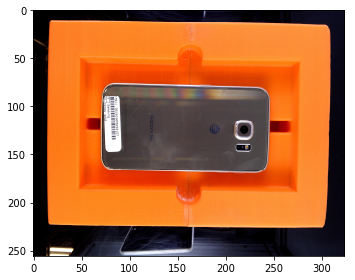

(1, 256, 324, 1)


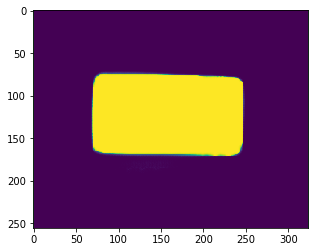

(16182, 3)


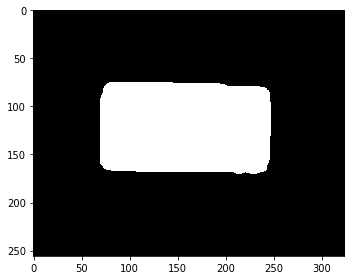

boxShape [[3136 2076]
 [ 873 2033]
 [ 895  889]
 [3158  931]]
box_shape: [[3136 2076]
 [ 873 2033]
 [ 895  889]
 [3158  931]]
(1187, 2285, 3)


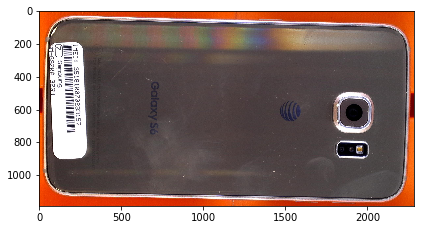

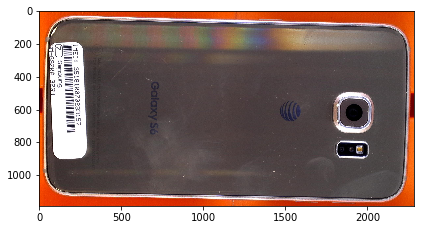

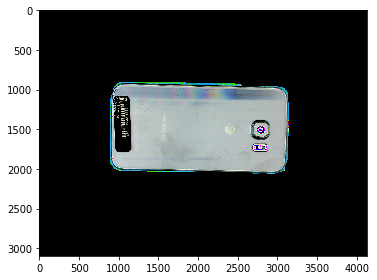

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


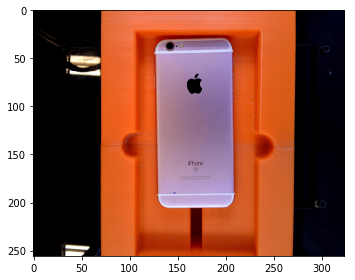

(1, 256, 324, 1)


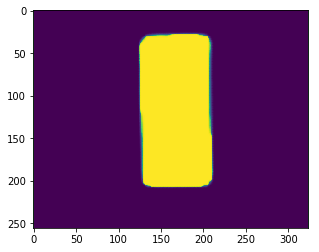

(14295, 3)


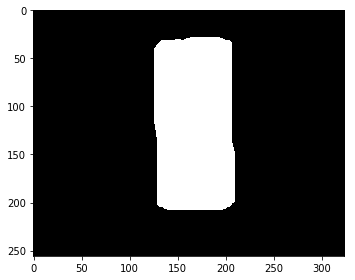

boxShape [[1635 2539]
 [1575  351]
 [2634  322]
 [2695 2509]]
box_shape: [[1635 2539]
 [1575  351]
 [2634  322]
 [2695 2509]]
(2217, 1120, 3)


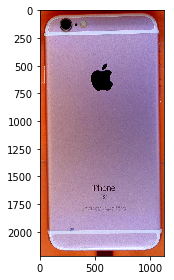

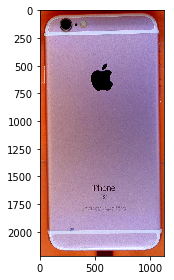

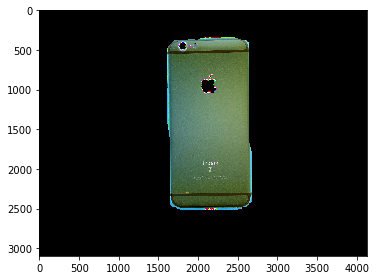

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


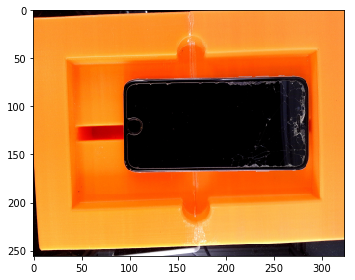

(1, 256, 324, 1)


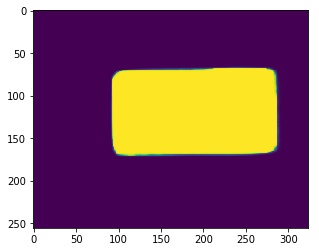

(18919, 3)


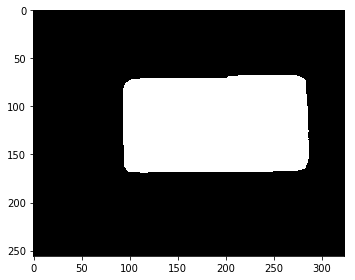

boxShape [[1186 2057]
 [1177  833]
 [3650  815]
 [3659 2039]]
box_shape: [[1186 2057]
 [1177  833]
 [3650  815]
 [3659 2039]]
(1242, 2482, 3)


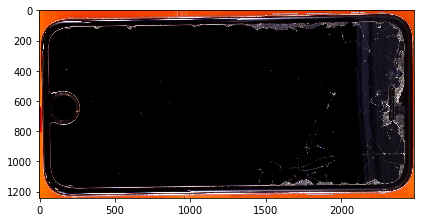

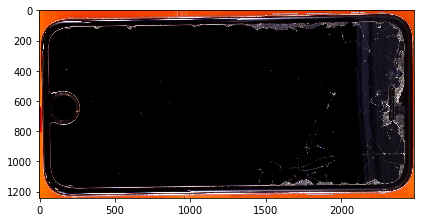

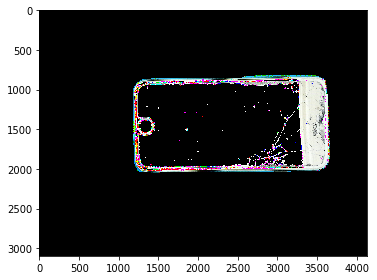

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


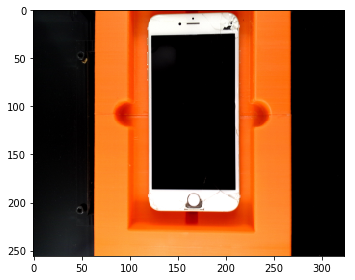

(1, 256, 324, 1)


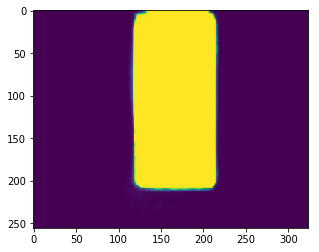

(19995, 3)


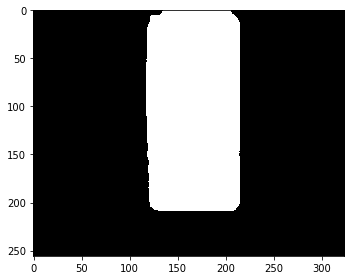

boxShape [[1489 2526]
 [1489    0]
 [2738    0]
 [2738 2526]]
box_shape: [[1489 2526]
 [1489    0]
 [2738    0]
 [2738 2526]]
(2526, 1249, 3)


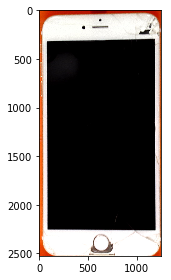

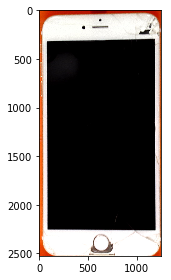

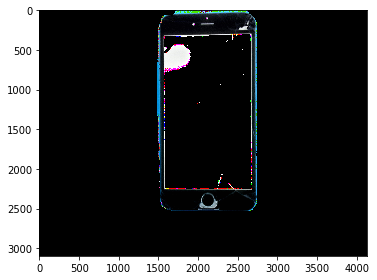

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


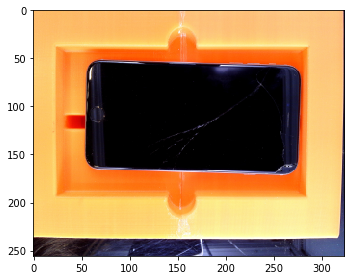

(1, 256, 324, 1)


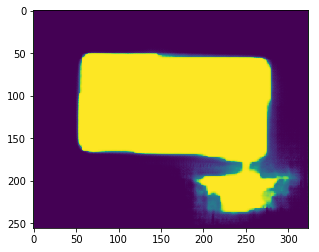

(28549, 3)


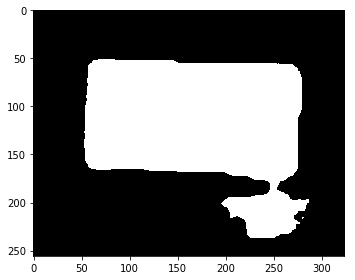

boxShape [[3643 2886]
 [ 640 2806]
 [ 699  597]
 [3702  677]]
box_shape: [[3643 2886]
 [ 640 2806]
 [ 699  597]
 [3702  677]]
(2289, 3062, 3)


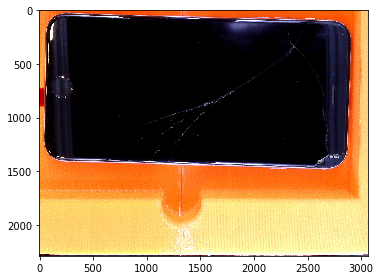

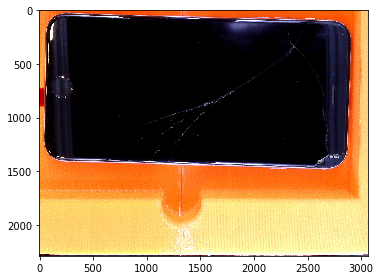

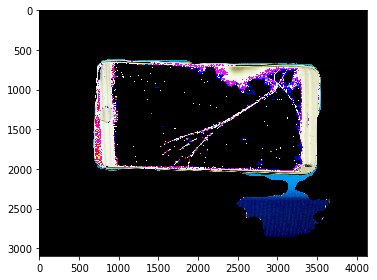

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


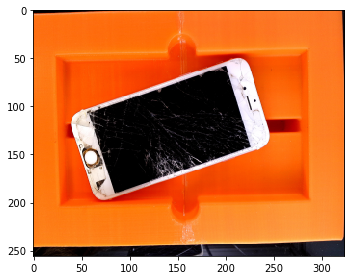

(1, 256, 324, 1)


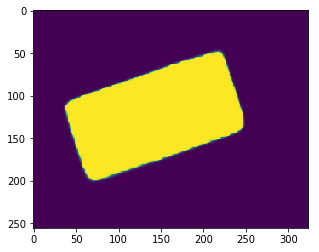

(19271, 3)


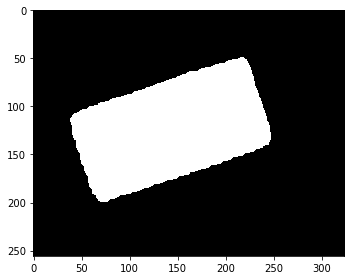

boxShape [[ 818 2488]
 [ 431 1309]
 [2830  522]
 [3216 1701]]
box_shape: [[ 818 2488]
 [ 431 1309]
 [2830  522]
 [3216 1701]]
(1966, 2785, 3)


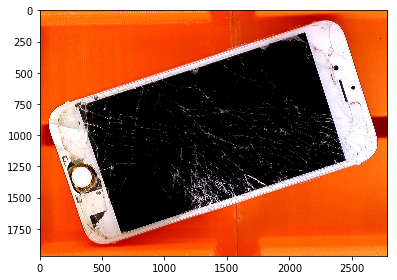

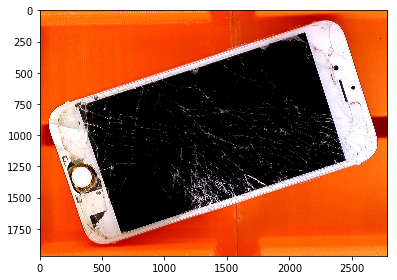

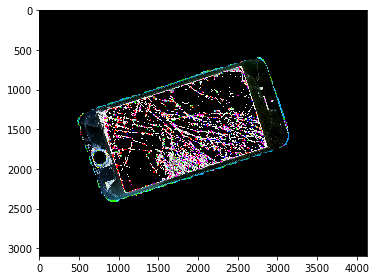

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


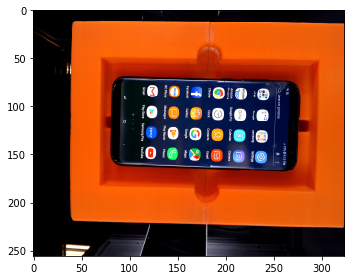

(1, 256, 324, 1)


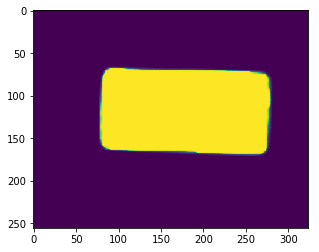

(18490, 3)


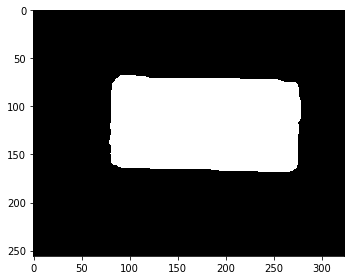

boxShape [[3523 2058]
 [ 996 1993]
 [1026  813]
 [3553  878]]
box_shape: [[3523 2058]
 [ 996 1993]
 [1026  813]
 [3553  878]]
(1245, 2557, 3)


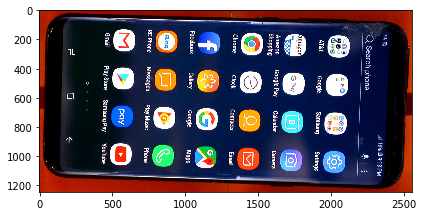

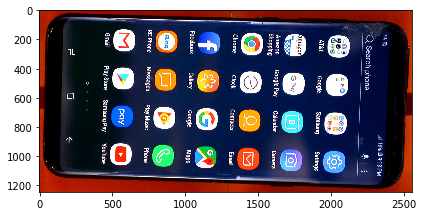

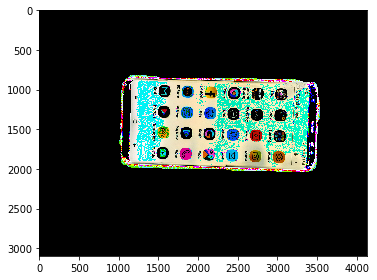

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.015686275
(1, 256, 324, 3)


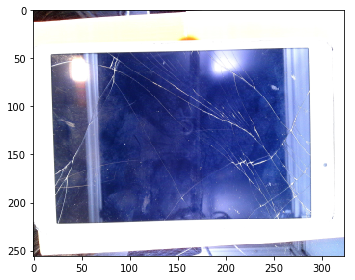

(1, 256, 324, 1)


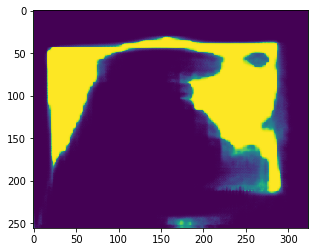

(15906, 3)


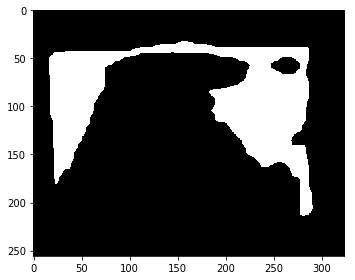

boxShape [[3702 2595]
 [ 120 2406]
 [ 231  291]
 [3813  480]]
box_shape: [[3702 2595]
 [ 120 2406]
 [ 231  291]
 [3813  480]]
(2304, 3693, 3)


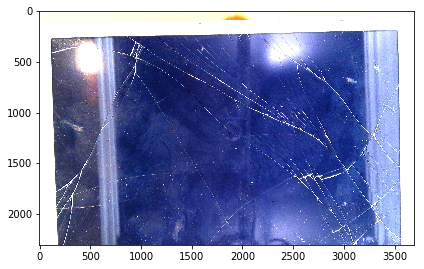

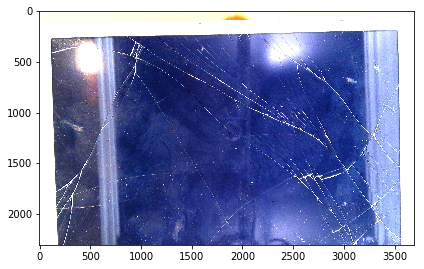

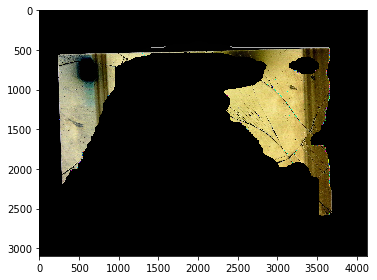

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


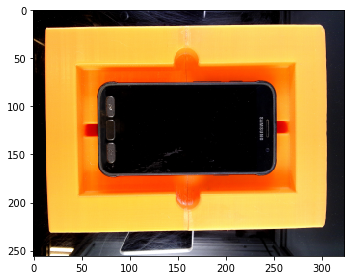

(1, 256, 324, 1)


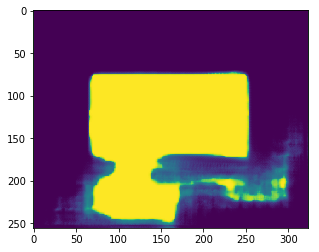

(23605, 3)


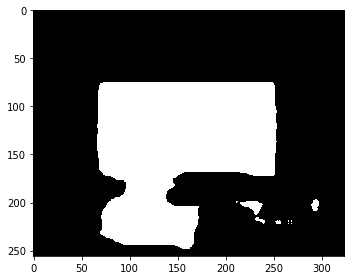

boxShape [[ 840 3011]
 [ 840  907]
 [3223  907]
 [3223 3011]]
box_shape: [[ 840 3011]
 [ 840  907]
 [3223  907]
 [3223 3011]]
(2104, 2383, 3)


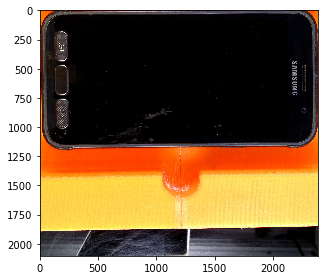

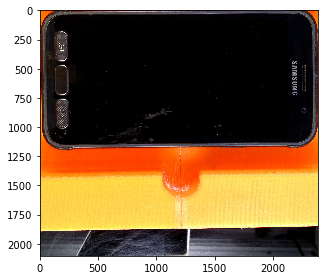

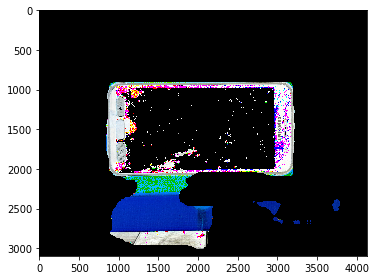

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


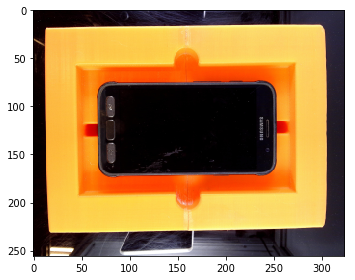

(1, 256, 324, 1)


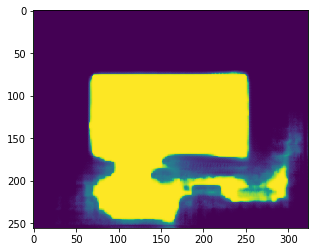

(25035, 3)


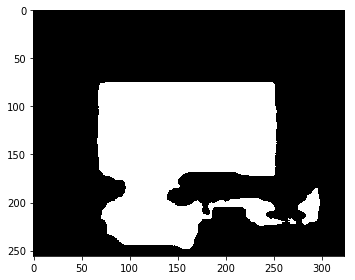

boxShape [[ 840 3011]
 [ 840  907]
 [3338  907]
 [3338 3011]]
box_shape: [[ 840 3011]
 [ 840  907]
 [3338  907]
 [3338 3011]]
(2104, 2498, 3)


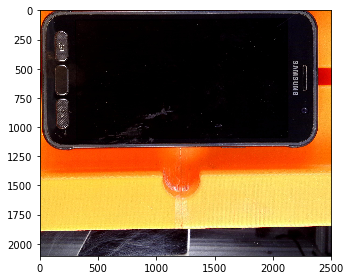

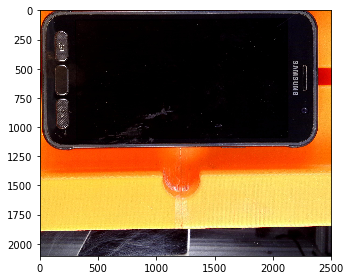

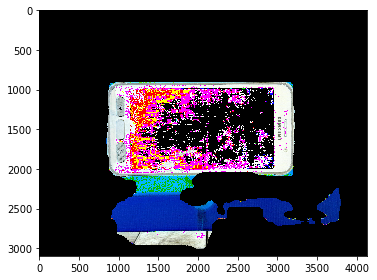

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
0.99607843 0.0
(1, 256, 324, 3)


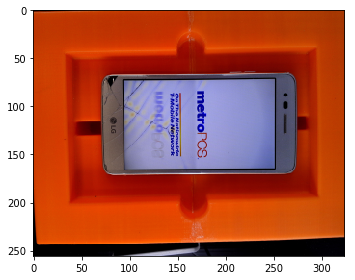

(1, 256, 324, 1)


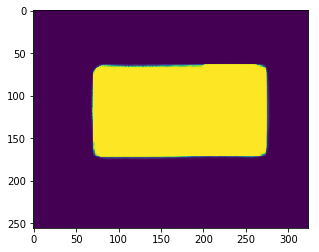

(21654, 3)


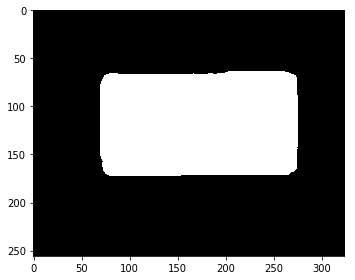

boxShape [[ 893 2100]
 [ 882  788]
 [3500  766]
 [3511 2078]]
box_shape: [[ 893 2100]
 [ 882  788]
 [3500  766]
 [3511 2078]]
(1334, 2629, 3)


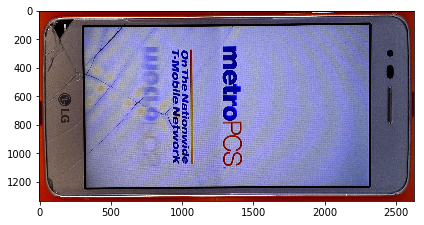

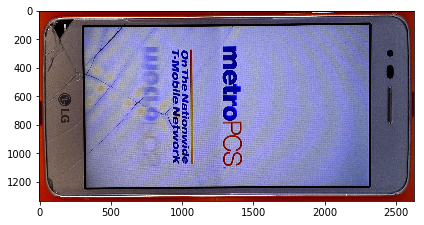

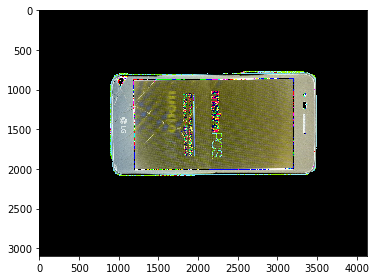

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


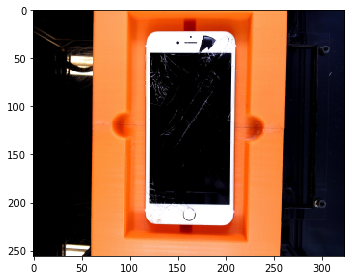

(1, 256, 324, 1)


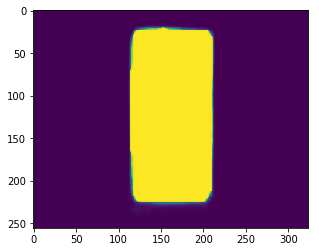

(19034, 3)


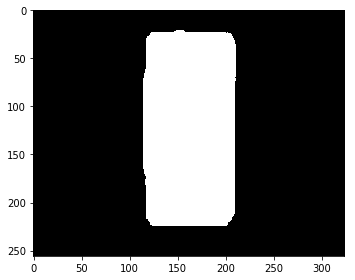

boxShape [[1451 2720]
 [1451  253]
 [2687  253]
 [2687 2720]]
box_shape: [[1451 2720]
 [1451  253]
 [2687  253]
 [2687 2720]]
(2467, 1236, 3)


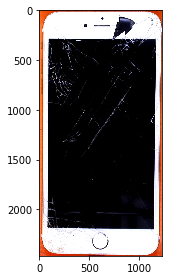

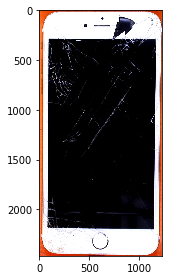

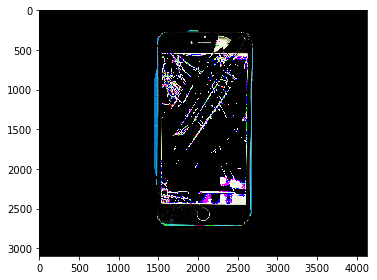

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.019607844
(1, 256, 324, 3)


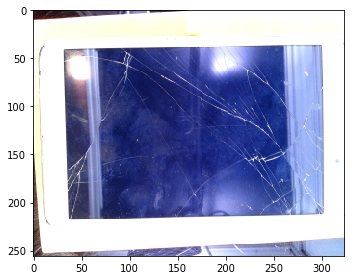

(1, 256, 324, 1)


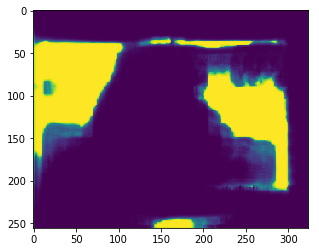

(15303, 3)


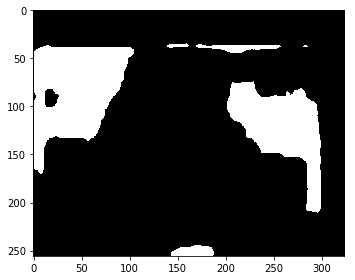

boxShape [[  12 2067]
 [  12  435]
 [1336  435]
 [1336 2067]]
box_shape: [[  12 2067]
 [  12  435]
 [1336  435]
 [1336 2067]]
(1632, 1324, 3)


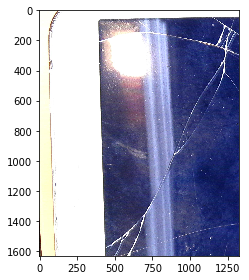

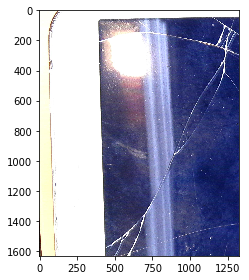

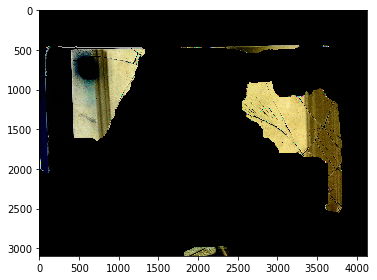

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


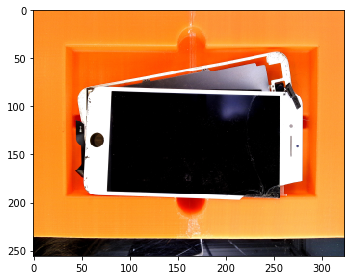

(1, 256, 324, 1)


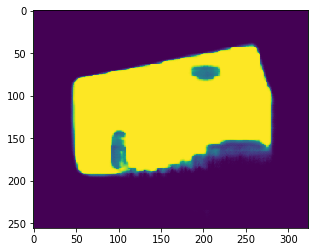

(24853, 3)


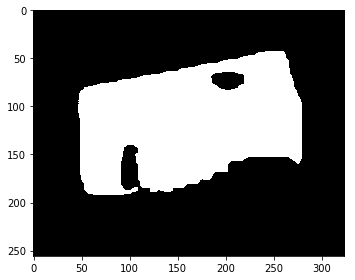

boxShape [[ 700 2492]
 [ 424 1005]
 [3422  450]
 [3697 1937]]
box_shape: [[ 700 2492]
 [ 424 1005]
 [3422  450]
 [3697 1937]]
(2042, 3273, 3)


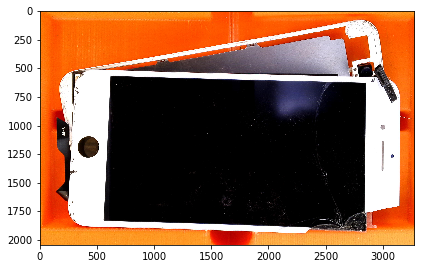

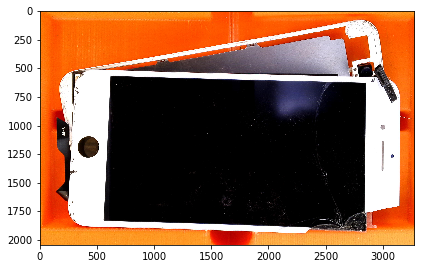

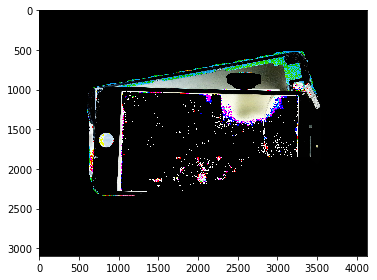

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


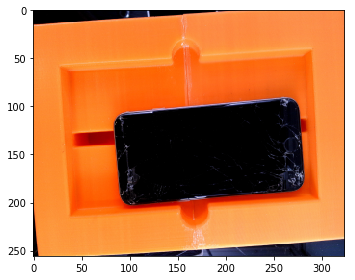

(1, 256, 324, 1)


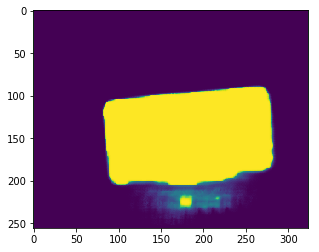

(19626, 3)


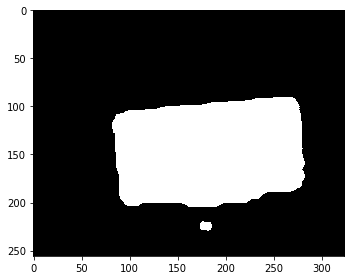

boxShape [[1131 2584]
 [1025 1267]
 [3526 1064]
 [3633 2381]]
box_shape: [[1131 2584]
 [1025 1267]
 [3526 1064]
 [3633 2381]]
(1520, 2608, 3)


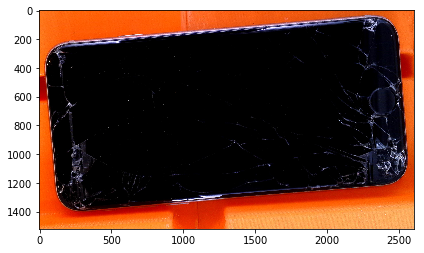

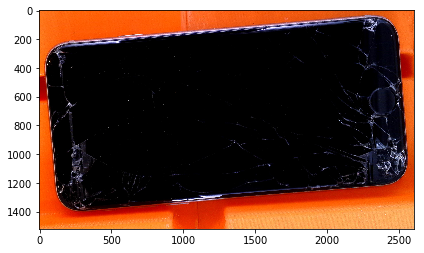

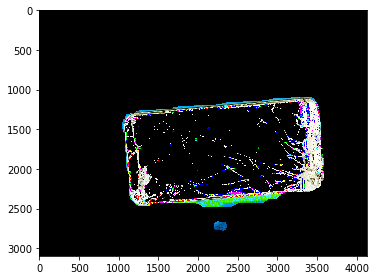

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


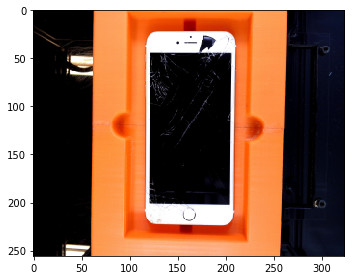

(1, 256, 324, 1)


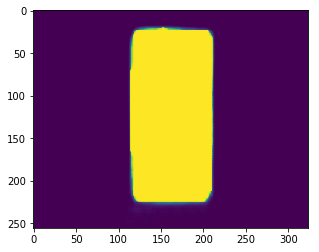

(19033, 3)


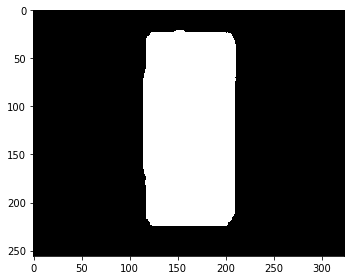

boxShape [[1451 2720]
 [1451  253]
 [2687  253]
 [2687 2720]]
box_shape: [[1451 2720]
 [1451  253]
 [2687  253]
 [2687 2720]]
(2467, 1236, 3)


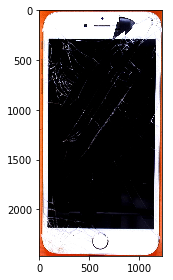

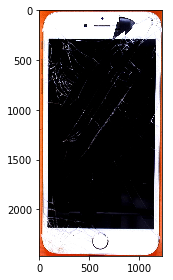

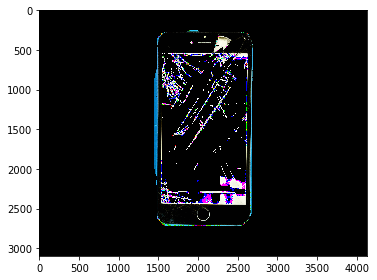

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


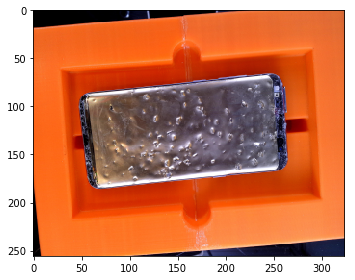

(1, 256, 324, 1)


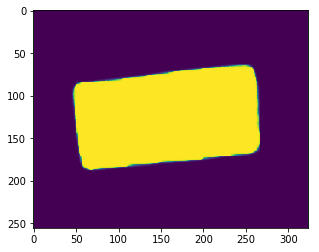

(21787, 3)


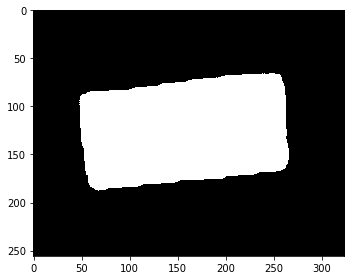

boxShape [[ 709 2322]
 [ 569 1034]
 [3314  737]
 [3454 2025]]
box_shape: [[ 709 2322]
 [ 569 1034]
 [3314  737]
 [3454 2025]]
(1585, 2885, 3)


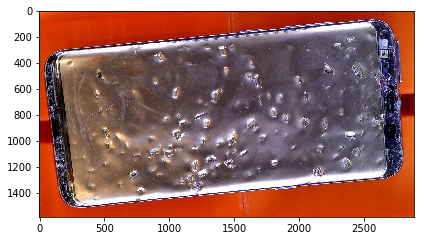

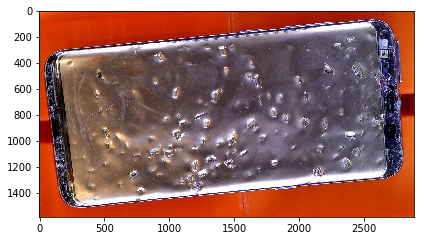

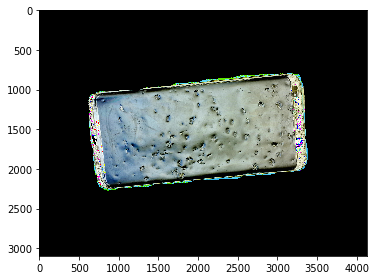

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


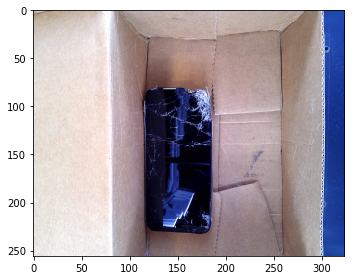

(1, 256, 324, 1)


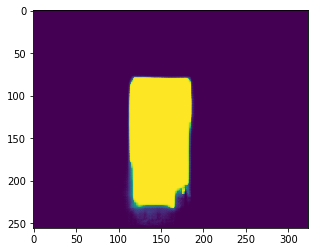

(9962, 3)


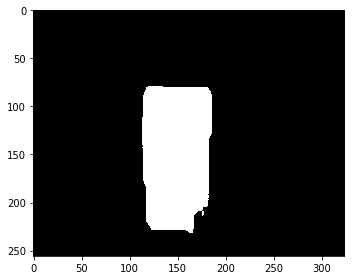

boxShape [[1439 2805]
 [1439  955]
 [2369  955]
 [2369 2805]]
box_shape: [[1439 2805]
 [1439  955]
 [2369  955]
 [2369 2805]]
(1850, 930, 3)


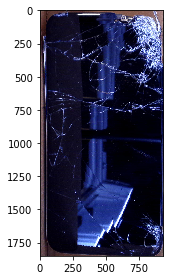

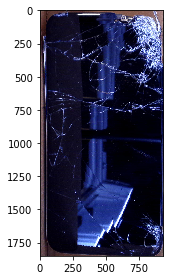

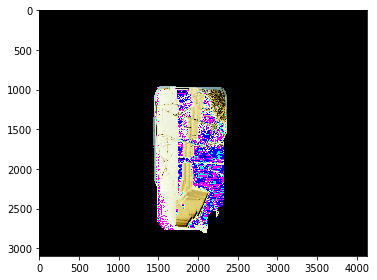

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


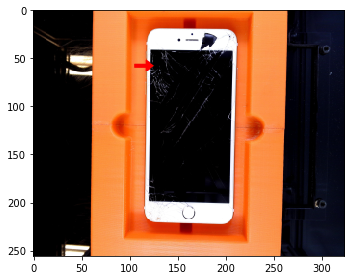

(1, 256, 324, 1)


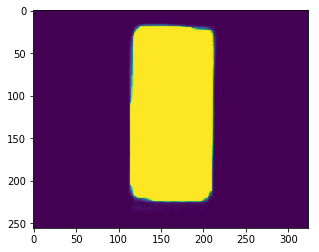

(19179, 3)


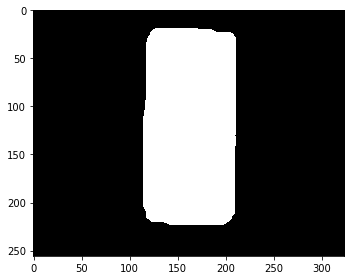

boxShape [[1452 2708]
 [1452  229]
 [2688  229]
 [2688 2708]]
box_shape: [[1452 2708]
 [1452  229]
 [2688  229]
 [2688 2708]]
(2479, 1236, 3)


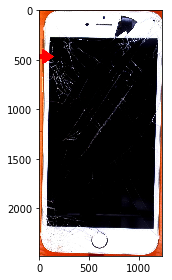

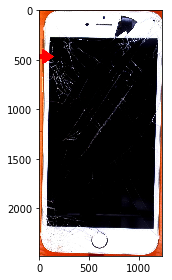

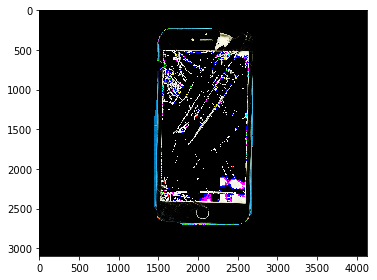

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


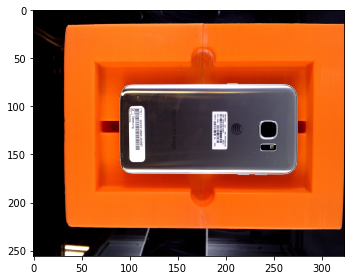

(1, 256, 324, 1)


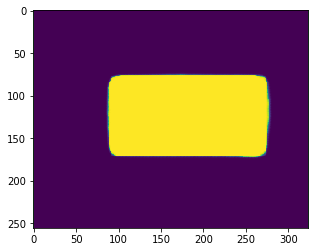

(17702, 3)


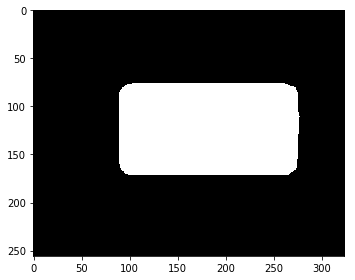

boxShape [[1133 2080]
 [1133  919]
 [3529  919]
 [3529 2080]]
box_shape: [[1133 2080]
 [1133  919]
 [3529  919]
 [3529 2080]]
(1161, 2396, 3)


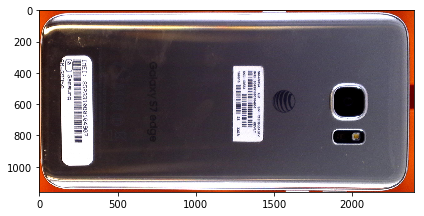

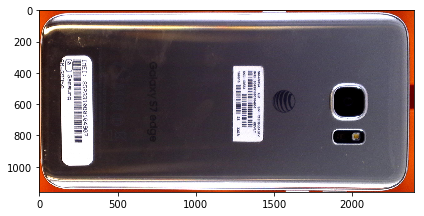

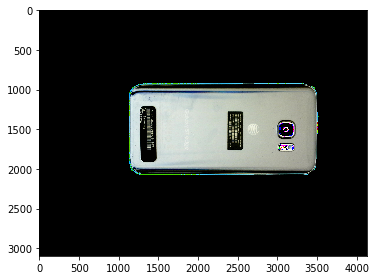

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


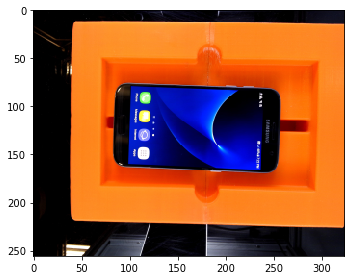

(1, 256, 324, 1)


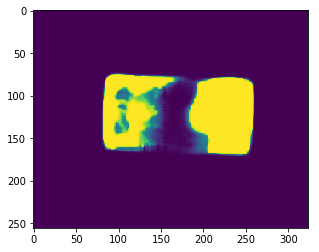

(9258, 3)


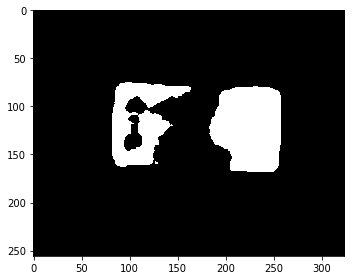

boxShape [[2330 2042]
 [2330  955]
 [3286  955]
 [3286 2042]]
box_shape: [[2330 2042]
 [2330  955]
 [3286  955]
 [3286 2042]]
(1087, 956, 3)


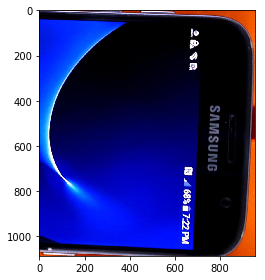

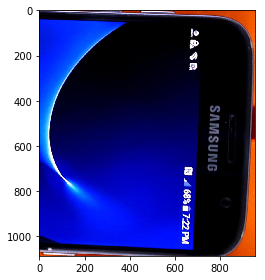

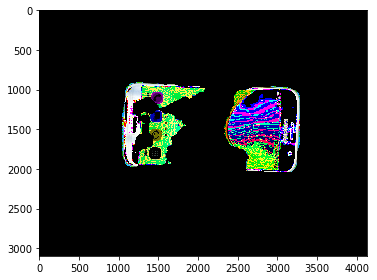

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


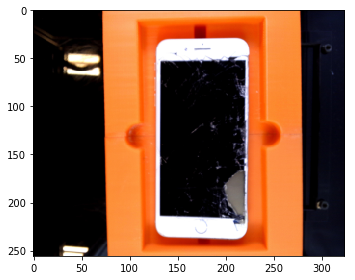

(1, 256, 324, 1)


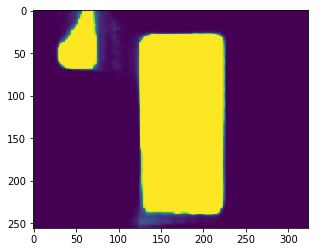

(22349, 3)


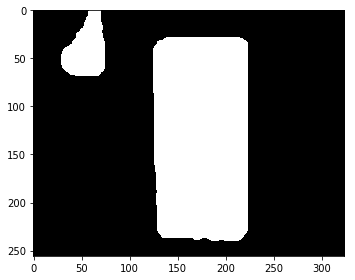

boxShape [[1592 2901]
 [1592  338]
 [2841  338]
 [2841 2901]]
box_shape: [[1592 2901]
 [1592  338]
 [2841  338]
 [2841 2901]]
(2563, 1249, 3)


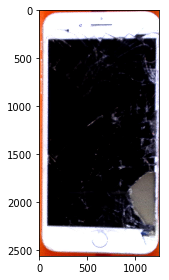

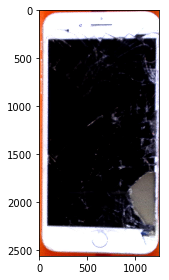

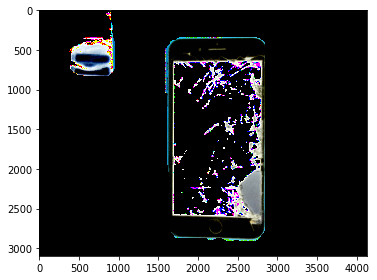

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


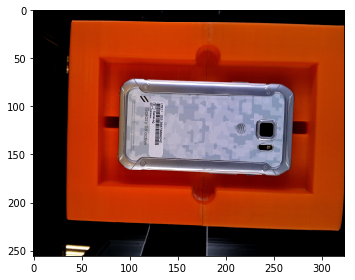

(1, 256, 324, 1)


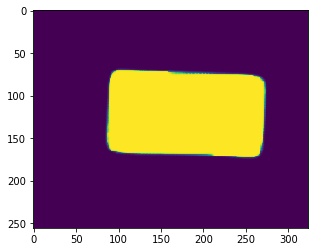

(17201, 3)


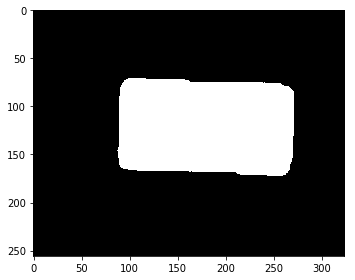

boxShape [[3433 2104]
 [1098 2022]
 [1140  839]
 [3475  921]]
box_shape: [[3433 2104]
 [1098 2022]
 [1140  839]
 [3475  921]]
(1265, 2377, 3)


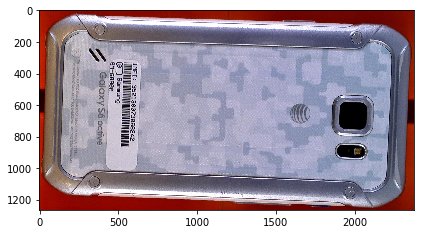

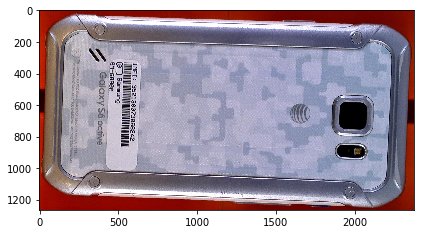

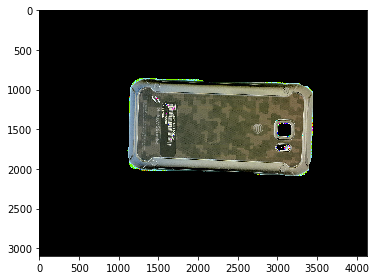

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


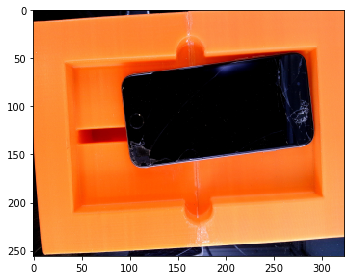

(1, 256, 324, 1)


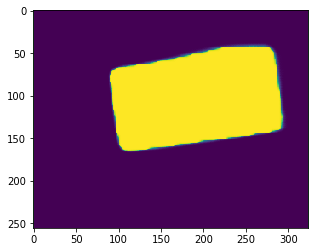

(19580, 3)


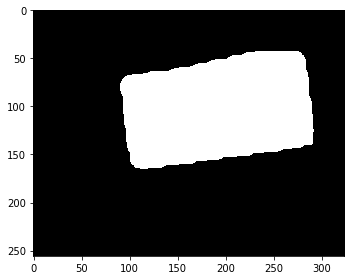

boxShape [[1277 2041]
 [1112  749]
 [3602  431]
 [3768 1722]]
box_shape: [[1277 2041]
 [1112  749]
 [3602  431]
 [3768 1722]]
(1610, 2656, 3)


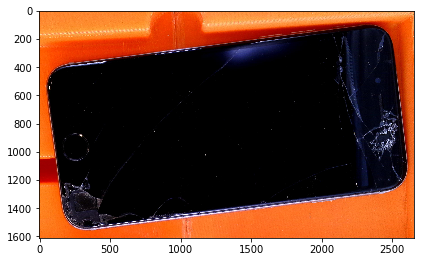

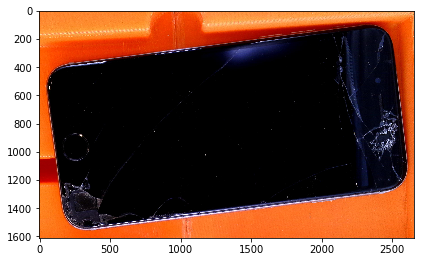

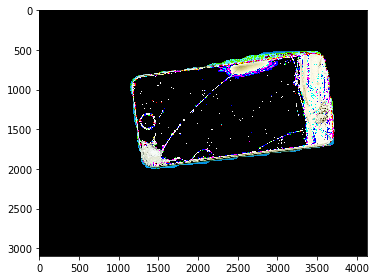

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


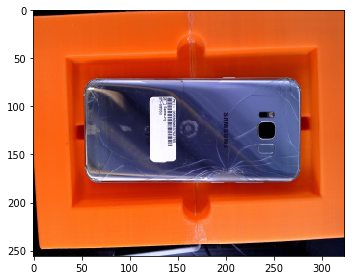

(1, 256, 324, 1)


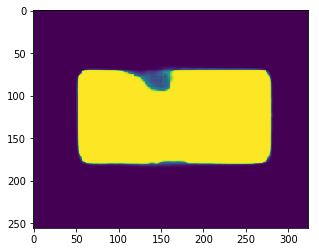

(23485, 3)


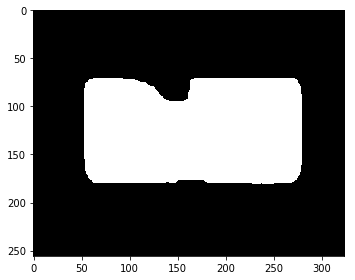

boxShape [[ 675 2187]
 [ 675  858]
 [3553  858]
 [3553 2187]]
box_shape: [[ 675 2187]
 [ 675  858]
 [3553  858]
 [3553 2187]]
(1329, 2878, 3)


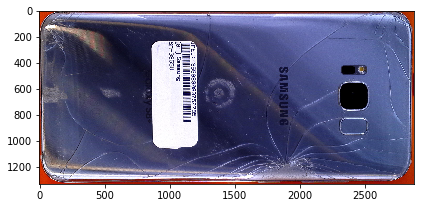

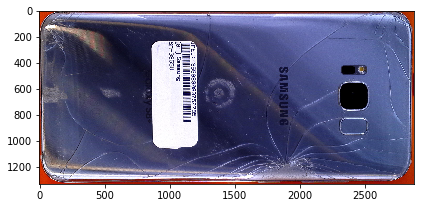

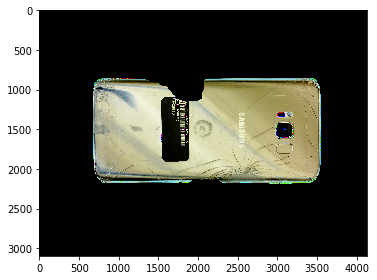

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


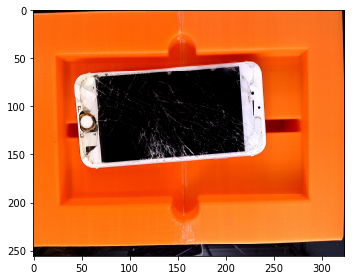

(1, 256, 324, 1)


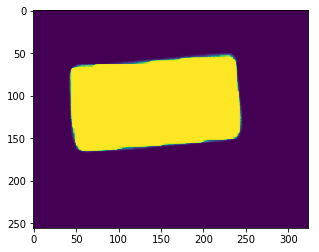

(19166, 3)


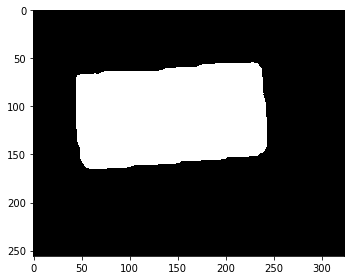

boxShape [[ 613 2030]
 [ 520  805]
 [3041  615]
 [3134 1840]]
box_shape: [[ 613 2030]
 [ 520  805]
 [3041  615]
 [3134 1840]]
(1415, 2614, 3)


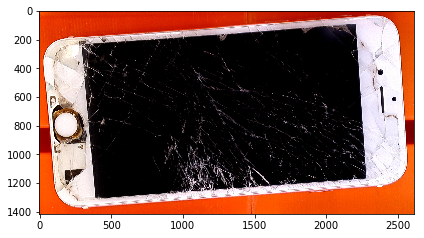

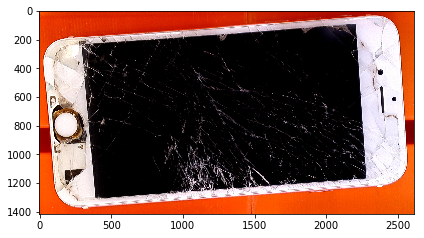

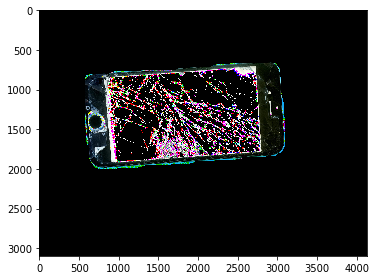

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


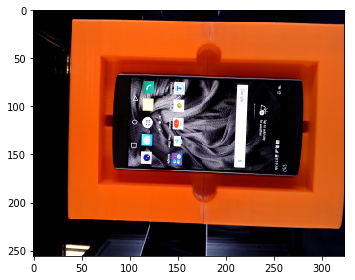

(1, 256, 324, 1)


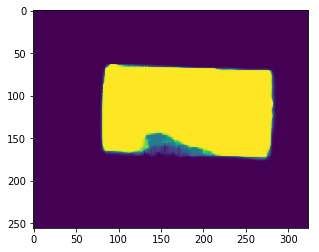

(18619, 3)


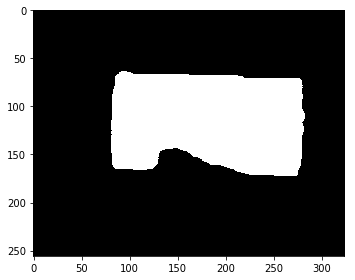

boxShape [[3561 2108]
 [1005 2005]
 [1056  754]
 [3612  858]]
box_shape: [[3561 2108]
 [1005 2005]
 [1056  754]
 [3612  858]]
(1354, 2607, 3)


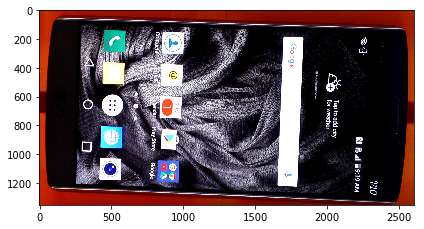

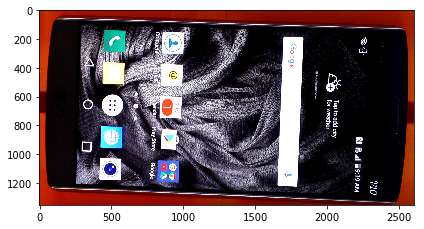

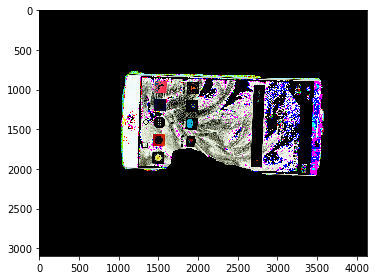

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


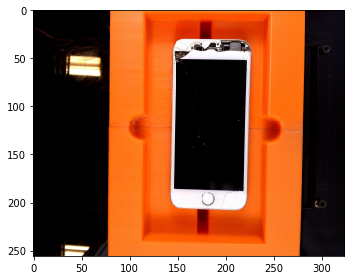

(1, 256, 324, 1)


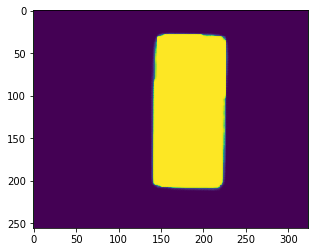

(14689, 3)


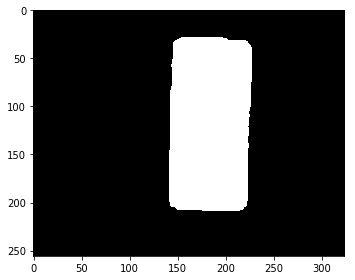

boxShape [[2836 2547]
 [1757 2510]
 [1832  314]
 [2910  351]]
box_shape: [[2836 2547]
 [1757 2510]
 [1832  314]
 [2910  351]]
(2233, 1153, 3)


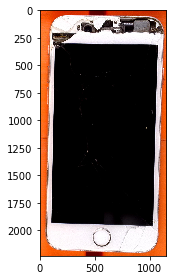

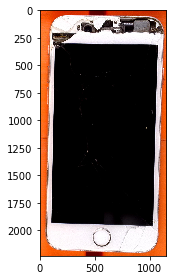

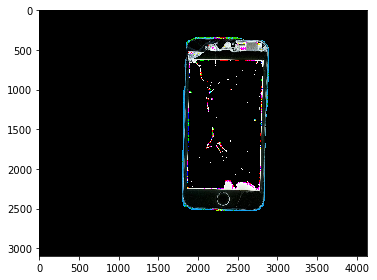

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


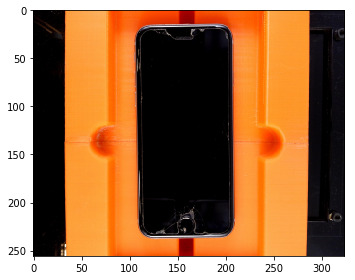

(1, 256, 324, 1)


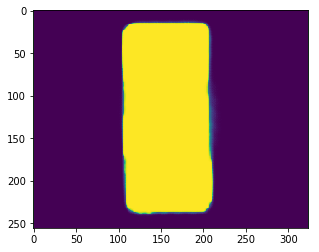

(22192, 3)


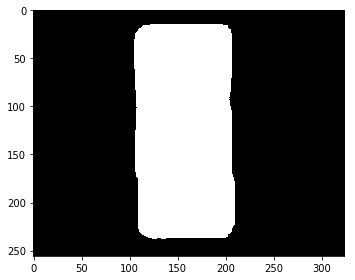

boxShape [[1362 2884]
 [1321  184]
 [2644  164]
 [2685 2863]]
box_shape: [[1362 2884]
 [1321  184]
 [2644  164]
 [2685 2863]]
(2720, 1364, 3)


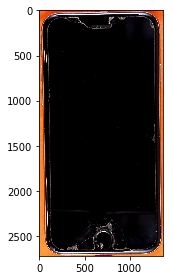

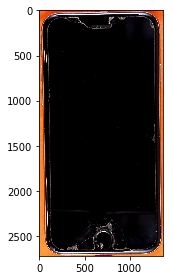

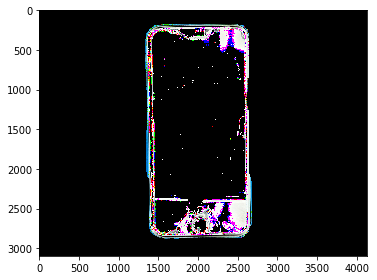

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


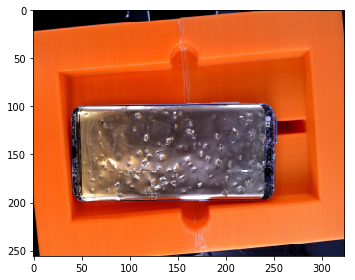

(1, 256, 324, 1)


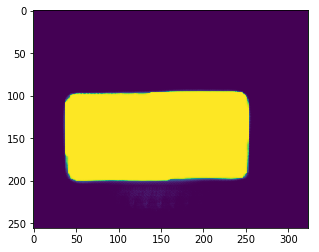

(21658, 3)


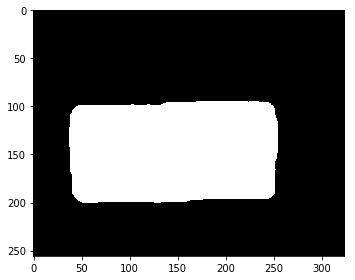

boxShape [[ 494 2467]
 [ 454 1201]
 [3227 1114]
 [3267 2380]]
box_shape: [[ 494 2467]
 [ 454 1201]
 [3227 1114]
 [3267 2380]]
(1353, 2813, 3)


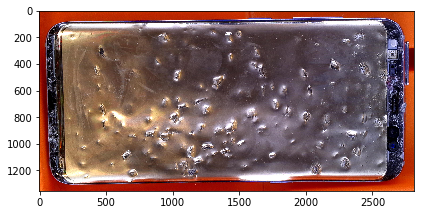

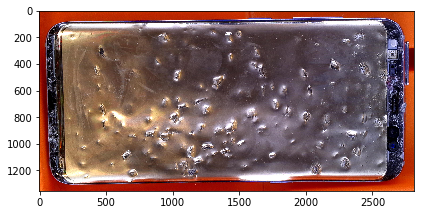

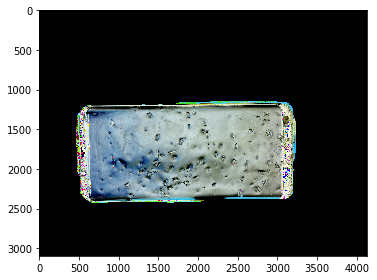

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


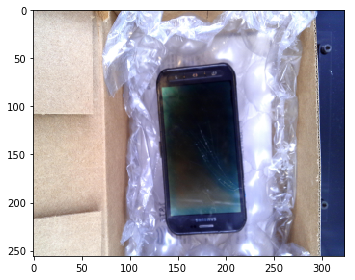

(1, 256, 324, 1)


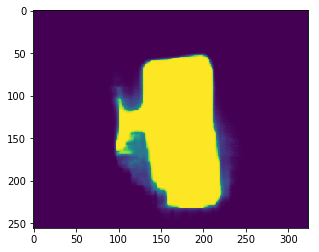

(14561, 3)


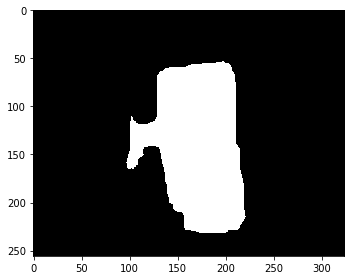

boxShape [[1313 2904]
 [1140  749]
 [2665  626]
 [2838 2781]]
box_shape: [[1313 2904]
 [1140  749]
 [2665  626]
 [2838 2781]]
(2278, 1698, 3)


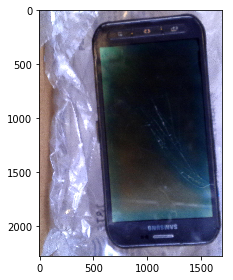

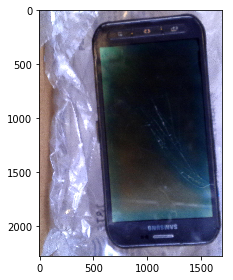

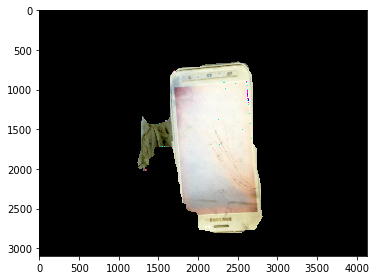

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.007843138
(1, 256, 324, 3)


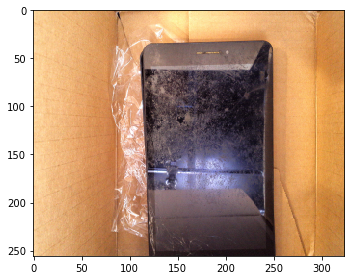

(1, 256, 324, 1)


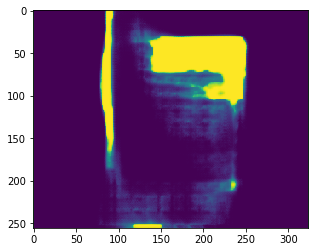

(7144, 3)


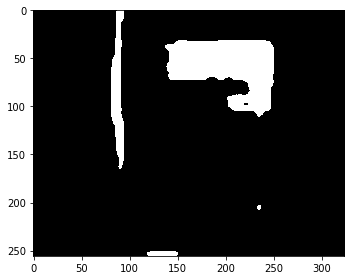

boxShape [[1745 1342]
 [1745  374]
 [3185  374]
 [3185 1342]]
box_shape: [[1745 1342]
 [1745  374]
 [3185  374]
 [3185 1342]]
(968, 1440, 3)


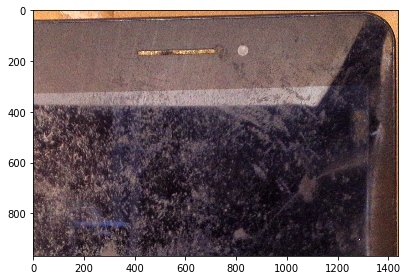

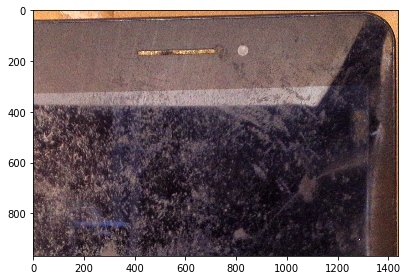

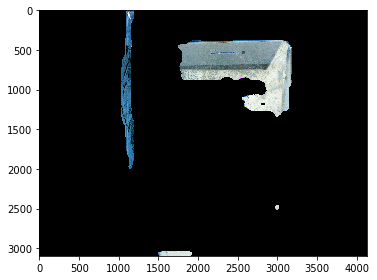

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


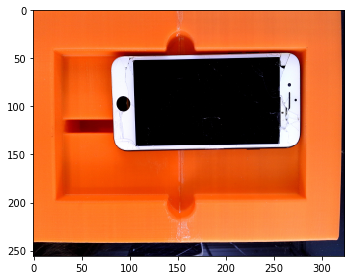

(1, 256, 324, 1)


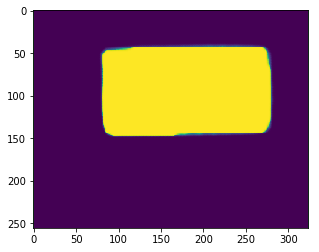

(19936, 3)


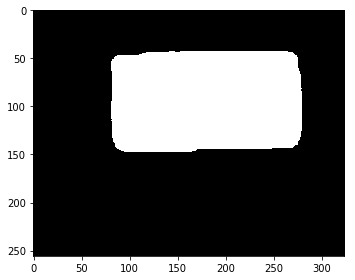

boxShape [[1031 1788]
 [1031  519]
 [3553  519]
 [3553 1788]]
box_shape: [[1031 1788]
 [1031  519]
 [3553  519]
 [3553 1788]]
(1269, 2522, 3)


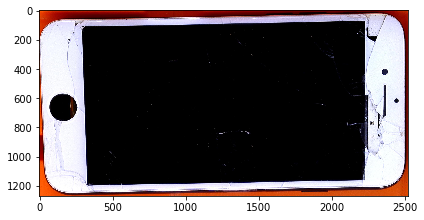

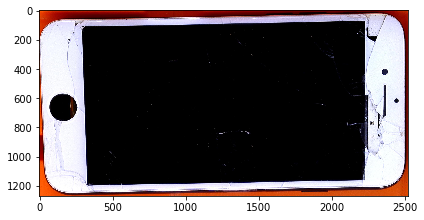

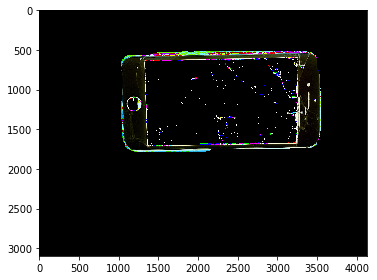

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


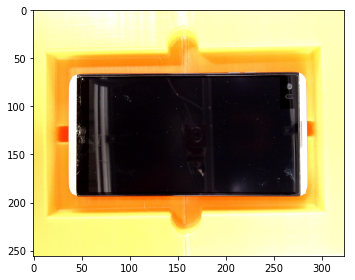

(1, 256, 324, 1)


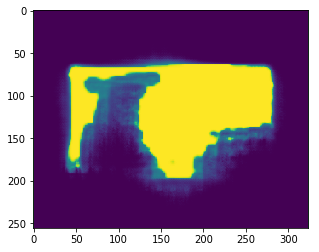

(16927, 3)


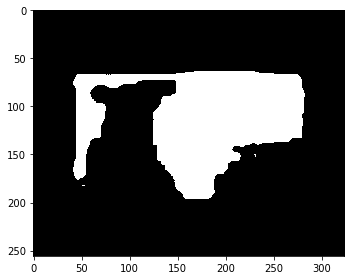

boxShape [[ 535 2381]
 [ 535  760]
 [3591  761]
 [3591 2381]]
box_shape: [[ 535 2381]
 [ 535  760]
 [3591  761]
 [3591 2381]]
(1621, 3056, 3)


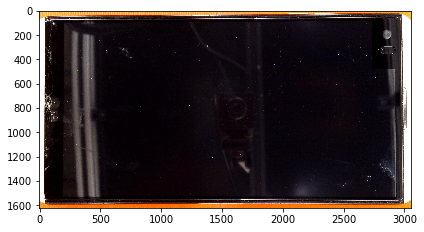

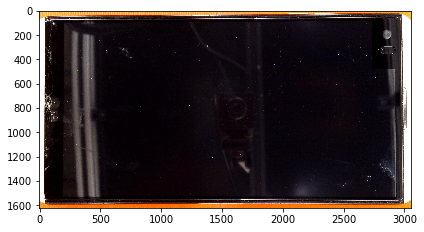

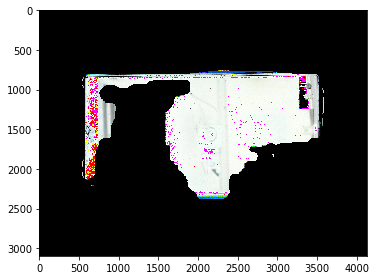

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.08627451
(1, 256, 324, 3)


/home/ubuntu/.local/lib/python3.5/site-packages/skimage/io/_plugins/matplotlib_plugin.py:74: UserWarning: Low image data range; displaying image with stretched contrast.
  warn("Low image data range; displaying image with "


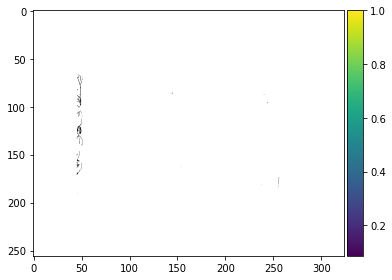

(1, 256, 324, 1)


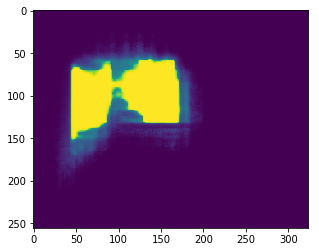

(7369, 3)


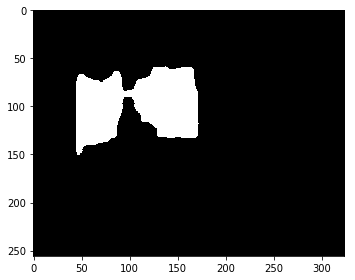

boxShape [[ 577 1830]
 [ 475  823]
 [2141  655]
 [2243 1662]]
box_shape: [[ 577 1830]
 [ 475  823]
 [2141  655]
 [2243 1662]]
(1175, 1768, 3)


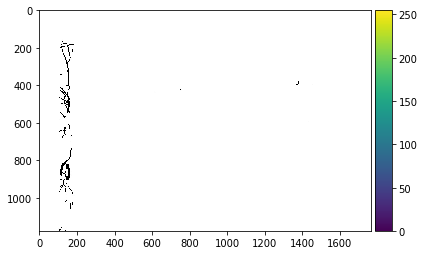

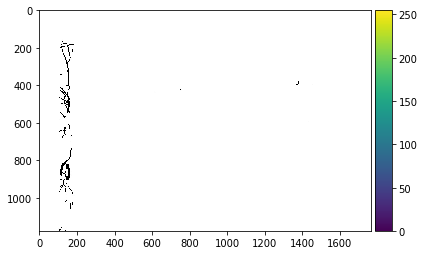

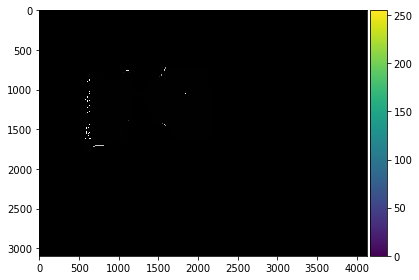

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


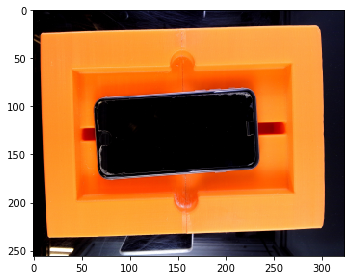

(1, 256, 324, 1)


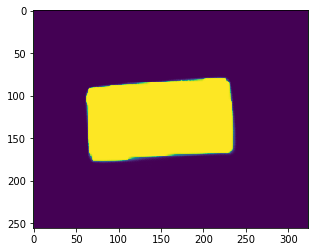

(14614, 3)


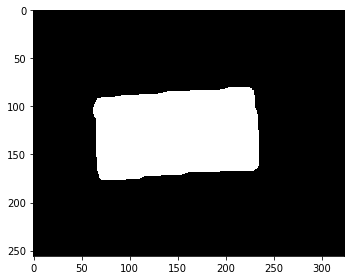

boxShape [[ 844 2165]
 [ 774 1079]
 [2957  938]
 [3027 2024]]
box_shape: [[ 844 2165]
 [ 774 1079]
 [2957  938]
 [3027 2024]]
(1227, 2253, 3)


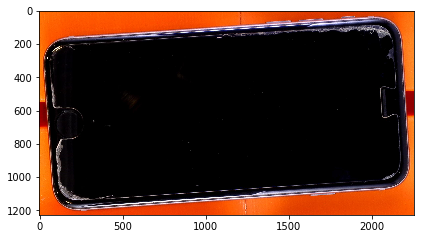

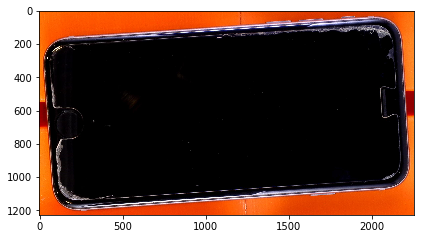

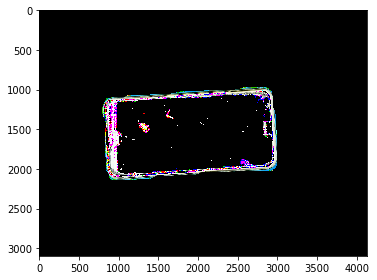

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


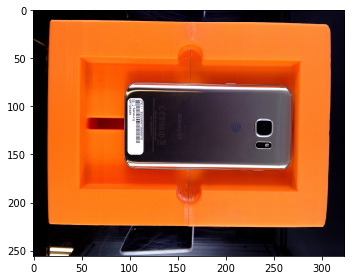

(1, 256, 324, 1)


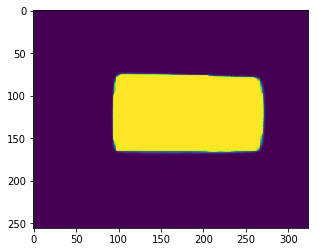

(15293, 3)


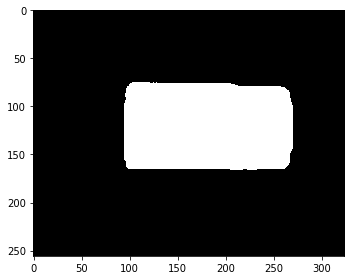

boxShape [[3435 2028]
 [1187 2001]
 [1200  901]
 [3449  929]]
box_shape: [[3435 2028]
 [1187 2001]
 [1200  901]
 [3449  929]]
(1127, 2262, 3)


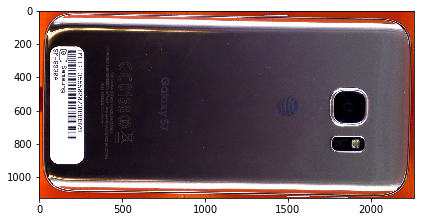

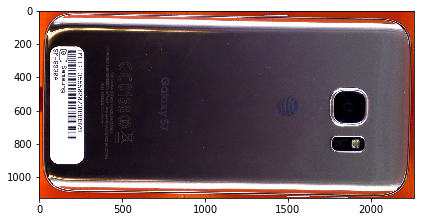

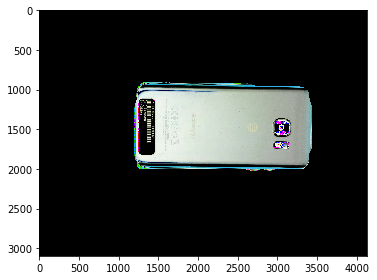

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


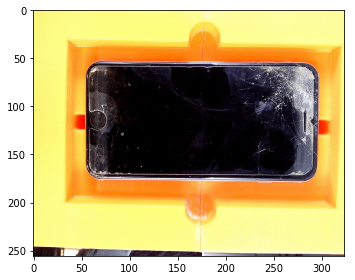

(1, 256, 324, 1)


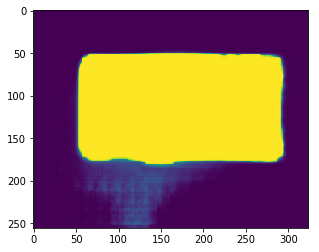

(29594, 3)


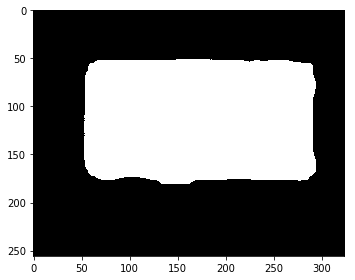

boxShape [[ 675 2188]
 [ 675  616]
 [3745  616]
 [3745 2188]]
box_shape: [[ 675 2188]
 [ 675  616]
 [3745  616]
 [3745 2188]]
(1572, 3070, 3)


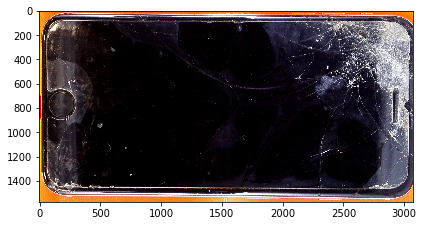

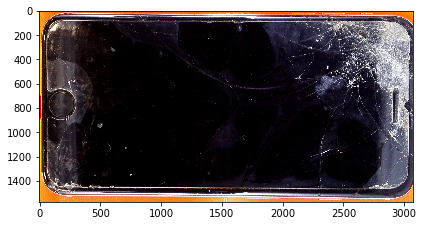

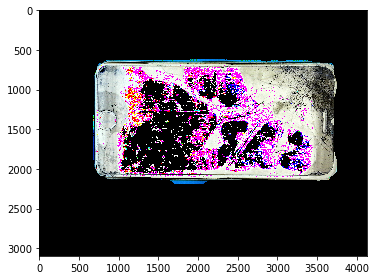

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


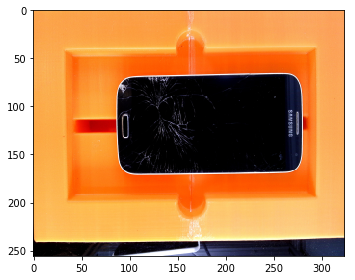

(1, 256, 324, 1)


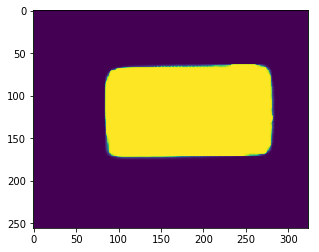

(20136, 3)


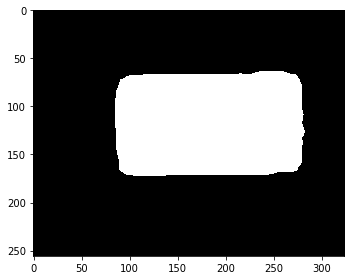

boxShape [[1087 2097]
 [1075  790]
 [3585  768]
 [3596 2075]]
box_shape: [[1087 2097]
 [1075  790]
 [3585  768]
 [3596 2075]]
(1329, 2521, 3)


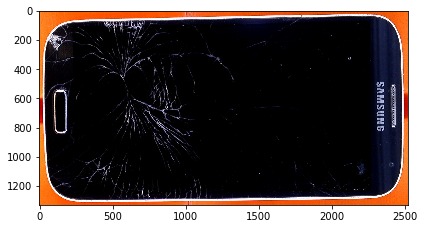

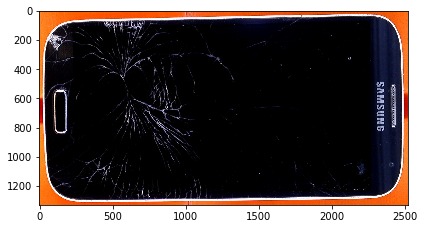

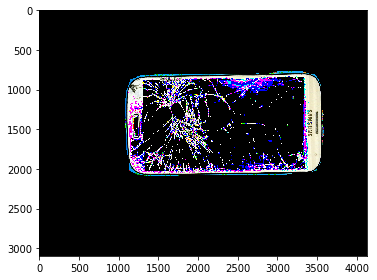

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


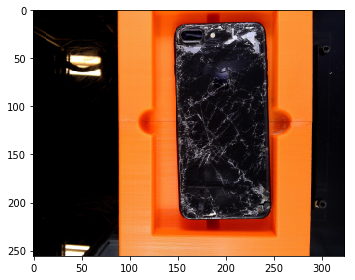

(1, 256, 324, 1)


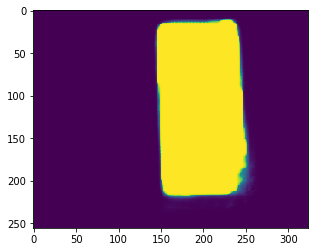

(19384, 3)


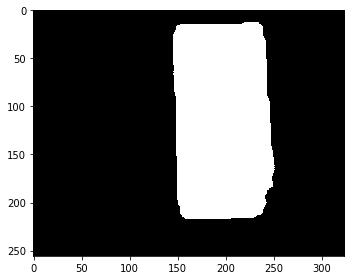

boxShape [[1921 2653]
 [1821  185]
 [3123  132]
 [3223 2600]]
box_shape: [[1921 2653]
 [1821  185]
 [3123  132]
 [3223 2600]]
(2521, 1402, 3)


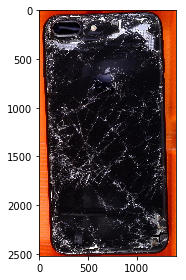

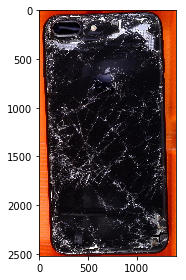

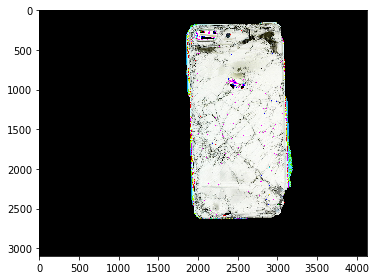

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


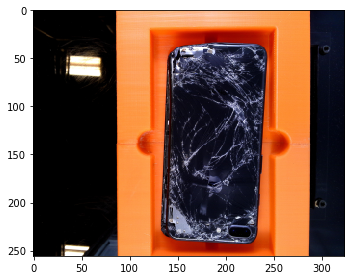

(1, 256, 324, 1)


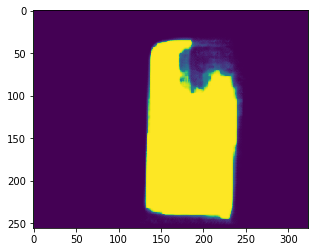

(17558, 3)


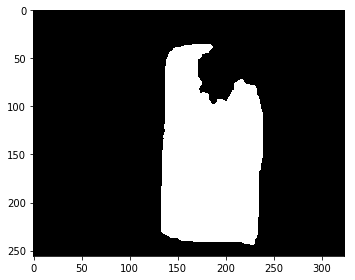

boxShape [[3005 2966]
 [1665 2919]
 [1755  401]
 [3095  449]]
box_shape: [[3005 2966]
 [1665 2919]
 [1755  401]
 [3095  449]]
(2565, 1430, 3)


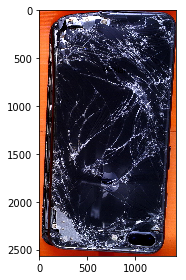

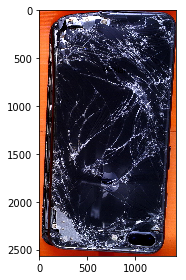

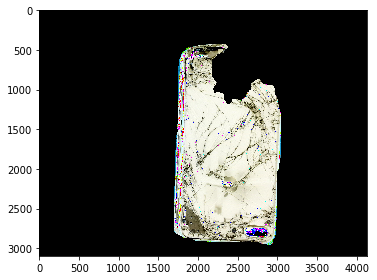

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


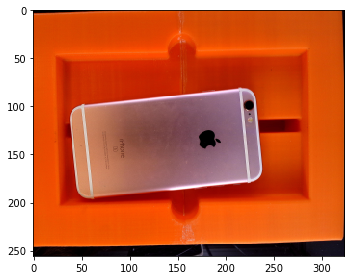

(1, 256, 324, 1)


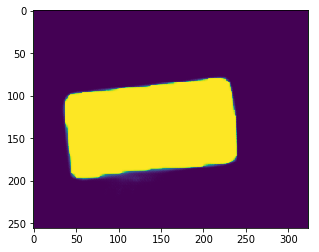

(19283, 3)


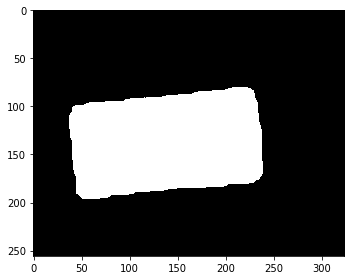

boxShape [[ 565 2424]
 [ 439 1191]
 [2974  932]
 [3100 2165]]
box_shape: [[ 565 2424]
 [ 439 1191]
 [2974  932]
 [3100 2165]]
(1492, 2661, 3)


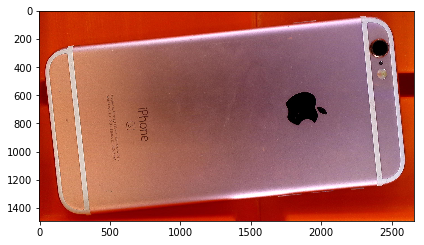

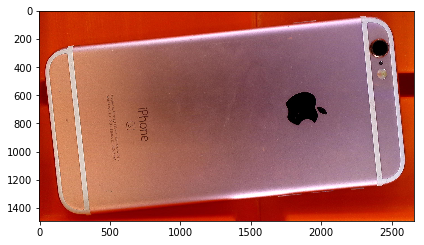

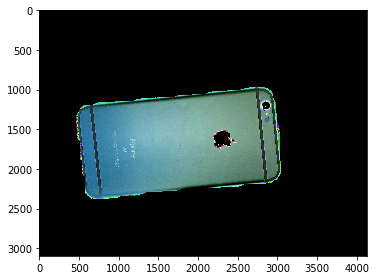

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


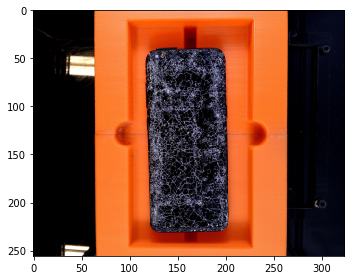

(1, 256, 324, 1)


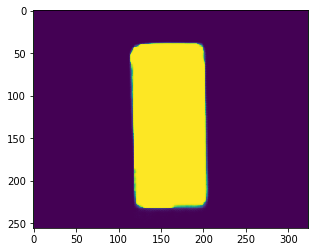

(16029, 3)


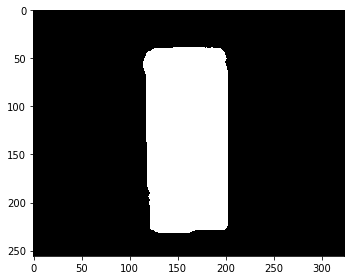

boxShape [[1480 2813]
 [1448  476]
 [2569  461]
 [2600 2797]]
box_shape: [[1480 2813]
 [1448  476]
 [2569  461]
 [2600 2797]]
(2352, 1152, 3)


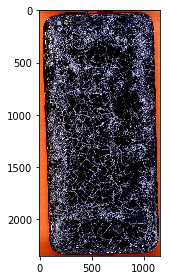

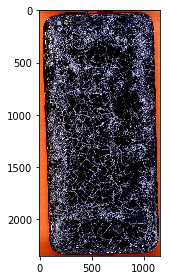

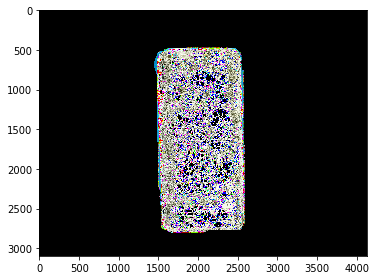

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


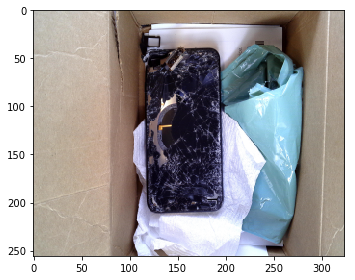

(1, 256, 324, 1)


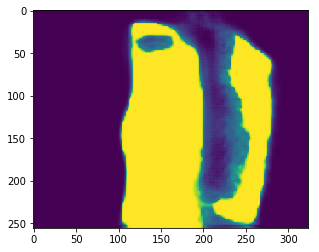

(25844, 3)


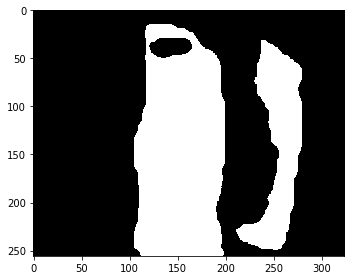

boxShape [[1337 3095]
 [1337  181]
 [2535  181]
 [2535 3095]]
box_shape: [[1337 3095]
 [1337  181]
 [2535  181]
 [2535 3095]]
(2914, 1198, 3)


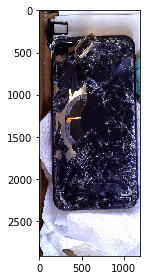

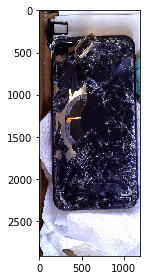

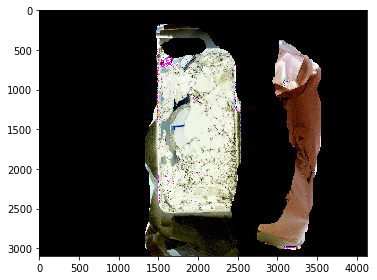

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
0.99607843 0.0
(1, 256, 324, 3)


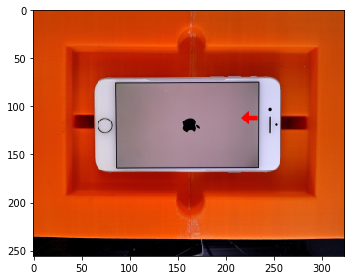

(1, 256, 324, 1)


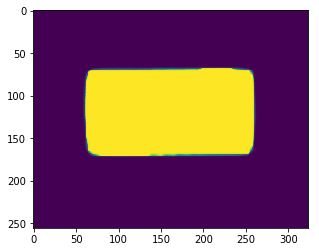

(19445, 3)


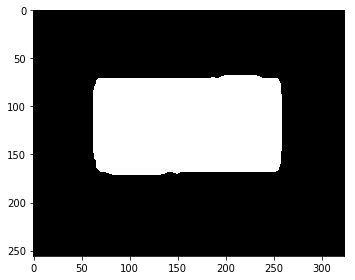

boxShape [[ 792 2099]
 [ 765  860]
 [3293  805]
 [3320 2044]]
box_shape: [[ 792 2099]
 [ 765  860]
 [3293  805]
 [3320 2044]]
(1294, 2555, 3)


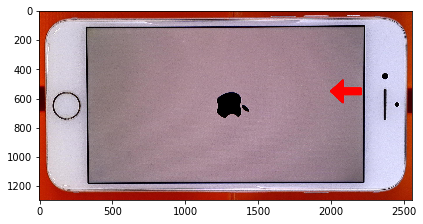

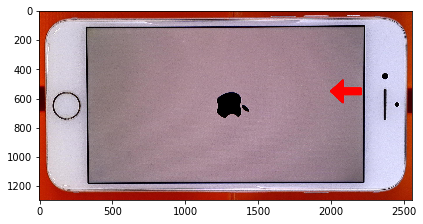

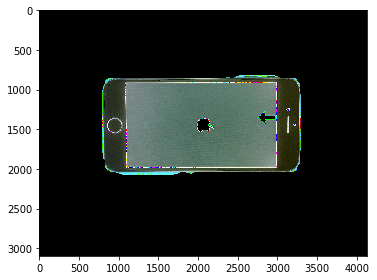

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


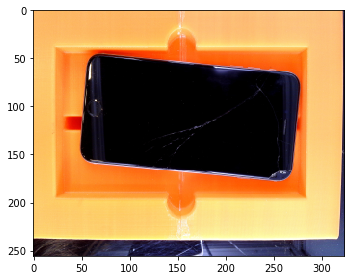

(1, 256, 324, 1)


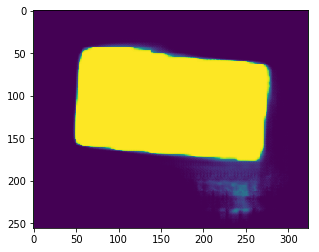

(25555, 3)


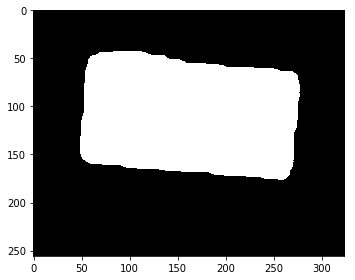

boxShape [[3426 2189]
 [ 577 1921]
 [ 715  451]
 [3564  720]]
box_shape: [[3426 2189]
 [ 577 1921]
 [ 715  451]
 [3564  720]]
(1738, 2987, 3)


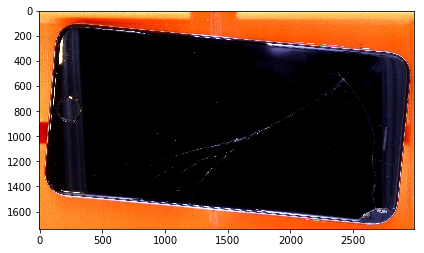

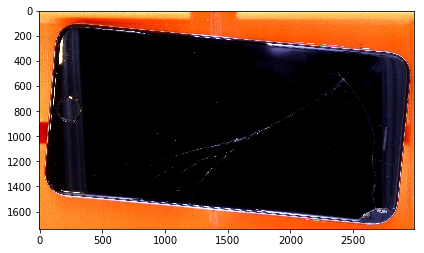

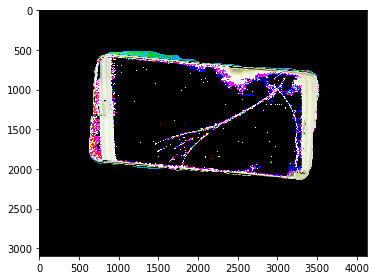

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


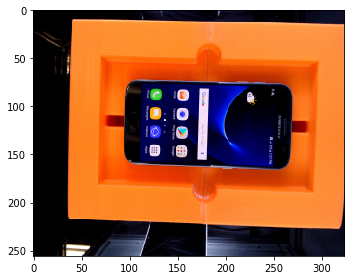

(1, 256, 324, 1)


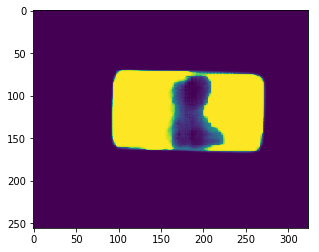

(11639, 3)


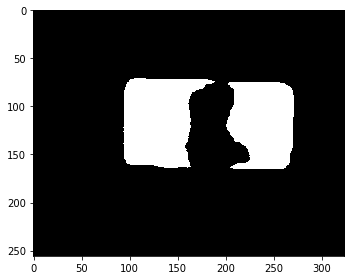

boxShape [[2391 1992]
 [1176 1974]
 [1193  853]
 [2407  871]]
box_shape: [[2391 1992]
 [1176 1974]
 [1193  853]
 [2407  871]]
(1139, 1231, 3)


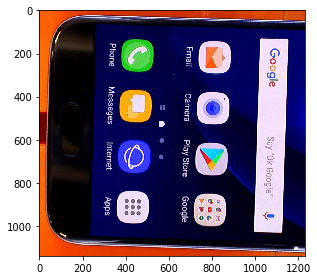

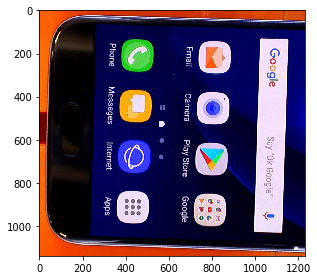

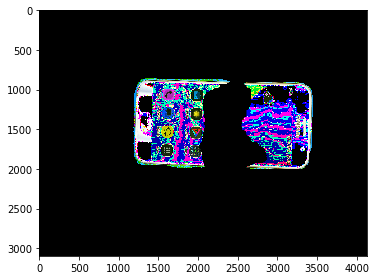

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


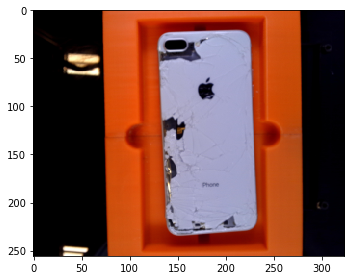

(1, 256, 324, 1)


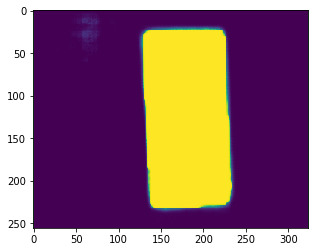

(20016, 3)


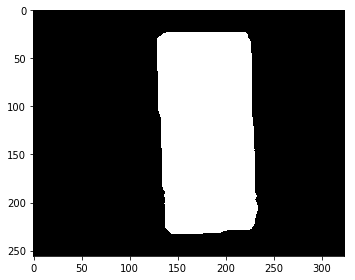

boxShape [[1729 2841]
 [1610  284]
 [2877  225]
 [2996 2782]]
box_shape: [[1729 2841]
 [1610  284]
 [2877  225]
 [2996 2782]]
(2616, 1386, 3)


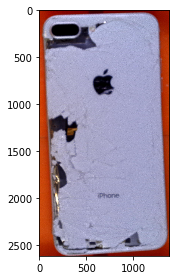

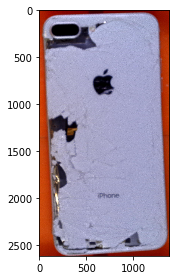

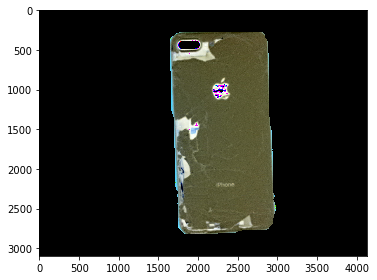

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


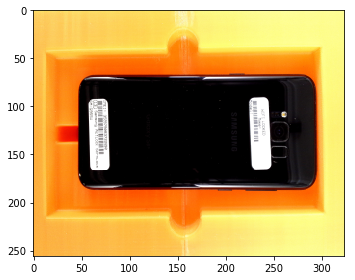

(1, 256, 324, 1)


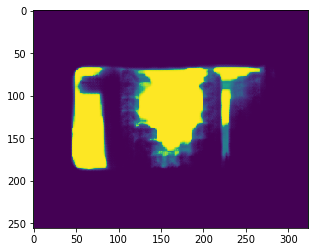

(9696, 3)


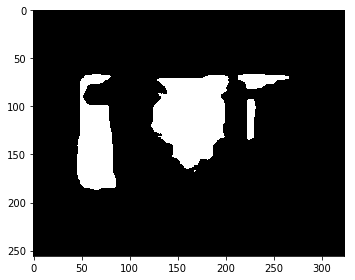

boxShape [[2493 2039]
 [1518 1947]
 [1633  736]
 [2607  828]]
box_shape: [[2493 2039]
 [1518 1947]
 [1633  736]
 [2607  828]]
(1303, 1089, 3)


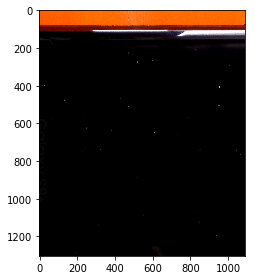

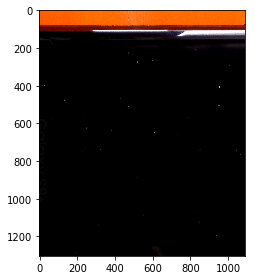

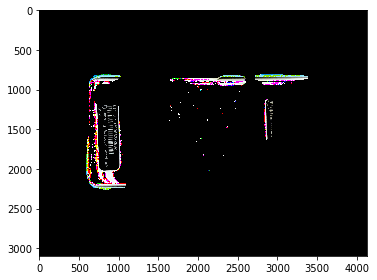

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


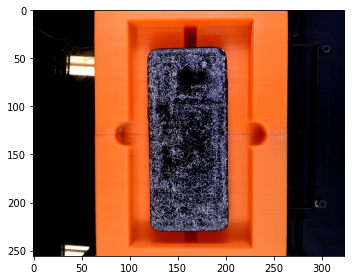

(1, 256, 324, 1)


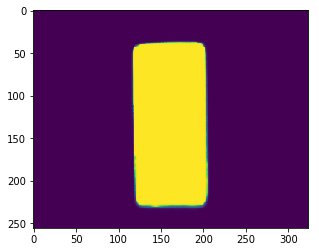

(15920, 3)


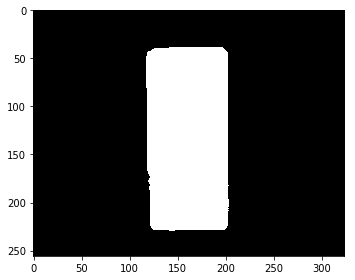

boxShape [[1507 2784]
 [1485  474]
 [2581  463]
 [2604 2773]]
box_shape: [[1507 2784]
 [1485  474]
 [2581  463]
 [2604 2773]]
(2321, 1119, 3)


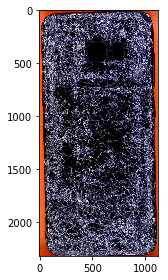

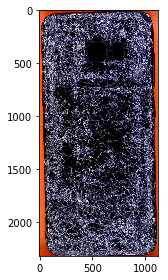

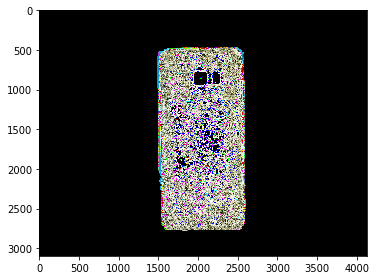

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


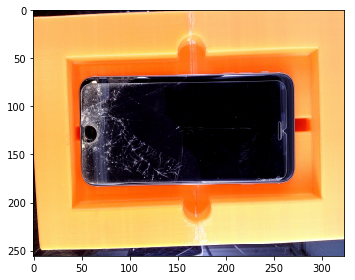

(1, 256, 324, 1)


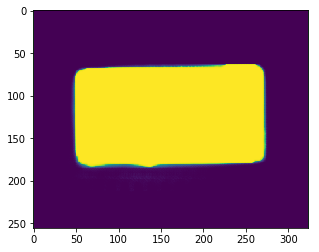

(25186, 3)


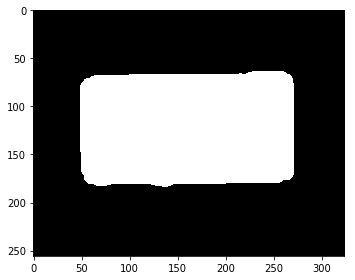

boxShape [[ 634 2250]
 [ 602  824]
 [3448  761]
 [3480 2187]]
box_shape: [[ 634 2250]
 [ 602  824]
 [3448  761]
 [3480 2187]]
(1489, 2878, 3)


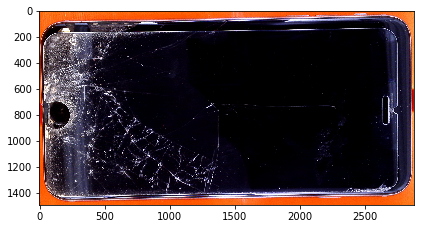

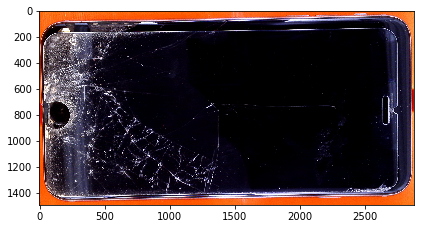

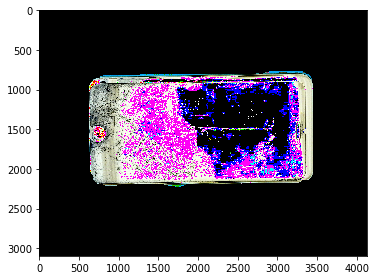

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


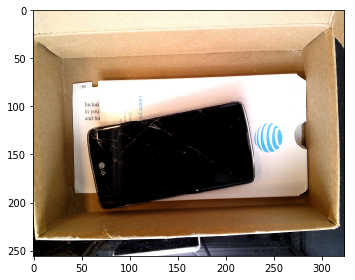

(1, 256, 324, 1)


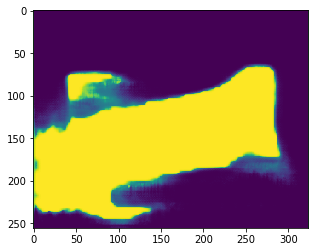

(28710, 3)


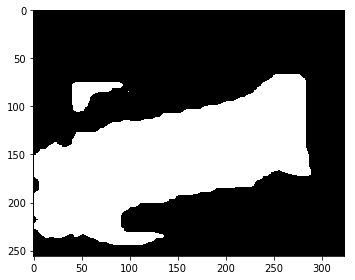

boxShape [[ 166 3317]
 [-261 1765]
 [3557  710]
 [3986 2261]]
box_shape: [[ 166 3317]
 [   0 1765]
 [3557  710]
 [3986 2261]]
(2386, 3986, 3)


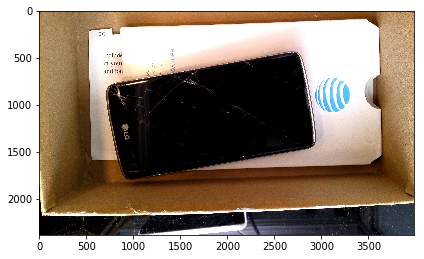

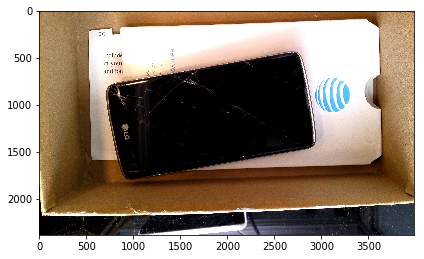

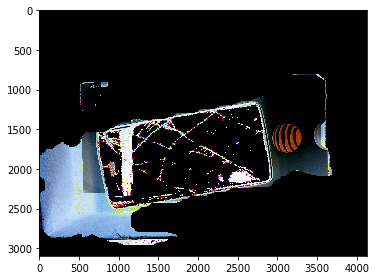

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


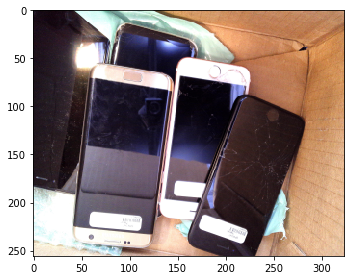

(1, 256, 324, 1)


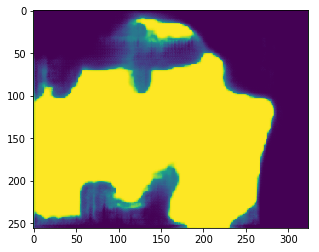

(40759, 3)


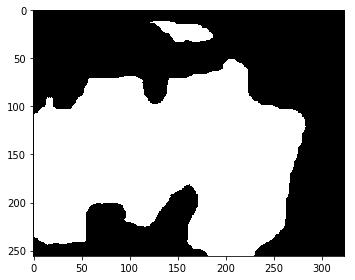

boxShape [[  12 3095]
 [  12  616]
 [3605  616]
 [3605 3095]]
box_shape: [[  12 3095]
 [  12  616]
 [3605  616]
 [3605 3095]]
(2479, 3593, 3)


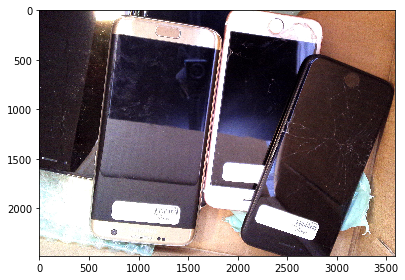

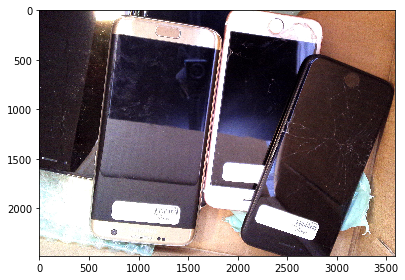

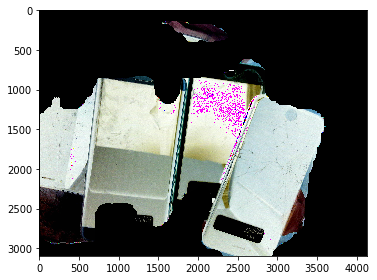

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


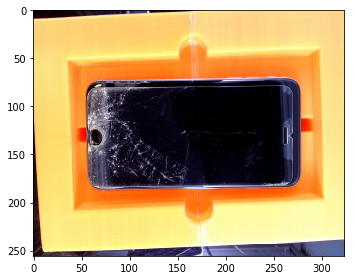

(1, 256, 324, 1)


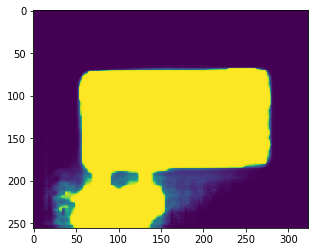

(31189, 3)


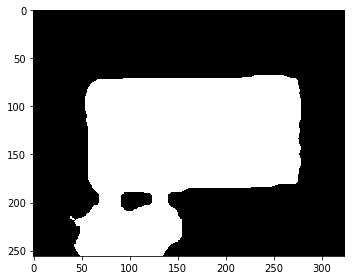

boxShape [[ 494 3120]
 [ 447  873]
 [3534  809]
 [3581 3056]]
box_shape: [[ 494 3120]
 [ 447  873]
 [3534  809]
 [3581 3056]]
(2287, 3134, 3)


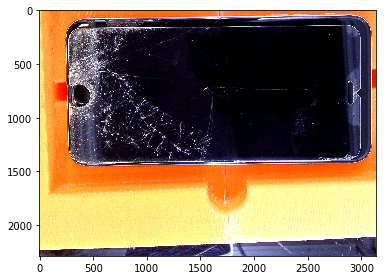

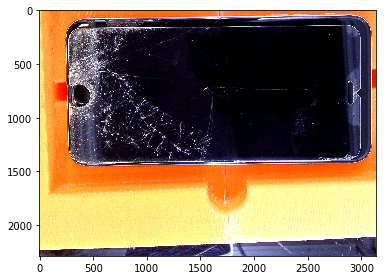

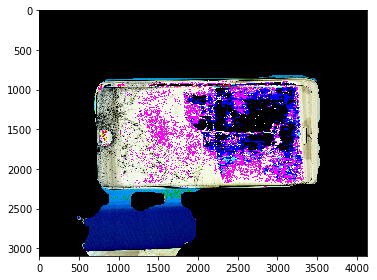

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


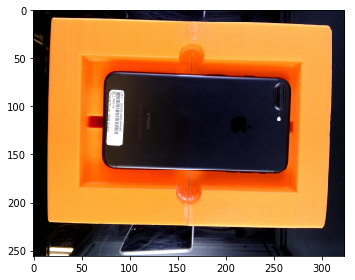

(1, 256, 324, 1)


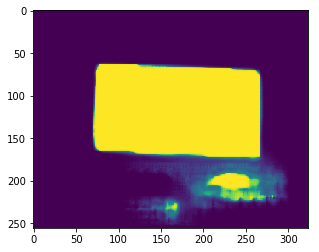

(20478, 3)


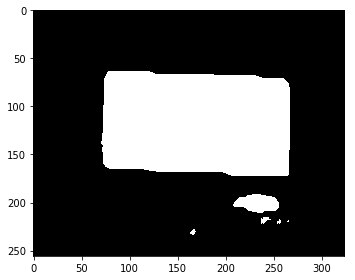

boxShape [[3388 2118]
 [ 890 2032]
 [ 934  752]
 [3432  838]]
box_shape: [[3388 2118]
 [ 890 2032]
 [ 934  752]
 [3432  838]]
(1366, 2542, 3)


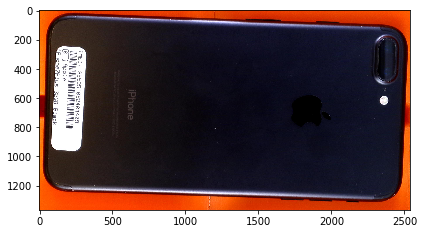

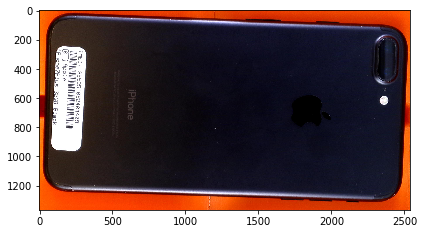

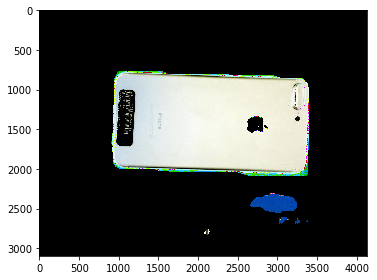

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


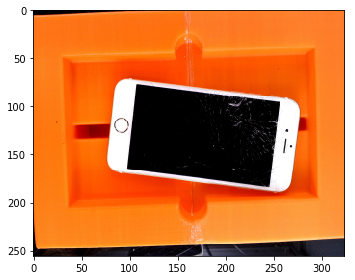

(1, 256, 324, 1)


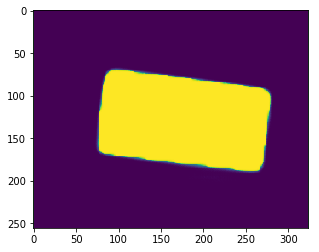

(19265, 3)


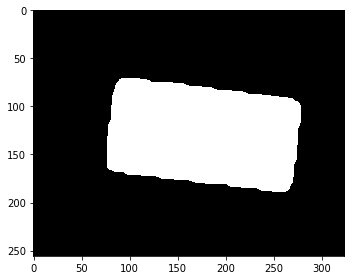

boxShape [[3443 2319]
 [ 926 2045]
 [1060  816]
 [3577 1090]]
box_shape: [[3443 2319]
 [ 926 2045]
 [1060  816]
 [3577 1090]]
(1503, 2651, 3)


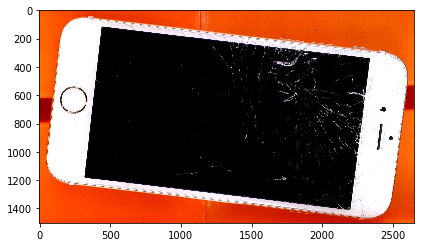

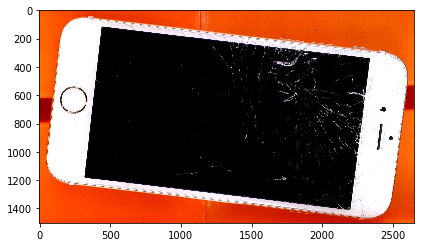

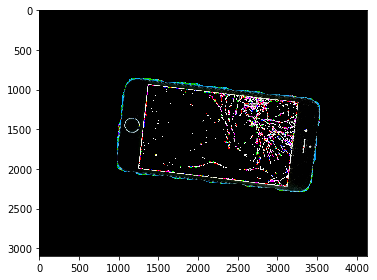

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


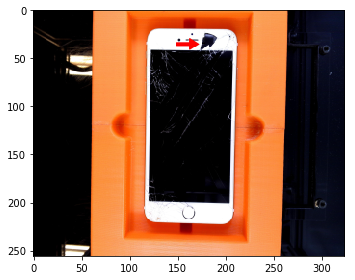

(1, 256, 324, 1)


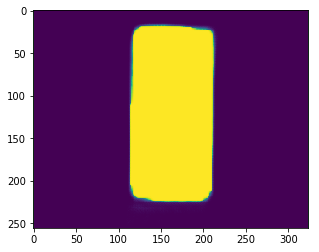

(19178, 3)


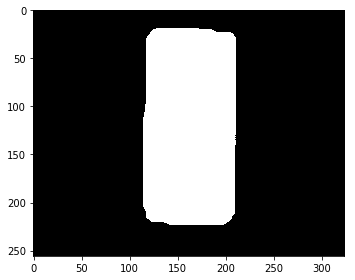

boxShape [[1452 2708]
 [1452  229]
 [2688  229]
 [2688 2708]]
box_shape: [[1452 2708]
 [1452  229]
 [2688  229]
 [2688 2708]]
(2479, 1236, 3)


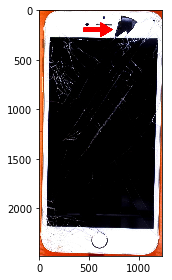

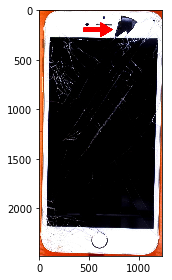

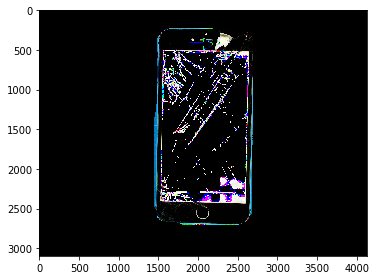

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


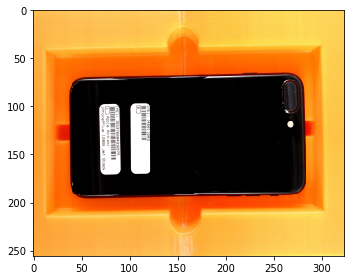

(1, 256, 324, 1)


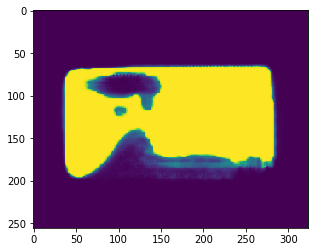

(22688, 3)


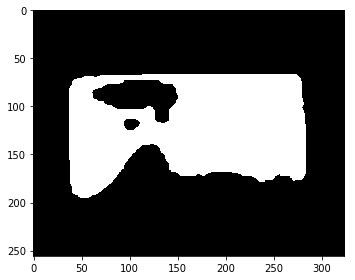

boxShape [[ 492 2380]
 [ 426  842]
 [3573  706]
 [3639 2245]]
box_shape: [[ 492 2380]
 [ 426  842]
 [3573  706]
 [3639 2245]]
(1674, 3213, 3)


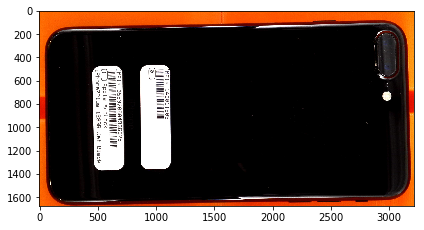

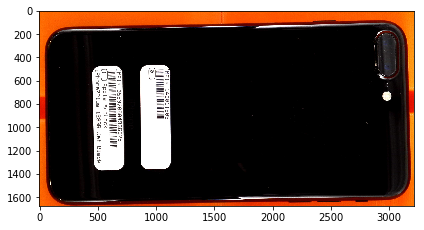

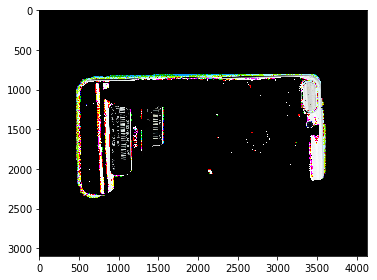

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


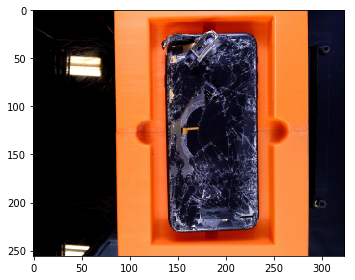

(1, 256, 324, 1)


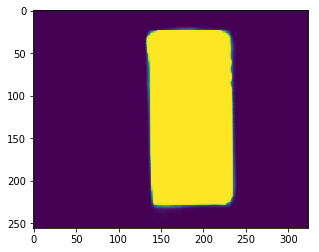

(19652, 3)


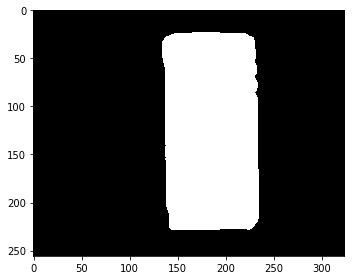

boxShape [[1733 2782]
 [1703  282]
 [2973  267]
 [3003 2767]]
box_shape: [[1733 2782]
 [1703  282]
 [2973  267]
 [3003 2767]]
(2515, 1300, 3)


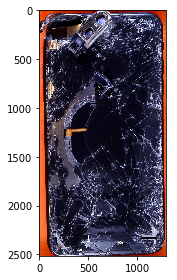

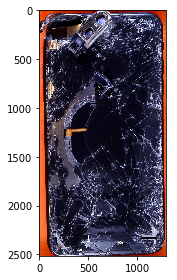

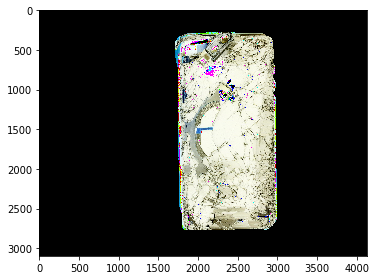

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


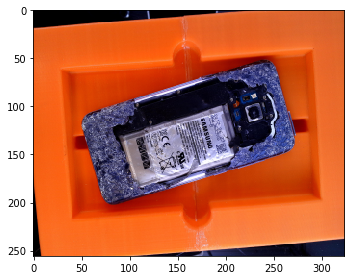

(1, 256, 324, 1)


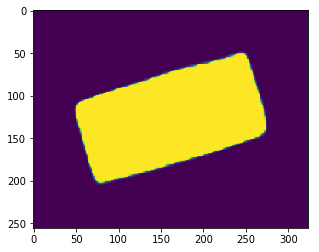

(21384, 3)


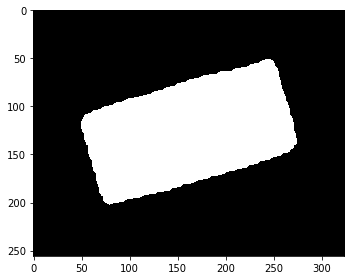

boxShape [[ 926 2524]
 [ 577 1289]
 [3210  546]
 [3559 1781]]
box_shape: [[ 926 2524]
 [ 577 1289]
 [3210  546]
 [3559 1781]]
(1978, 2982, 3)


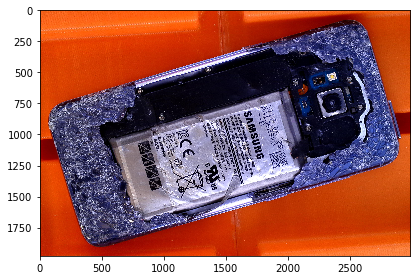

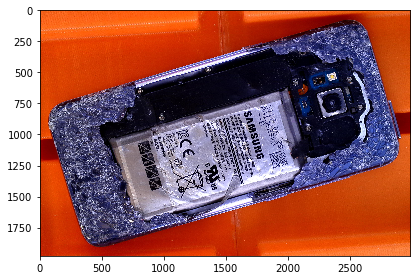

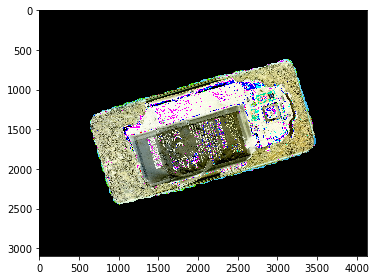

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


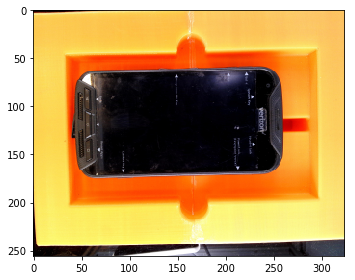

(1, 256, 324, 1)


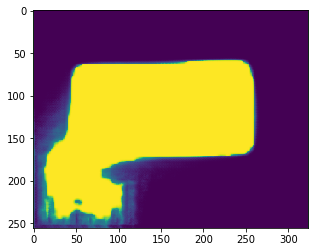

(29089, 3)


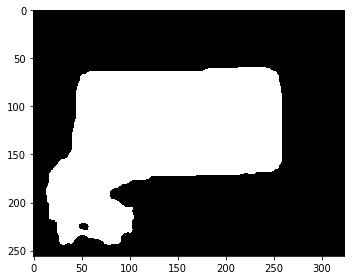

boxShape [[ 182 2983]
 [ 125  779]
 [3290  698]
 [3347 2902]]
box_shape: [[ 182 2983]
 [ 125  779]
 [3290  698]
 [3347 2902]]
(2285, 3222, 3)


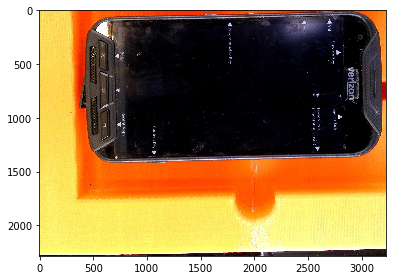

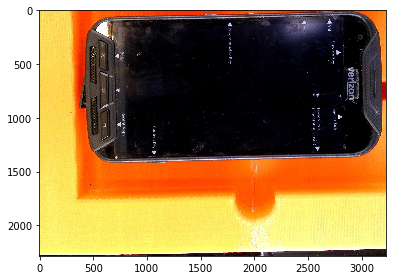

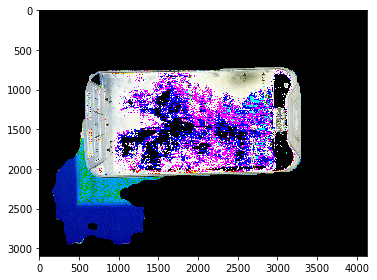

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


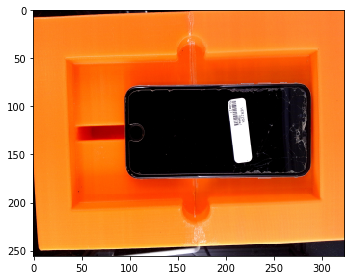

(1, 256, 324, 1)


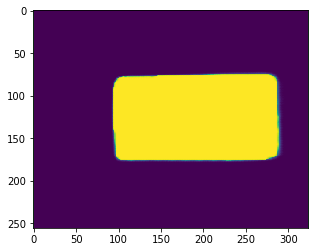

(19017, 3)


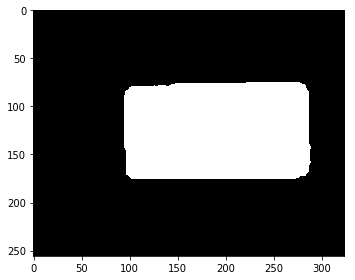

boxShape [[1197 2128]
 [1197  907]
 [3682  907]
 [3682 2128]]
box_shape: [[1197 2128]
 [1197  907]
 [3682  907]
 [3682 2128]]
(1221, 2485, 3)


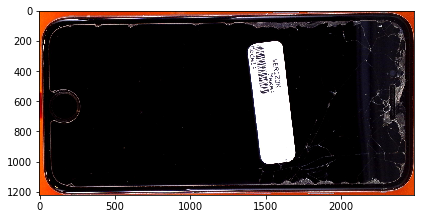

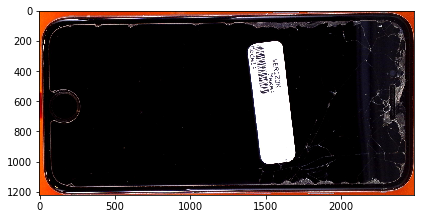

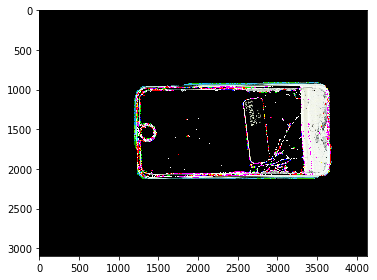

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


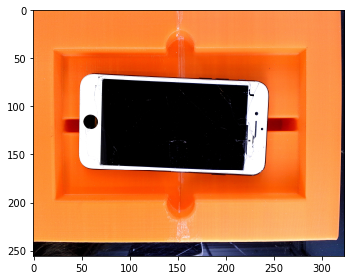

(1, 256, 324, 1)


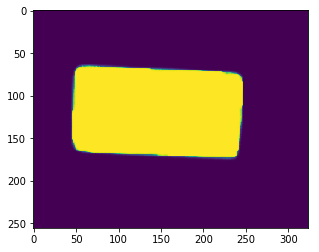

(19571, 3)


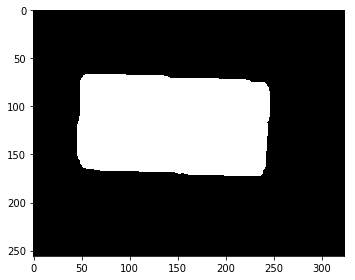

boxShape [[3100 2124]
 [ 561 2017]
 [ 614  774]
 [3153  882]]
box_shape: [[3100 2124]
 [ 561 2017]
 [ 614  774]
 [3153  882]]
(1350, 2592, 3)


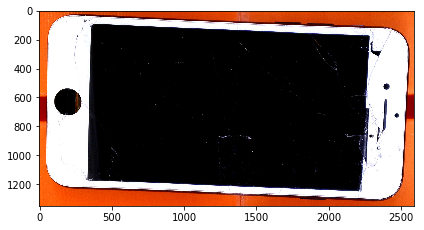

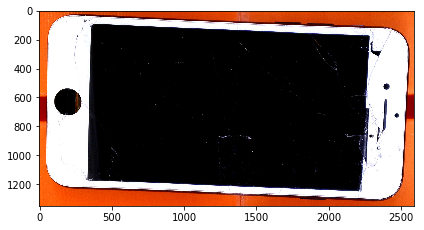

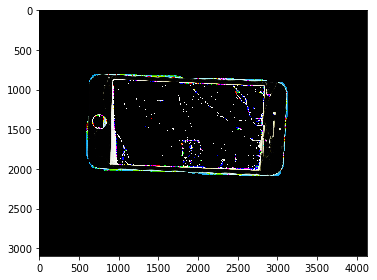

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4128, 3096, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


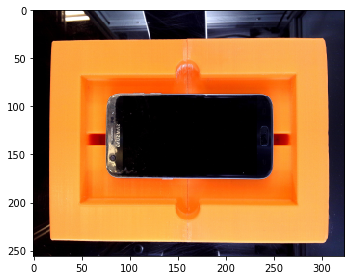

(1, 256, 324, 1)


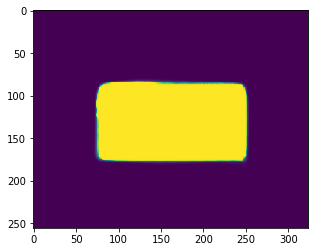

(15695, 3)


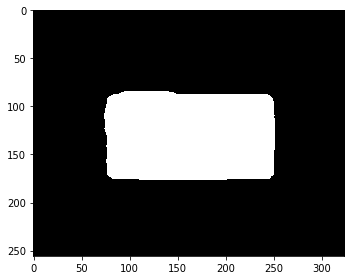

boxShape [[ 942 2140]
 [ 942 1015]
 [3197 1015]
 [3197 2140]]
box_shape: [[ 942 2140]
 [ 942 1015]
 [3197 1015]
 [3197 2140]]
(1125, 2255, 3)


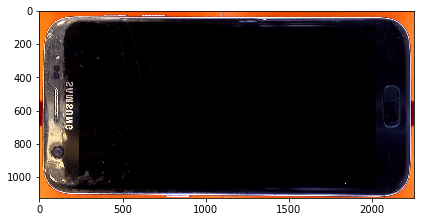

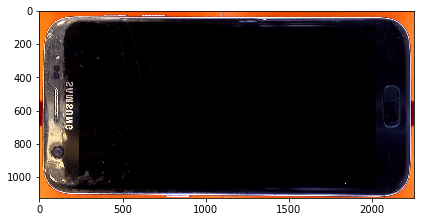

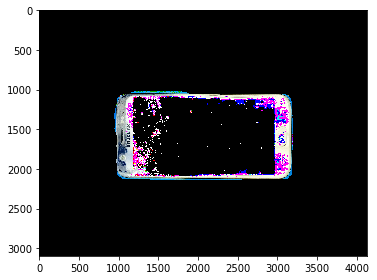

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


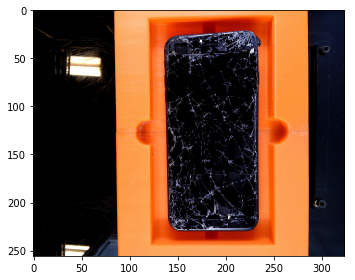

(1, 256, 324, 1)


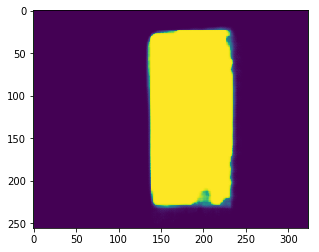

(19049, 3)


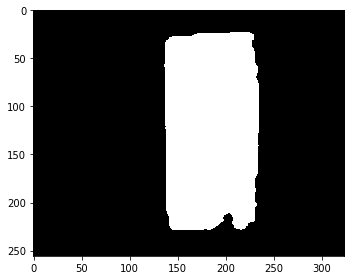

boxShape [[1761 2783]
 [1725  290]
 [2984  272]
 [3020 2765]]
box_shape: [[1761 2783]
 [1725  290]
 [2984  272]
 [3020 2765]]
(2511, 1295, 3)


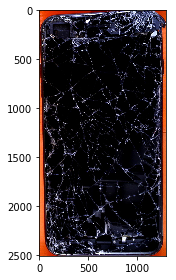

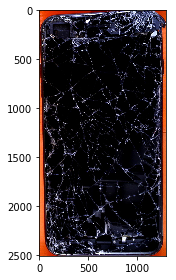

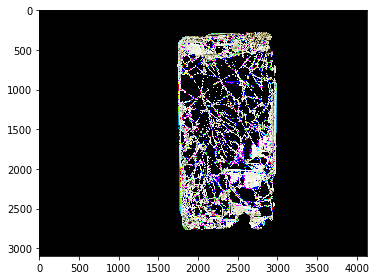

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


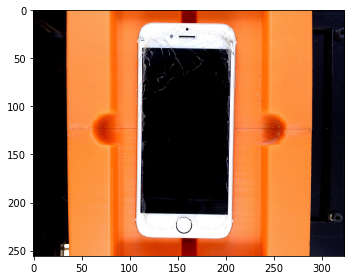

(1, 256, 324, 1)


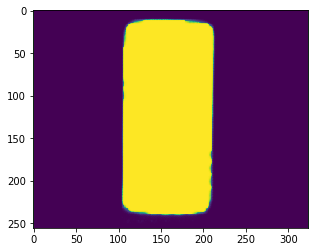

(23157, 3)


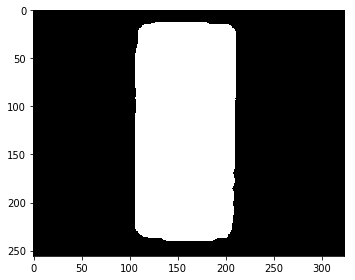

boxShape [[1349 2901]
 [1349  145]
 [2687  145]
 [2687 2901]]
box_shape: [[1349 2901]
 [1349  145]
 [2687  145]
 [2687 2901]]
(2756, 1338, 3)


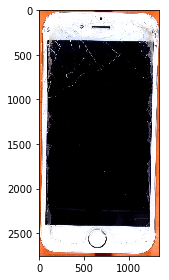

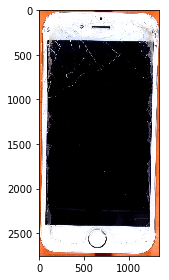

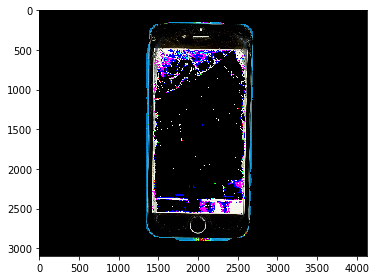

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


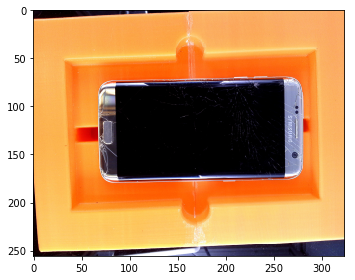

(1, 256, 324, 1)


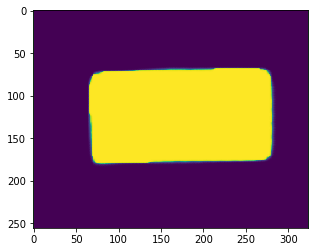

(22593, 3)


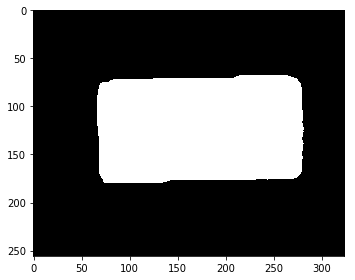

boxShape [[ 859 2198]
 [ 824  871]
 [3562  800]
 [3596 2127]]
box_shape: [[ 859 2198]
 [ 824  871]
 [3562  800]
 [3596 2127]]
(1398, 2772, 3)


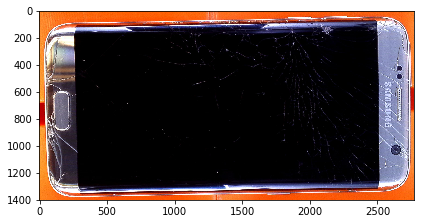

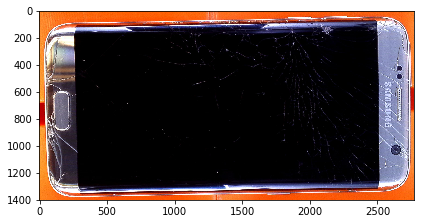

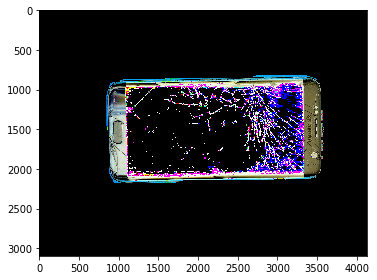

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


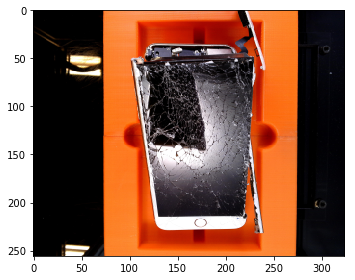

(1, 256, 324, 1)


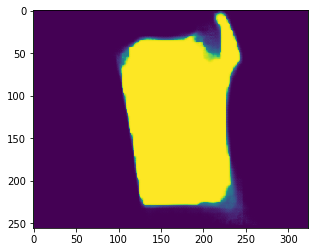

(22073, 3)


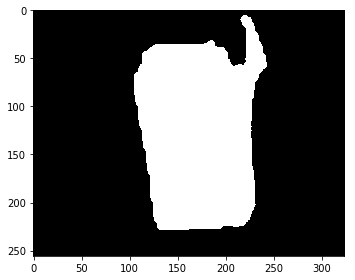

boxShape [[1594 2892]
 [1225  279]
 [3006   27]
 [3375 2641]]
box_shape: [[1594 2892]
 [1225  279]
 [3006   27]
 [3375 2641]]
(2865, 2150, 3)


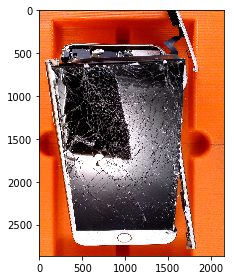

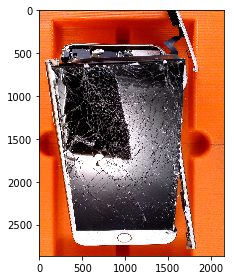

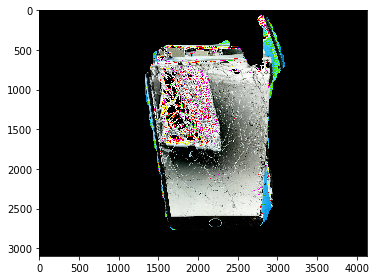

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


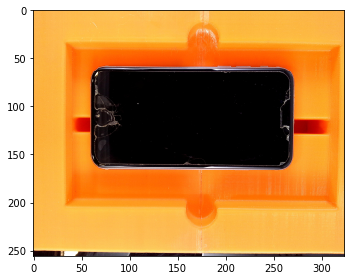

(1, 256, 324, 1)


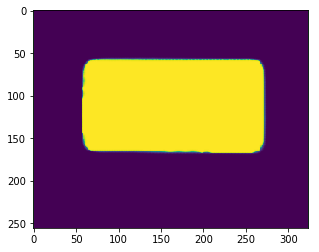

(22517, 3)


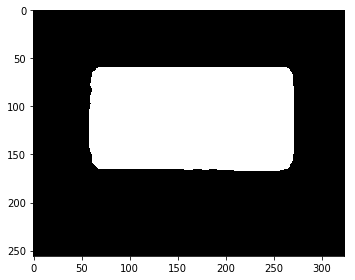

boxShape [[ 738 2031]
 [ 738  713]
 [3452  713]
 [3452 2031]]
box_shape: [[ 738 2031]
 [ 738  713]
 [3452  713]
 [3452 2031]]
(1318, 2714, 3)


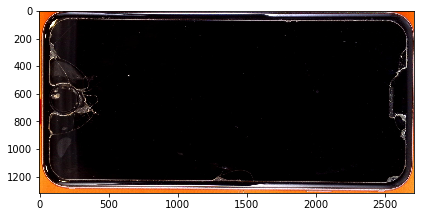

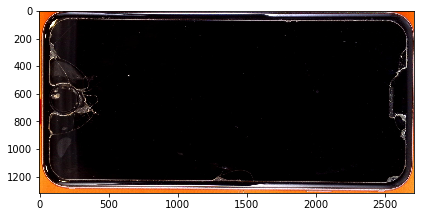

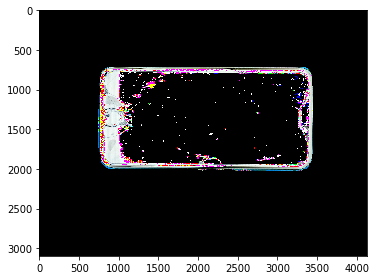

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


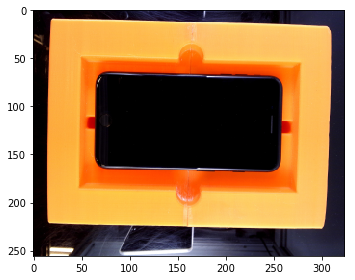

(1, 256, 324, 1)


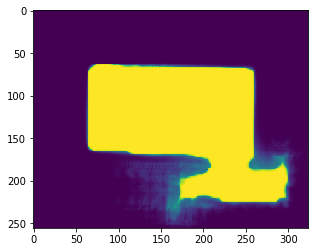

(24613, 3)


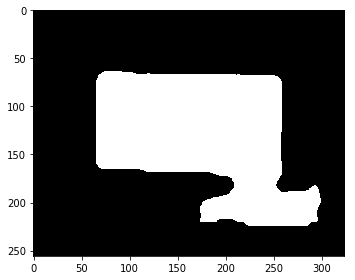

boxShape [[3801 2743]
 [ 786 2673]
 [ 830  766]
 [3845  835]]
box_shape: [[3801 2743]
 [ 786 2673]
 [ 830  766]
 [3845  835]]
(1977, 3059, 3)


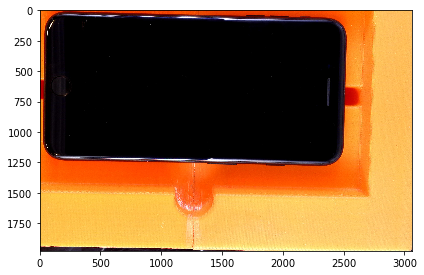

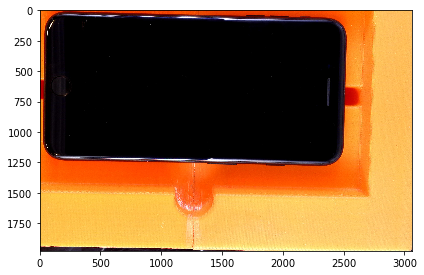

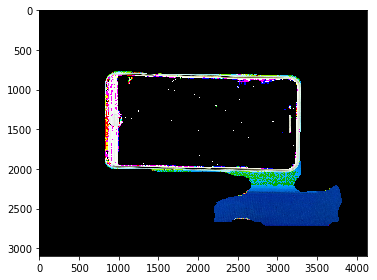

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


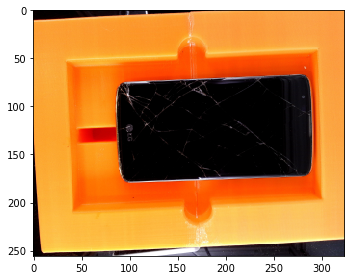

(1, 256, 324, 1)


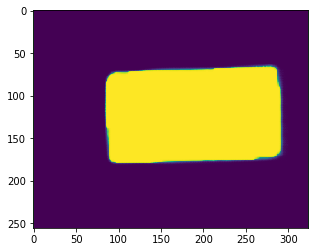

(21579, 3)


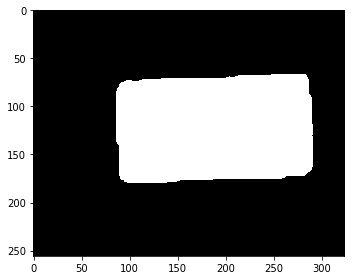

boxShape [[1111 2196]
 [1070  873]
 [3686  791]
 [3728 2114]]
box_shape: [[1111 2196]
 [1070  873]
 [3686  791]
 [3728 2114]]
(1405, 2658, 3)


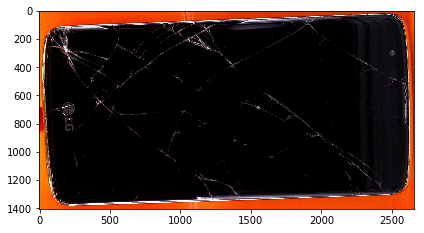

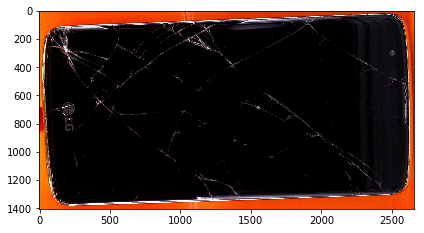

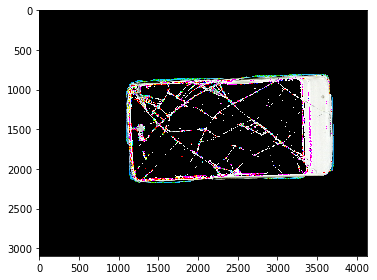

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


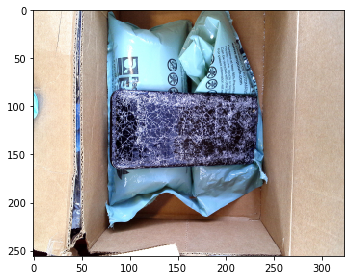

(1, 256, 324, 1)


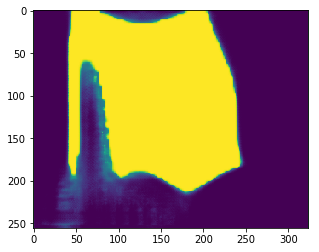

(31763, 3)


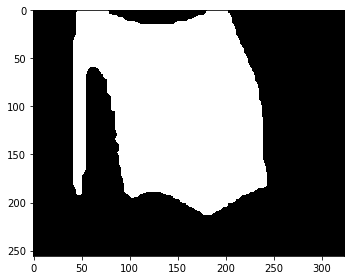

boxShape [[ 535 2575]
 [ 535    0]
 [3095    0]
 [3095 2575]]
box_shape: [[ 535 2575]
 [ 535    0]
 [3095    0]
 [3095 2575]]
(2575, 2560, 3)


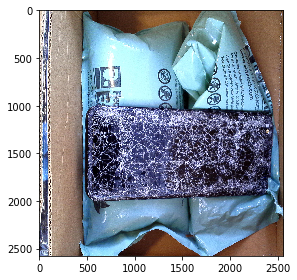

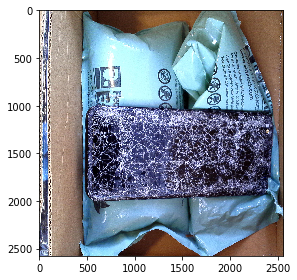

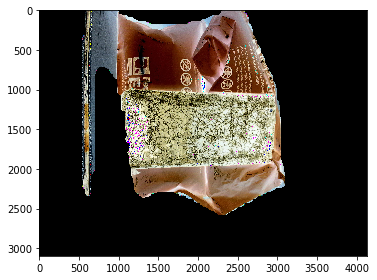

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


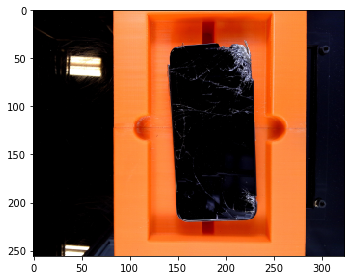

(1, 256, 324, 1)


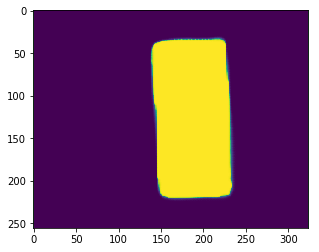

(15796, 3)


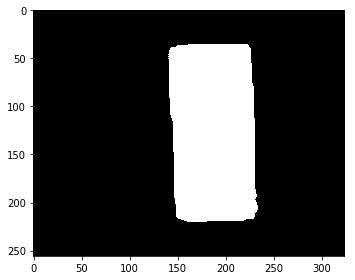

boxShape [[1850 2692]
 [1772  432]
 [2909  393]
 [2987 2653]]
box_shape: [[1850 2692]
 [1772  432]
 [2909  393]
 [2987 2653]]
(2299, 1215, 3)


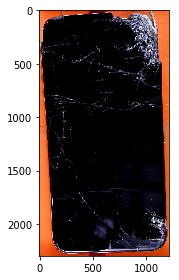

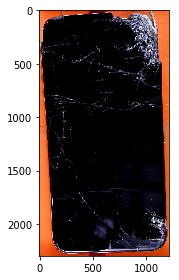

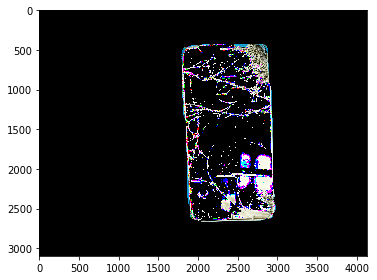

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


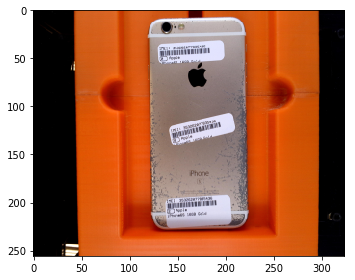

(1, 256, 324, 1)


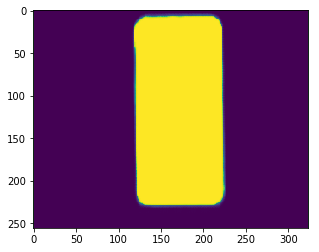

(22280, 3)


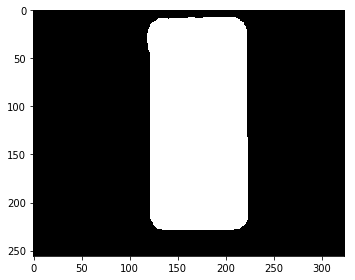

boxShape [[1525 2779]
 [1499   89]
 [2826   76]
 [2852 2767]]
box_shape: [[1525 2779]
 [1499   89]
 [2826   76]
 [2852 2767]]
(2703, 1353, 3)


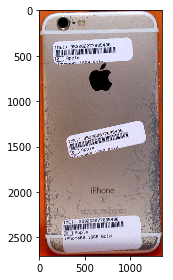

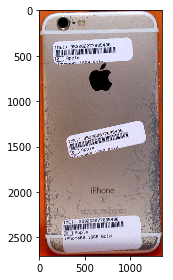

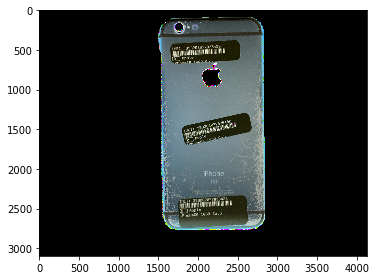

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4128, 3096, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


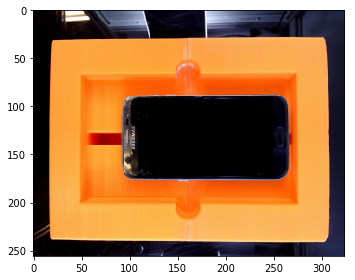

(1, 256, 324, 1)


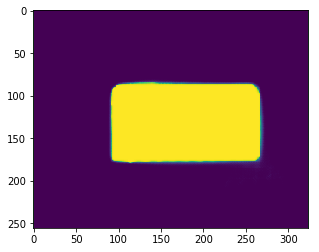

(15597, 3)


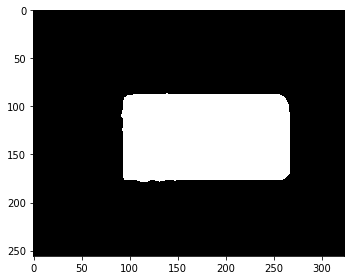

boxShape [[1171 2171]
 [1154 1048]
 [3397 1015]
 [3413 2138]]
box_shape: [[1171 2171]
 [1154 1048]
 [3397 1015]
 [3413 2138]]
(1156, 2259, 3)


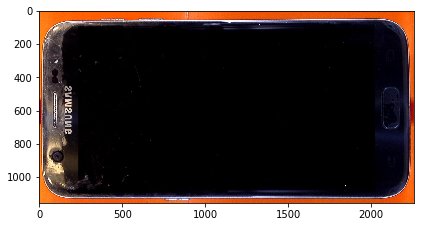

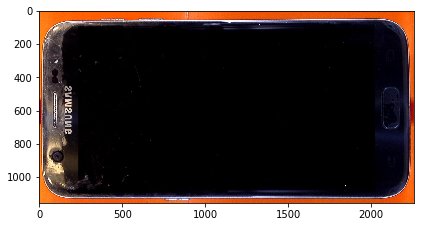

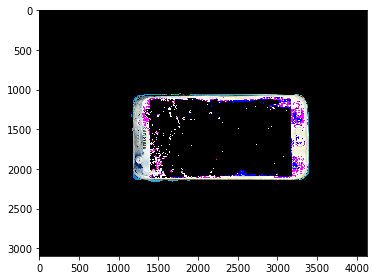

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
0.98039216 0.0
(1, 256, 324, 3)


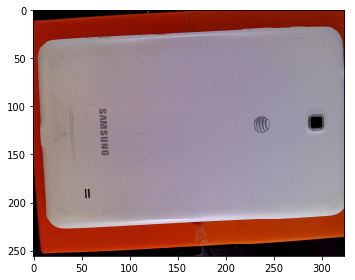

(1, 256, 324, 1)


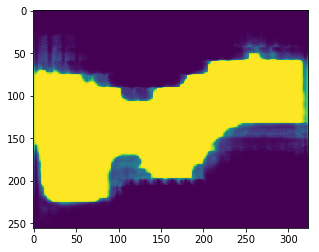

(31724, 3)


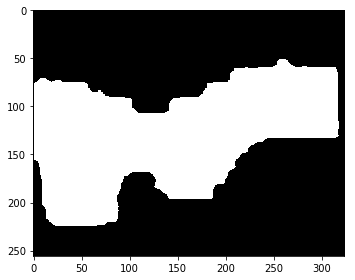

boxShape [[  80 2779]
 [ -65  869]
 [4020  556]
 [4166 2466]]
box_shape: [[  80 2779]
 [   0  869]
 [4020  556]
 [3096 2466]]
(2223, 4020, 3)


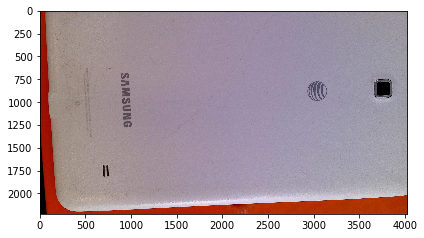

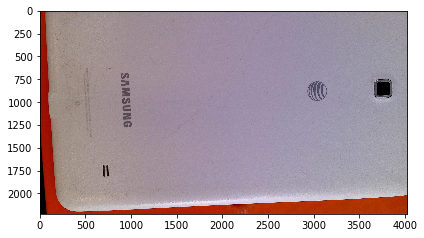

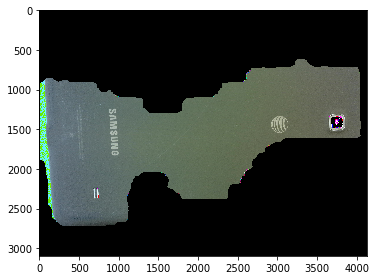

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


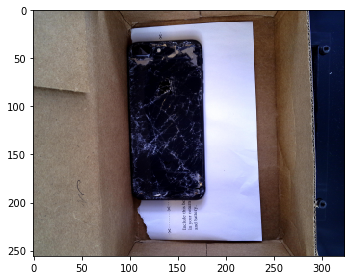

(1, 256, 324, 1)


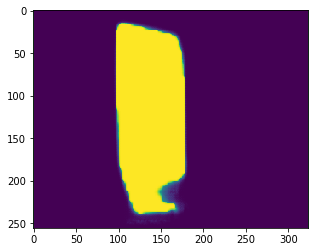

(15170, 3)


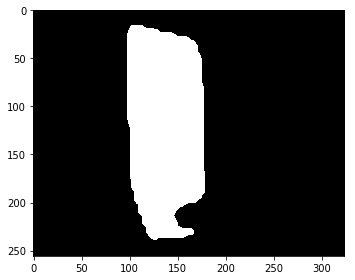

boxShape [[1266 2894]
 [1233  193]
 [2257  181]
 [2290 2882]]
box_shape: [[1266 2894]
 [1233  193]
 [2257  181]
 [2290 2882]]
(2713, 1057, 3)


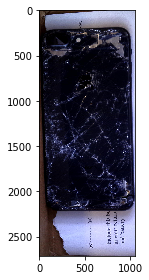

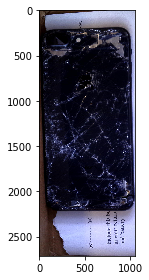

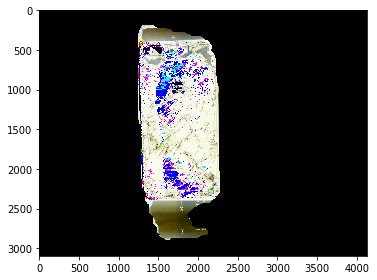

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


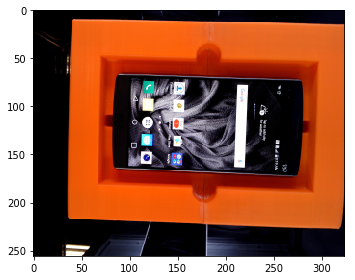

(1, 256, 324, 1)


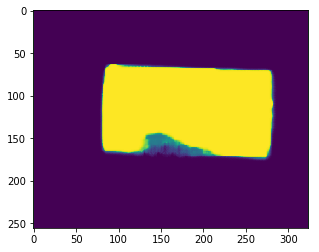

(18624, 3)


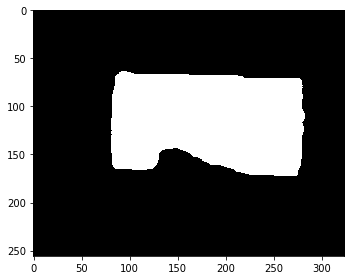

boxShape [[3561 2108]
 [1005 2005]
 [1056  754]
 [3612  858]]
box_shape: [[3561 2108]
 [1005 2005]
 [1056  754]
 [3612  858]]
(1354, 2607, 3)


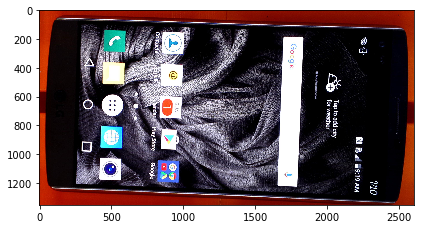

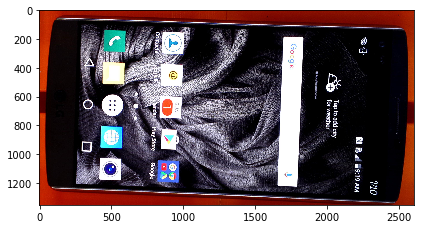

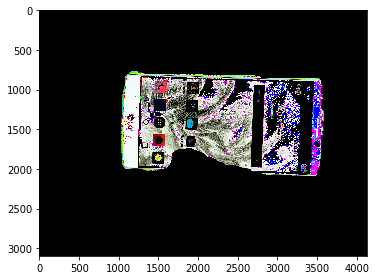

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
0.99607843 0.0
(1, 256, 324, 3)


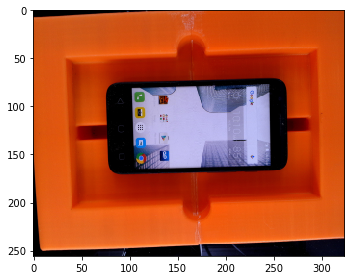

(1, 256, 324, 1)


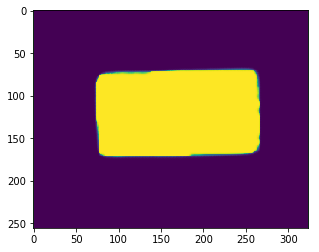

(18485, 3)


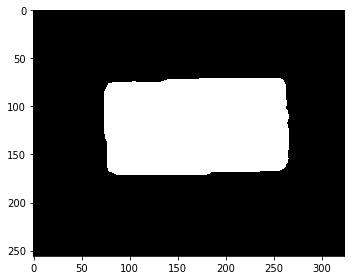

boxShape [[ 942 2080]
 [ 942  858]
 [3389  858]
 [3389 2080]]
box_shape: [[ 942 2080]
 [ 942  858]
 [3389  858]
 [3389 2080]]
(1222, 2447, 3)


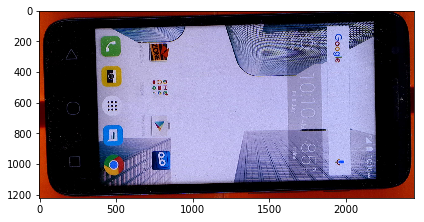

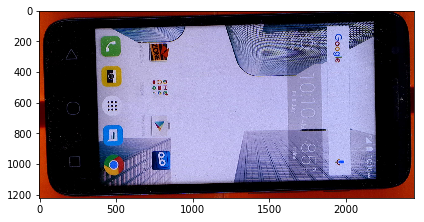

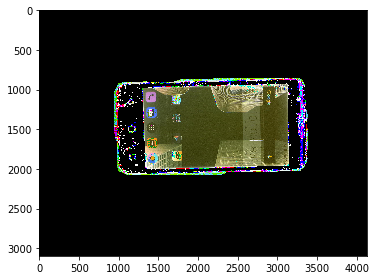

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


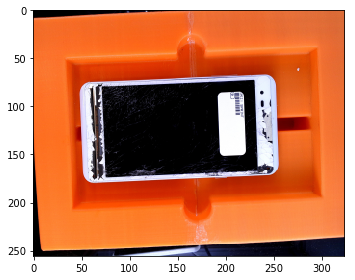

(1, 256, 324, 1)


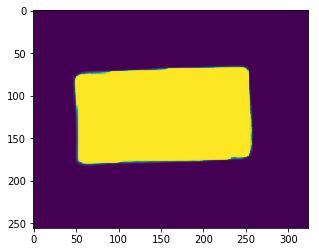

(21620, 3)


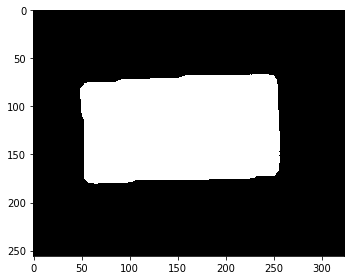

boxShape [[ 656 2194]
 [ 616  863]
 [3238  785]
 [3278 2115]]
box_shape: [[ 656 2194]
 [ 616  863]
 [3238  785]
 [3278 2115]]
(1409, 2662, 3)


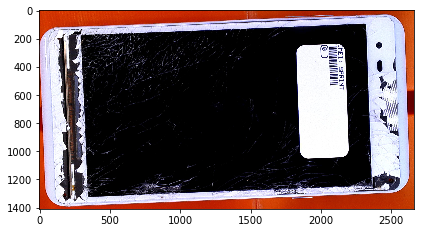

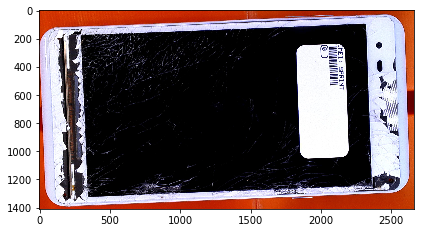

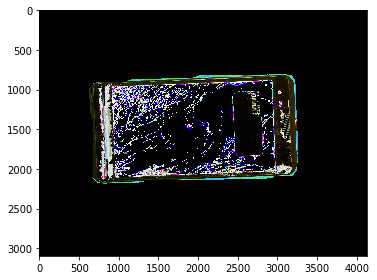

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


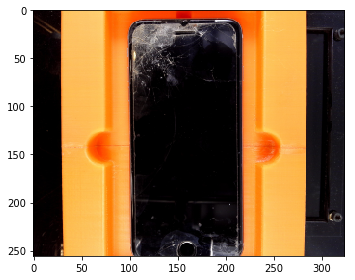

(1, 256, 324, 1)


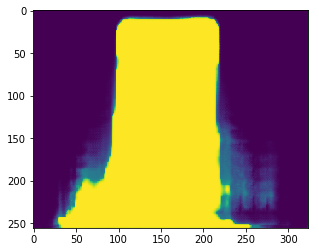

(32957, 3)


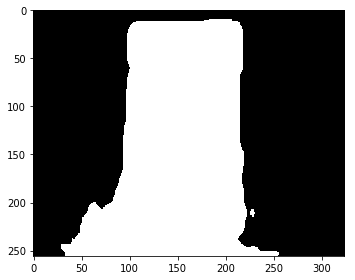

boxShape [[ 369 3094]
 [ 369  108]
 [3247  108]
 [3247 3094]]
box_shape: [[ 369 3094]
 [ 369  108]
 [3247  108]
 [3247 3094]]
(2986, 2878, 3)


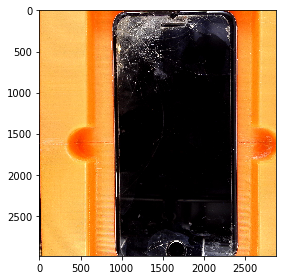

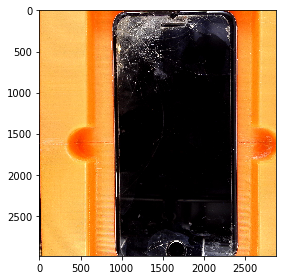

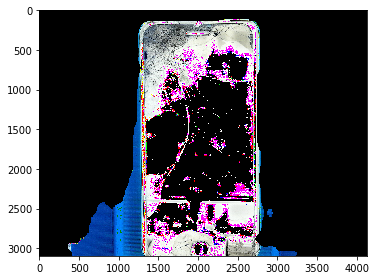

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


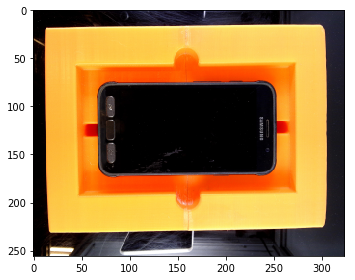

(1, 256, 324, 1)


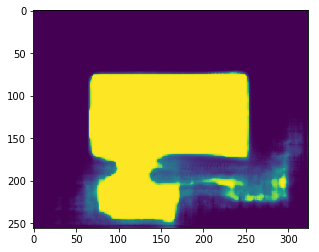

(23243, 3)


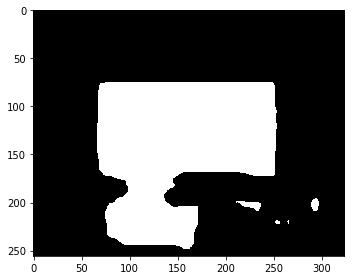

boxShape [[ 840 3010]
 [ 840  907]
 [3222  907]
 [3222 3010]]
box_shape: [[ 840 3010]
 [ 840  907]
 [3222  907]
 [3222 3010]]
(2103, 2382, 3)


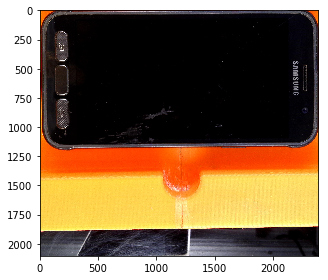

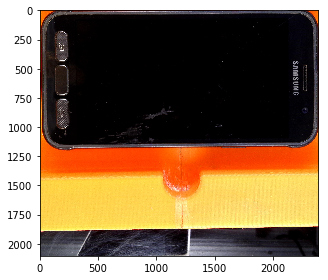

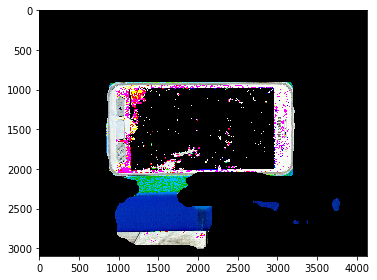

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


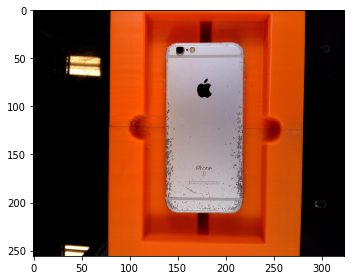

(1, 256, 324, 1)


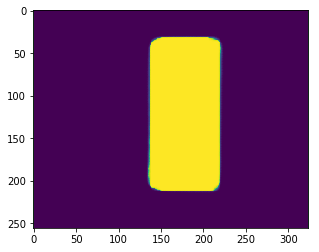

(14605, 3)


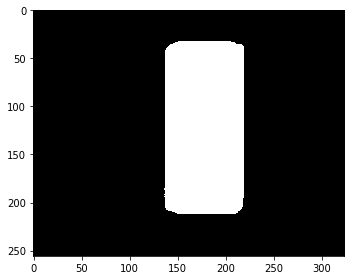

boxShape [[1732 2562]
 [1732  387]
 [2790  387]
 [2790 2562]]
box_shape: [[1732 2562]
 [1732  387]
 [2790  387]
 [2790 2562]]
(2175, 1058, 3)


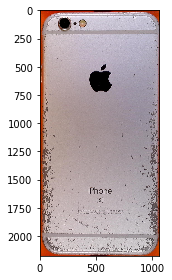

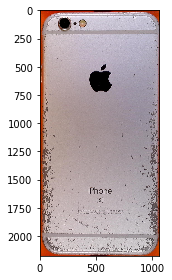

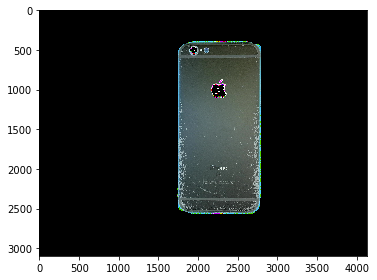

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.015686275
(1, 256, 324, 3)


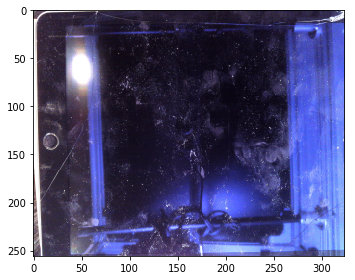

(1, 256, 324, 1)


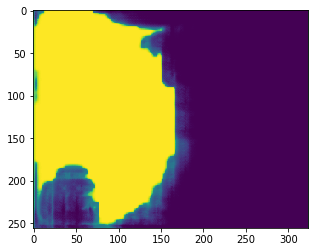

(31097, 3)


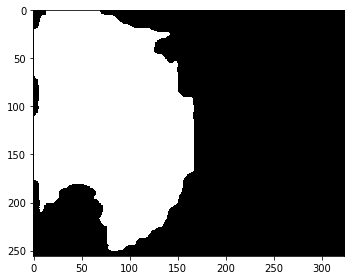

boxShape [[  12 3035]
 [  12    0]
 [2127    0]
 [2127 3035]]
box_shape: [[  12 3035]
 [  12    0]
 [2127    0]
 [2127 3035]]
(3035, 2115, 3)


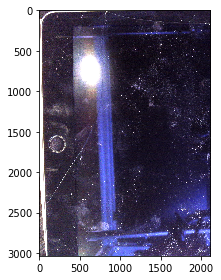

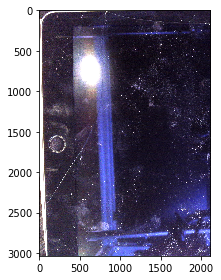

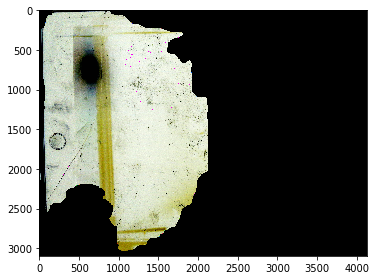

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


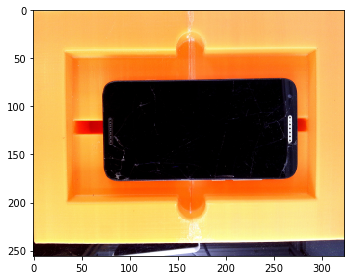

(1, 256, 324, 1)


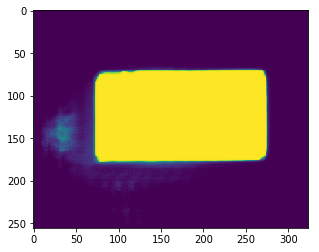

(20929, 3)


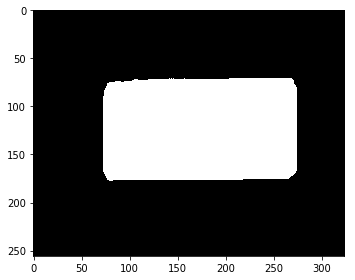

boxShape [[ 930 2152]
 [ 921  864]
 [3489  846]
 [3498 2134]]
box_shape: [[ 930 2152]
 [ 921  864]
 [3489  846]
 [3498 2134]]
(1306, 2577, 3)


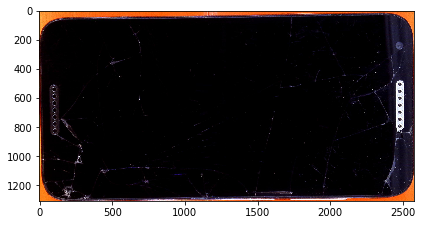

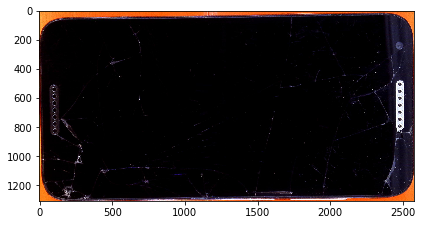

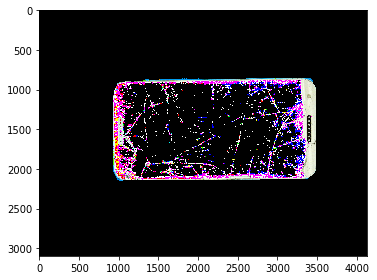

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.10980392
(1, 256, 324, 3)


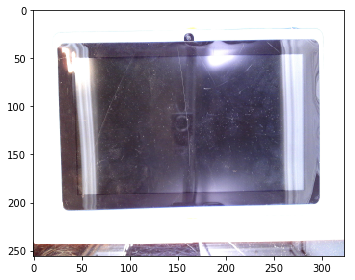

(1, 256, 324, 1)


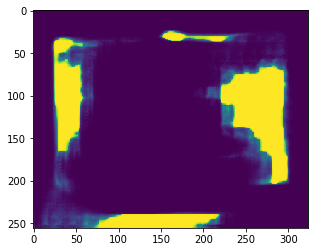

(10787, 3)


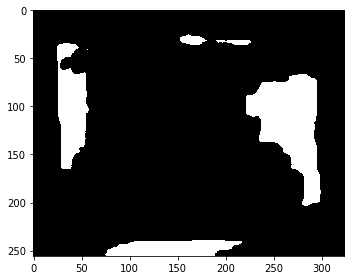

boxShape [[2859 2495]
 [2797  836]
 [3754  800]
 [3816 2460]]
box_shape: [[2859 2495]
 [2797  836]
 [3754  800]
 [3816 2460]]
(1695, 1019, 3)


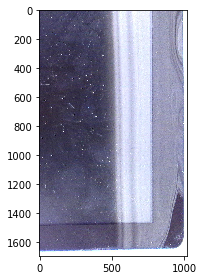

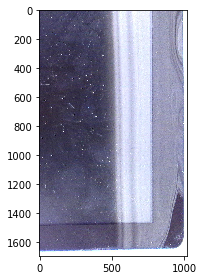

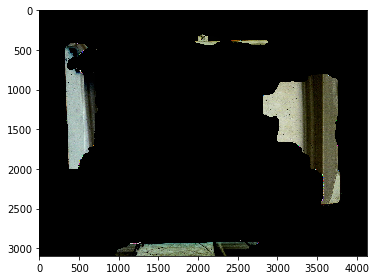

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


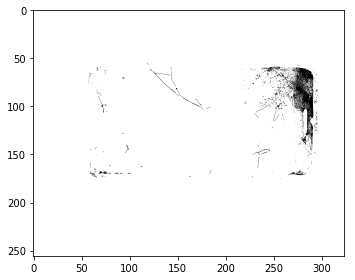

(1, 256, 324, 1)


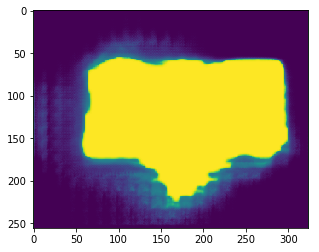

(28955, 3)


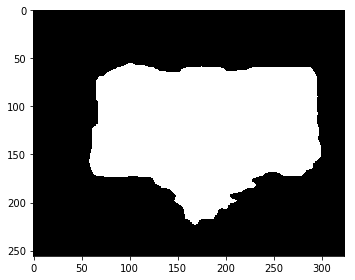

boxShape [[3790 2741]
 [ 721 2679]
 [ 762  653]
 [3832  716]]
box_shape: [[3790 2741]
 [ 721 2679]
 [ 762  653]
 [3832  716]]
(2088, 3111, 3)


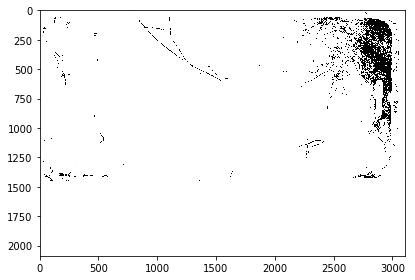

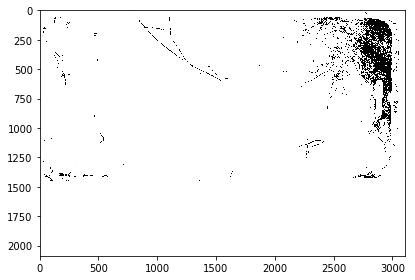

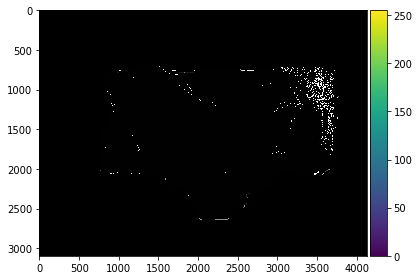

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


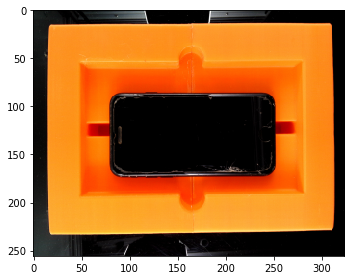

(1, 256, 324, 1)


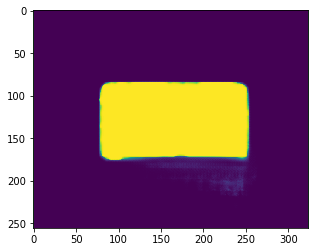

(15001, 3)


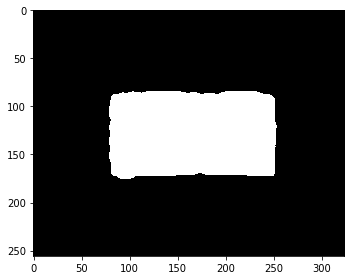

boxShape [[1006 2128]
 [1006 1015]
 [3223 1015]
 [3223 2128]]
box_shape: [[1006 2128]
 [1006 1015]
 [3223 1015]
 [3223 2128]]
(1113, 2217, 3)


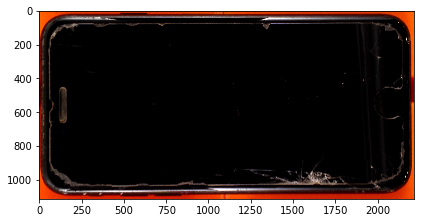

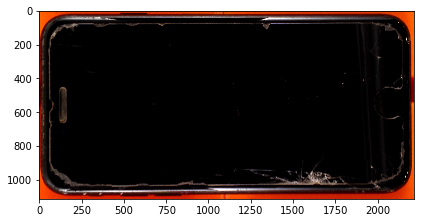

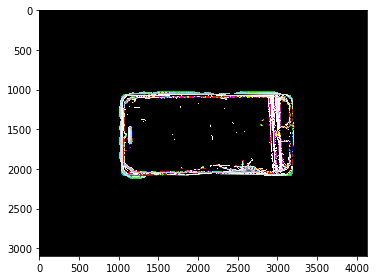

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


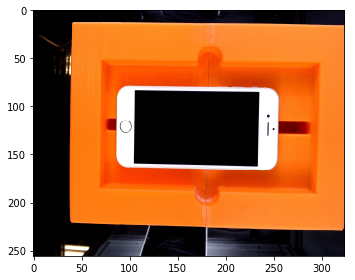

(1, 256, 324, 1)


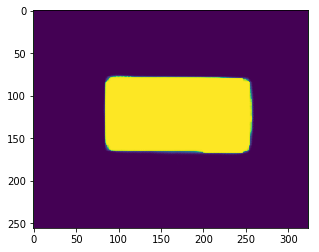

(14656, 3)


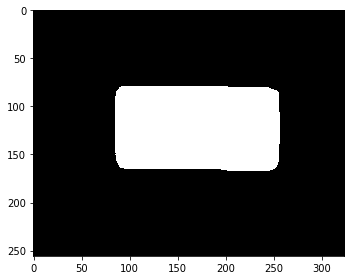

boxShape [[1082 2031]
 [1082  955]
 [3274  955]
 [3274 2031]]
box_shape: [[1082 2031]
 [1082  955]
 [3274  955]
 [3274 2031]]
(1076, 2192, 3)


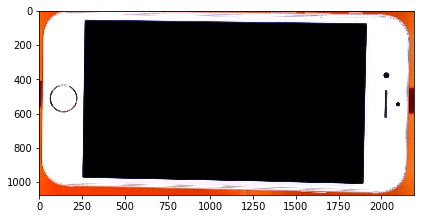

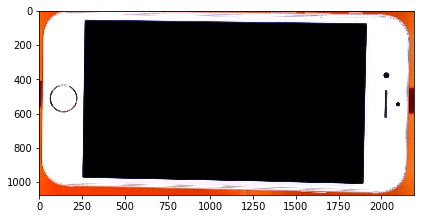

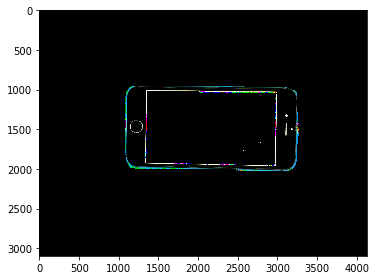

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


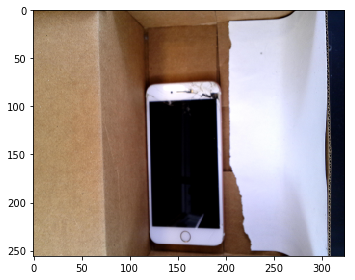

(1, 256, 324, 1)


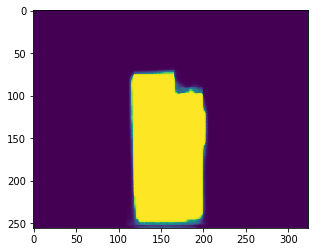

(13452, 3)


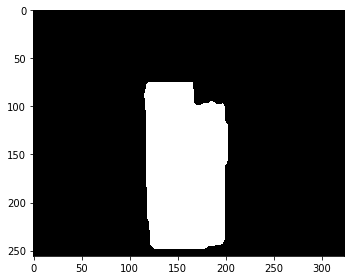

boxShape [[1465 3011]
 [1465  907]
 [2573  907]
 [2573 3011]]
box_shape: [[1465 3011]
 [1465  907]
 [2573  907]
 [2573 3011]]
(2104, 1108, 3)


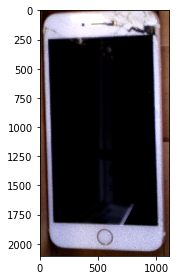

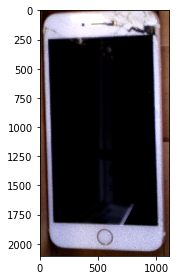

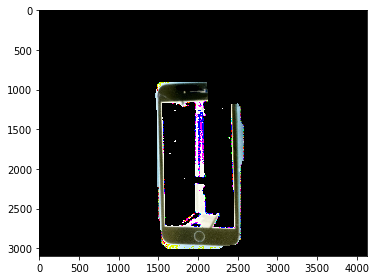

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


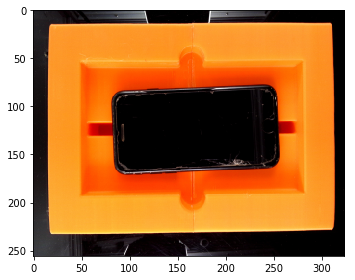

(1, 256, 324, 1)


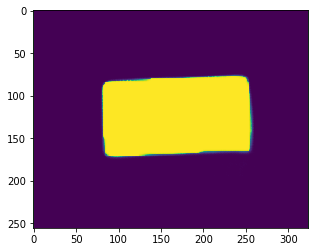

(15047, 3)


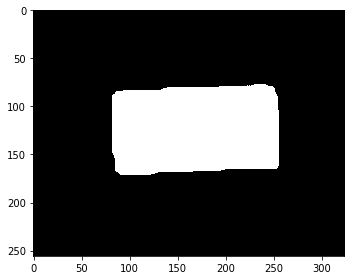

boxShape [[1059 2106]
 [1003 1006]
 [3229  892]
 [3285 1991]]
box_shape: [[1059 2106]
 [1003 1006]
 [3229  892]
 [3285 1991]]
(1214, 2282, 3)


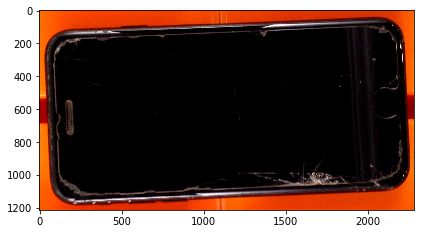

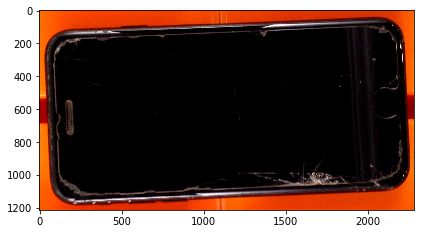

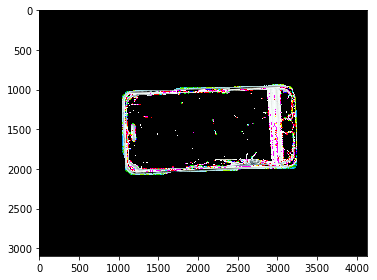

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


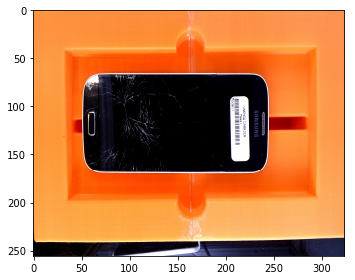

(1, 256, 324, 1)


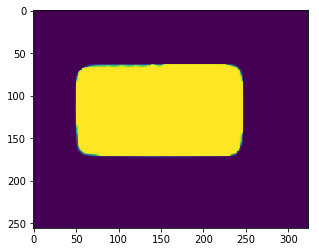

(20363, 3)


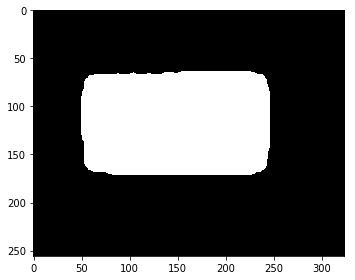

boxShape [[ 637 2079]
 [ 637  774]
 [3133  774]
 [3133 2079]]
box_shape: [[ 637 2079]
 [ 637  774]
 [3133  774]
 [3133 2079]]
(1305, 2496, 3)


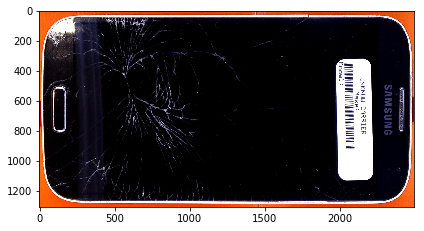

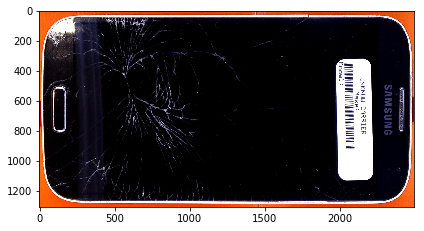

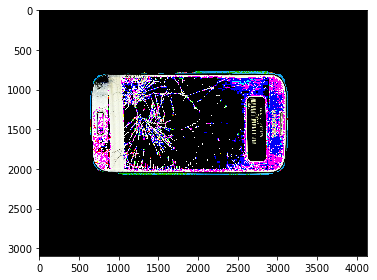

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


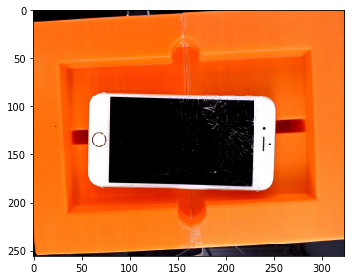

(1, 256, 324, 1)


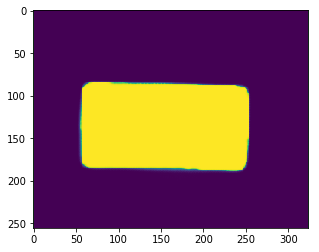

(19236, 3)


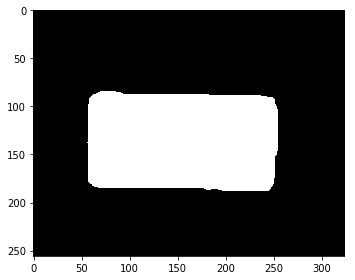

boxShape [[3224 2288]
 [ 700 2233]
 [ 727 1006]
 [3251 1062]]
box_shape: [[3224 2288]
 [ 700 2233]
 [ 727 1006]
 [3251 1062]]
(1282, 2551, 3)


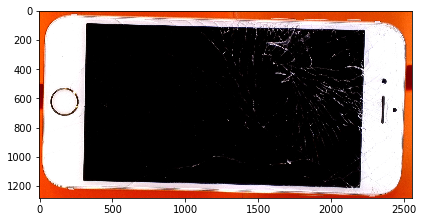

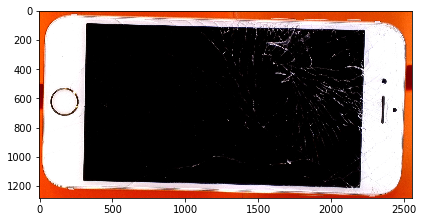

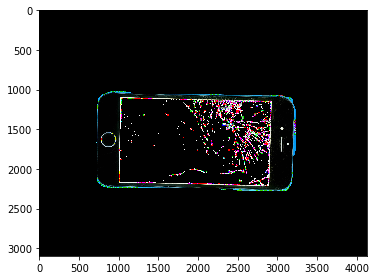

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


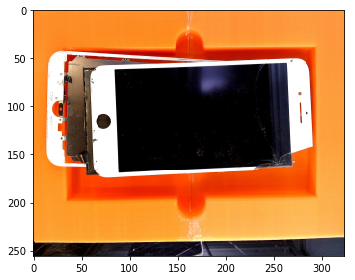

(1, 256, 324, 1)


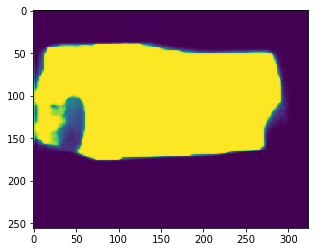

(31714, 3)


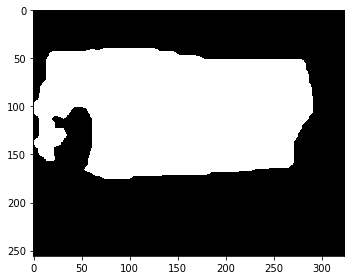

boxShape [[  12 2128]
 [  12  483]
 [3707  483]
 [3707 2128]]
box_shape: [[  12 2128]
 [  12  483]
 [3707  483]
 [3707 2128]]
(1645, 3695, 3)


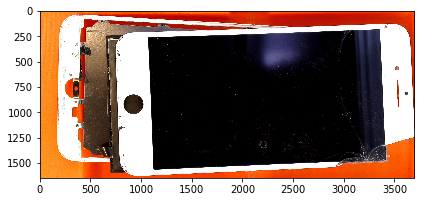

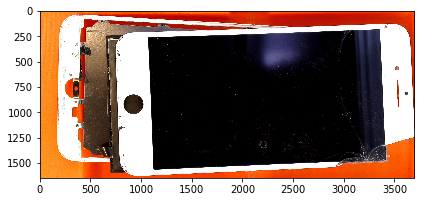

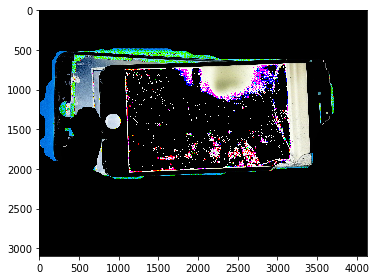

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


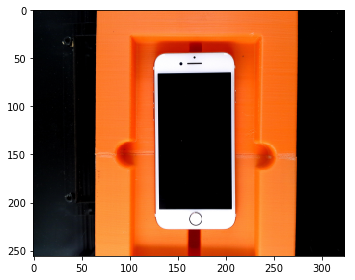

(1, 256, 324, 1)


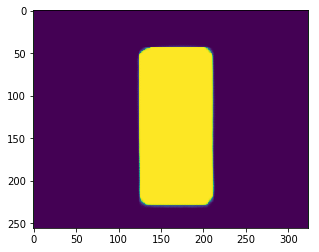

(15599, 3)


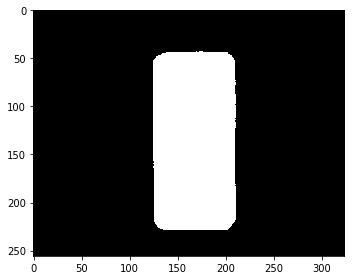

boxShape [[1592 2769]
 [1592  520]
 [2688  520]
 [2688 2769]]
box_shape: [[1592 2769]
 [1592  520]
 [2688  520]
 [2688 2769]]
(2249, 1096, 3)


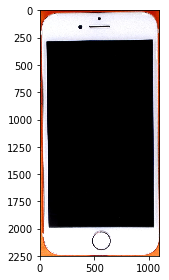

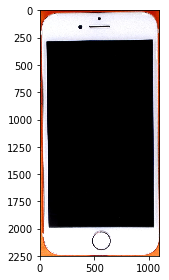

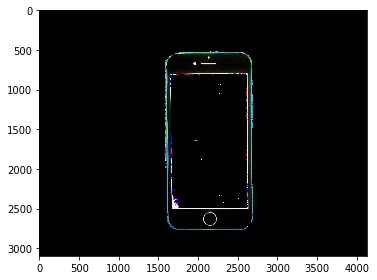

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


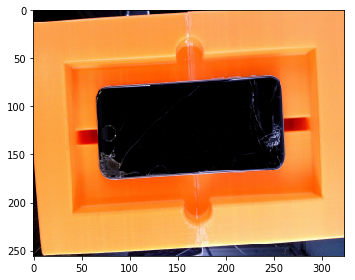

(1, 256, 324, 1)


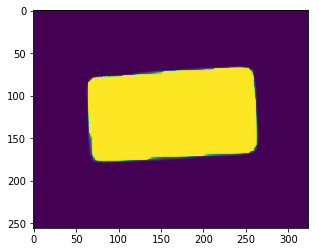

(19315, 3)


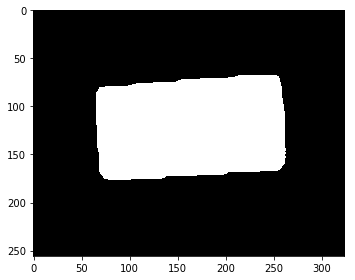

boxShape [[ 868 2185]
 [ 789  944]
 [3307  784]
 [3386 2024]]
box_shape: [[ 868 2185]
 [ 789  944]
 [3307  784]
 [3386 2024]]
(1401, 2597, 3)


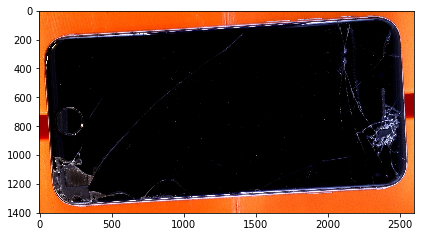

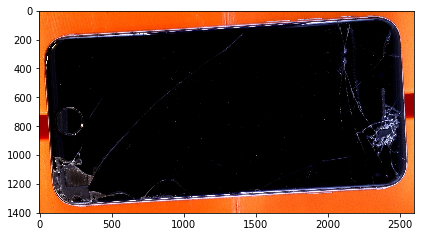

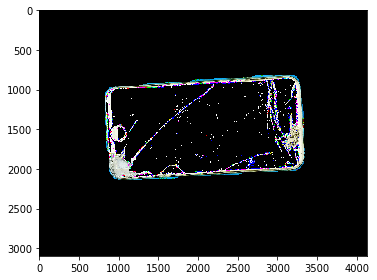

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


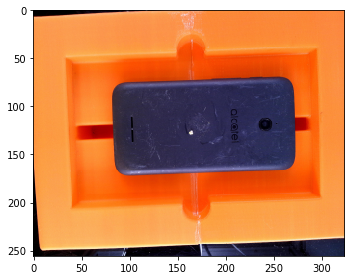

(1, 256, 324, 1)


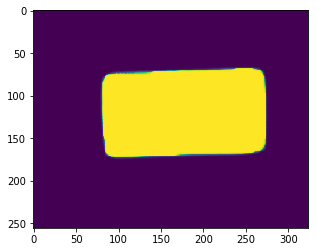

(18582, 3)


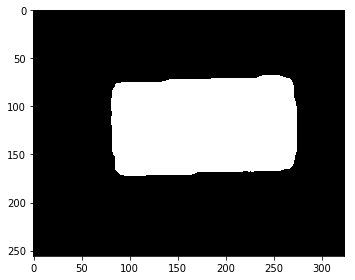

boxShape [[1056 2120]
 [1009  900]
 [3474  804]
 [3521 2024]]
box_shape: [[1056 2120]
 [1009  900]
 [3474  804]
 [3521 2024]]
(1316, 2512, 3)


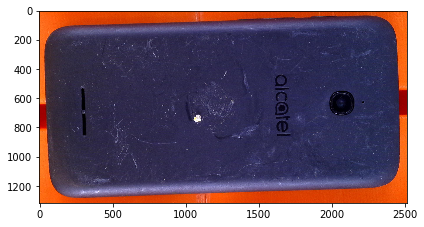

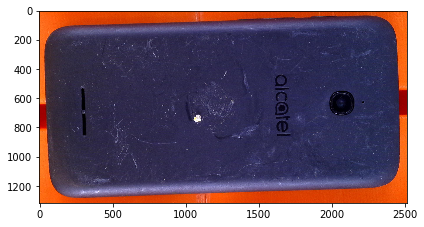

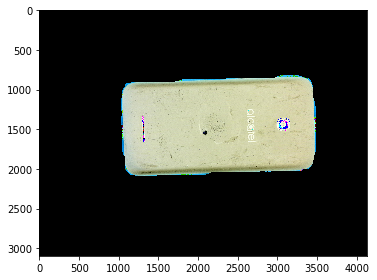

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


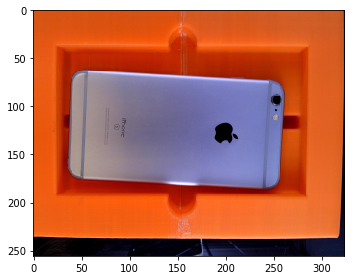

(1, 256, 324, 1)


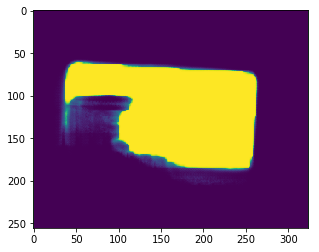

(19292, 3)


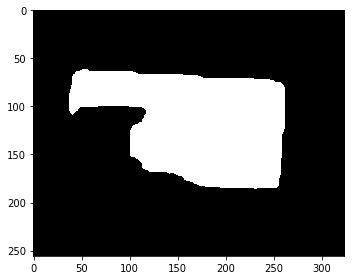

boxShape [[3294 2282]
 [ 411 2123]
 [ 488  723]
 [3372  883]]
box_shape: [[3294 2282]
 [ 411 2123]
 [ 488  723]
 [3372  883]]
(1559, 2961, 3)


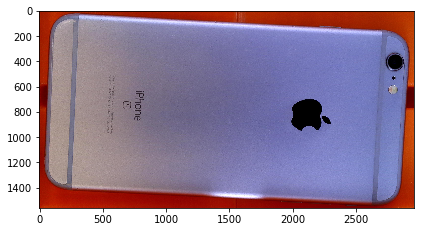

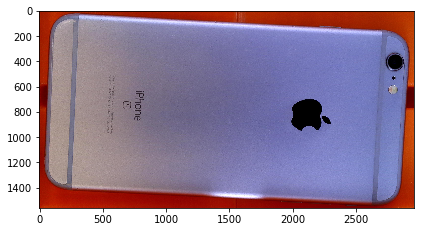

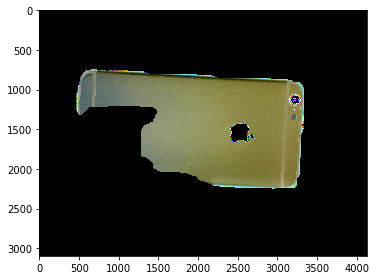

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


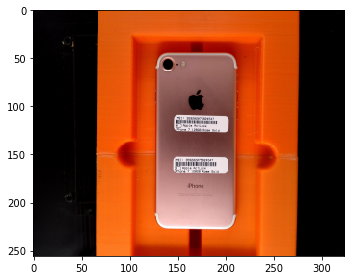

(1, 256, 324, 1)


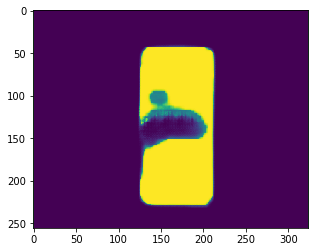

(12255, 3)


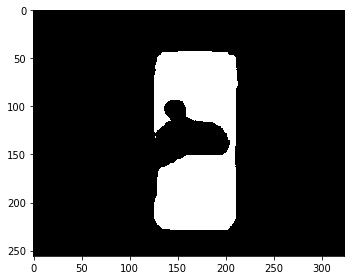

boxShape [[1605 2768]
 [1605  520]
 [2713  520]
 [2713 2768]]
box_shape: [[1605 2768]
 [1605  520]
 [2713  520]
 [2713 2768]]
(2248, 1108, 3)


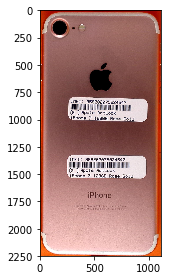

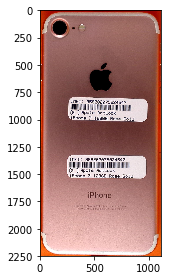

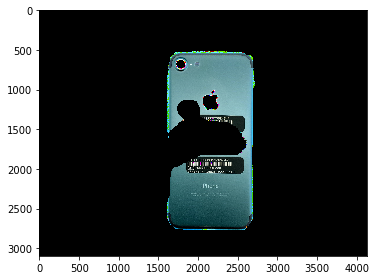

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


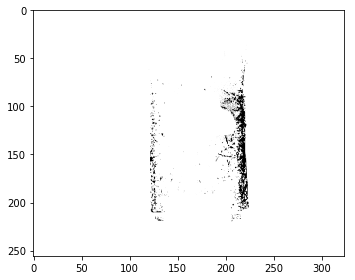

(1, 256, 324, 1)


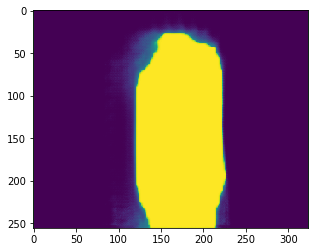

(20864, 3)


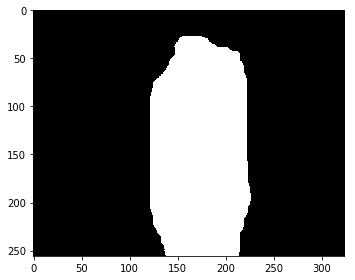

boxShape [[1541 3094]
 [1541  326]
 [2879  326]
 [2879 3094]]
box_shape: [[1541 3094]
 [1541  326]
 [2879  326]
 [2879 3094]]
(2768, 1338, 3)


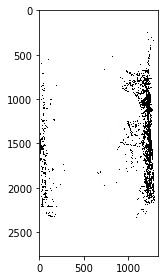

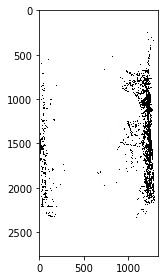

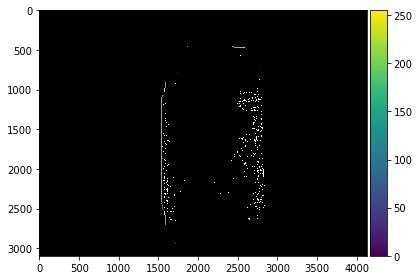

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


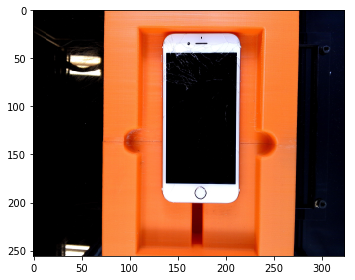

(1, 256, 324, 1)


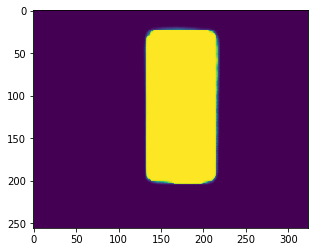

(14570, 3)


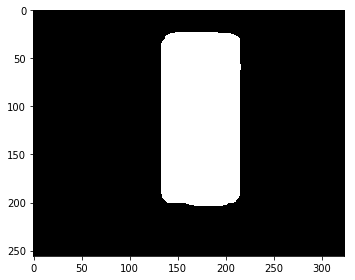

boxShape [[1694 2466]
 [1694  278]
 [2751  278]
 [2751 2466]]
box_shape: [[1694 2466]
 [1694  278]
 [2751  278]
 [2751 2466]]
(2188, 1057, 3)


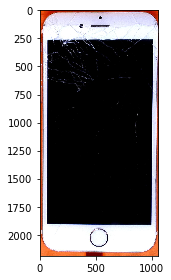

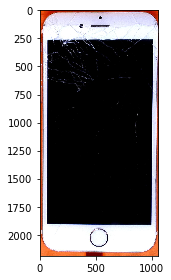

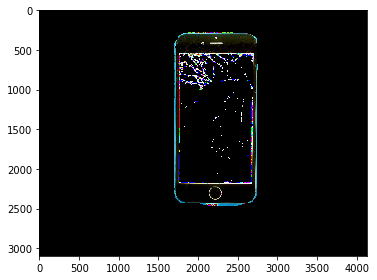

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(3096, 4128, 3)
(256, 324, 3)
(1, 256, 324, 3)
1.0 0.0
(1, 256, 324, 3)


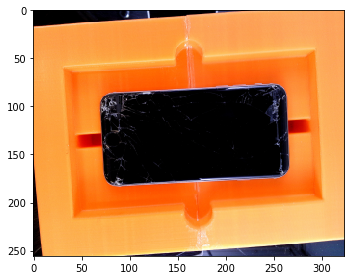

(1, 256, 324, 1)


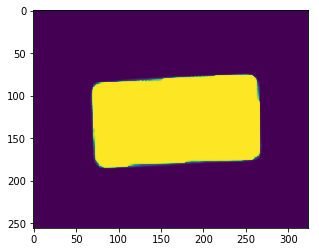

(19161, 3)


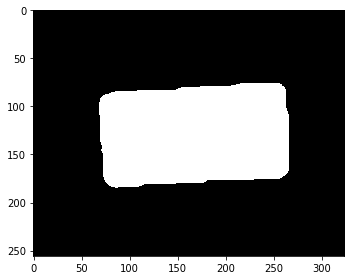

boxShape [[ 921 2249]
 [ 857 1016]
 [3367  886]
 [3431 2119]]
box_shape: [[ 921 2249]
 [ 857 1016]
 [3367  886]
 [3431 2119]]
(1363, 2574, 3)


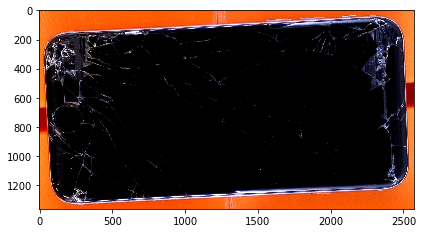

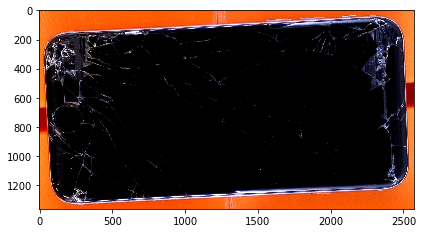

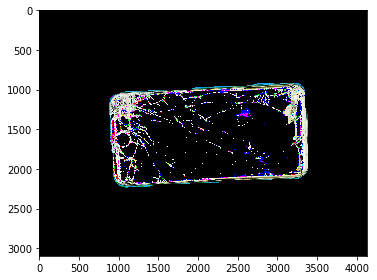

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [16]:
from skimage import io as skio
import matplotlib.pyplot as io
from glob import glob
import cv2
no=0
testPath = glob('/home/ubuntu/DeepMobile/data/scratches/prod_scratches/**.jpg')
def FillImg(binImg,rgbImg):
    _, contours, hierarchy = cv2.findContours(np.uint8(binImg), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    newBinImg = np.zeros((binImg.shape[0],binImg.shape[1]),np.uint8())
    
    areas = [cv2.contourArea(c) for c in contours]
    if(len(areas)>0):
        max_index = np.argmax(areas)
        cnt = contours[max_index]
        cv2.drawContours(np.uint8(newBinImg).copy(), [cnt], 0, 255, -1)
        rect = cv2.minAreaRect(cnt)
     
        angle = rect[-1]
        
            
        box = cv2.boxPoints(rect)
        # self.box = np.int0(cv2.cv.BoxPoints(rect))
        box = np.int0(box)
        print('boxShape',box)
        box[box<0] = 0
        box[box>4128] = 3096
        cv2.drawContours(rgbImg.copy(), [box], 0, (0,255,0), 2)
        print('box_shape:',box)
        croppedRgbImg = rgbImg[int(min(box[:, 1])):int(max(box[:, 1])), int(min(box[:, 0])):int(max(box[:, 0]))]
        if croppedRgbImg.shape[0]>0:
            return newBinImg,croppedRgbImg
        else:
            return newBinImg,np.zeros((256,324,3))
for i in range(len(testPath)):
    #tokens = testPath[i].split('/)
    #name = tokens[6].split('.')[0]
    img = skio.imread(testPath[i])
    #imgOriginal = cv2.resize(img,dsize=(4128,3096),interpolation=cv2.INTER_AREA)
    print(img.shape)
    if img.shape[0]>img.shape[1]:
        img = img.transpose([1,0,2])
    imgOriginal = img
    
    #img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
    
    img = cv2.resize(img,dsize=(324,256),interpolation=cv2.INTER_AREA)
    imgss = img
    img = np.asarray(img).astype('float32')
    print(img.shape)
    
    
    #label = cv.resize(label,dsize=(324,256))

    #label = label.astype('uint8')
    img = img.reshape(1,256,324,3)

    print(img.shape)

    img = img/255.
    print(np.max(img),np.min(img))
    #label = label.reshape(256,324,1)
    print(img.shape)
    skio.imshow(img[0])
    skio.show()
    #img = (img-np.mean(img))/np.std(img)
    predicted = model1.predict(img)
    print(predicted.shape)
    io.imshow(predicted[0,:,:,0])
    io.show()
    thresh = np.argwhere(predicted[:,:,:,0]>0.87)
    imgs = np.zeros((256,324)).astype('uint8')
    print(thresh.shape)
    for j in range(thresh.shape[0]):
        imgs[thresh[j][1],thresh[j][2]]=255

    #imgs = imgs.reshape(128,164)
    skio.imshow(imgs)
    skio.show()
    imgs = cv2.resize(imgs,(4128,3096),interpolation=cv2.INTER_AREA)
    #cv2.imwrite('/home/ubuntu/DeepMobile/data/outputData/segmented/labels/{}.png'.format(int(no)),imgs)
    imgBin,imgRgb = FillImg(binImg=np.uint8(imgs),rgbImg=np.uint8(imgOriginal))
    print(imgRgb.shape)
    skio.imshow(imgRgb)
    skio.show()
    skio.imshow(imgRgb)
    skio.show()
    skio.imshow(imgs.reshape(3096,4128,1)*imgOriginal)
    skio.show()
    #io.imsave('/home/ubuntu/DeepMobile/data/outputData/original/train/{}.png'.format(int(no)),imgOriginal)
    io.imsave('/home/ubuntu/DeepMobile/data/scratches/{}.png'.format(int(no)),imgRgb)
    #cv2.imwrite('/home/ubuntu/DeepMobile/data/outputData/segmented/{}.png'.format(int(no)),imgBin)
    print(imgs)

    no+=1

In [ ]:
import cv2
cv2.namedWindow("preview")
vc = cv2.VideoCapture(0)

if vc.isOpened(): # try to get the first frame
    rval, frame = vc.read()
else:
    rval = False

while rval:
    
    rval, frame = vc.read()
    key = cv2.waitKey(20)
    if key == 27: # exit on ESC
        break
    #img = np.asarray(img).astype('float32')
    img = cv2.resize(frame,dsize=(324,256),interpolation=cv2.INTER_AREA)

    #label = cv.resize(label,dsize=(324,256))

    #label = label.astype('uint8')
    imgss = img
    img = img.reshape(1,256,324,3)
    
    img = img/255.
    #label = label.reshape(512,648,1)

    
    #img = (img-np.mean(img))/np.std(img)
    predicted = model1.predict(img)
 
    
    thresh = np.argwhere(predicted[:,:,:,0]>0.9)
    imgs = np.zeros((256,324,1)).astype('uint8')
   
    for i in range(thresh.shape[0]):
        imgs[thresh[i][1],thresh[i][2],0]=255
    #imgBin,imgRgb = FillImg(binImg=np.uint8(imgs),rgbImg=np.uint8(imgss))
    cv2.imshow("preview", imgs)

cv2.destroyWindow("preview")
    

In [ ]:
model.save_weights('VGG1.h5')

In [ ]:
data_gen_args = dict(height_shift_range=0.1,width_shift_range=0.1,fill_mode='nearest',horizontal_flip=True,vertical_flip=True,
                     rotation_range=90.,
                     )
image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Provide the same seed and keyword arguments to the fit and flow methods
seed = 1


# combine generators into one which yields image and masks
train_generator = zip(image_datagen.flow(x=x[:100],batch_size=1,seed=10), mask_datagen.flow(x=y[:100],batch_size=1,seed=10))
valid_generator = zip(image_datagen.flow(x=x[100:],batch_size=1,seed=10), mask_datagen.flow(x=y[100:],batch_size=1,seed=10))
'''model1.fit_generator(callbacks=[checkpoint],validation_data=valid_generator,validation_steps=90,
    generator=train_generator,
    steps_per_epoch=100,
    epochs=100)'''

In [ ]:
model.save_weights('/home/ubuntu/DeepMobile/models/myown/VGGNEWNEW.h5')

In [ ]:
model.save(filepath='/home/ubuntu/DeepMobile/models/fcn/VGGPredict')

In [ ]:
no

In [ ]:
hist = model1.evaluate(batch_size=1,x=trains,y=labelss,verbose=1)

In [ ]:
hist[2]

In [ ]:
labelss = labelss.reshape(1314,1,256,256)

In [ ]:
io.imshow(trains[0])

In [ ]:
from skimage import io

In [ ]:
model1.save('/home/ubuntu/DeepMobile/models/fully_trained_models/VGG_MUE')

In [ ]:
json_string = model1.to_json()

In [ ]:
json_string

In [ ]:
model_json = model1.to_json()
with open("/home/ubuntu/DeepMobile/models/production_models/VGG_MUE_Production.json", "w") as json_file:
    json_file.write(model_json)

In [ ]:
model1.save_weights('/home/ubuntu/DeepMobile/models/production_models/VGG_MUE_Production.h5')

In [ ]:
json_string = json.encoder(json_string)

In [ ]:
import json

In [1]:
model.evaluate()

NameError: name 'model' is not defined

In [7]:
import numpy as np
import tensorflow as tf
import keras as k

from keras.applications.resnet50 import ResNet50

from keras import backend as K
from keras.layers.core import Flatten, Dense, Dropout, Lambda
from keras.models import Model
from keras.preprocessing import image
from keras.optimizers import SGD, RMSprop, Adam, Nadam

gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=0.8, allow_growth=False)
sess = tf.Session(config=tf.ConfigProto(gpu_options=gpu_options))

# Missing this was the source of one of the most challenging an insidious bugs that I've ever encountered.  
# Without explicitly linking the session the weights for the dense layer added below don't get loaded
# and so the model returns random results which vary with each model you upload because of random seeds.
K.set_session(sess)

# Use this only for export of the model.  
# This must come before the instantiation of ResNet50
K._LEARNING_PHASE = tf.constant(0)
K.set_learning_phase(0)

# Transfer learning from ResNet50
Resnet50model = ResNet50(include_top=True, weights='imagenet', input_tensor=None, input_shape=None)

# Pop off the last layer


# Training Not included; We're going to load pretrained weights
Resnet50model.load_weights('/home/ubuntu/.keras/models/resnet50_weights_tf_dim_ordering_tf_kernels.h5')

# Import the libraries needed for saving models
# Note that in some other tutorials these are framed as coming from tensorflow_serving_api which is no longer correct
from tensorflow.python.saved_model import builder as saved_model_builder
from tensorflow.python.saved_model import tag_constants, signature_constants, signature_def_utils_impl

# I want the full prediction tensor out, not classification. This format: {"image": Resnet50model.input} took me a while to track down
prediction_signature = tf.saved_model.signature_def_utils.predict_signature_def({"image": Resnet50model.input}, {"prediction":Resnet50model.output})

# export_path is a directory in which the model will be created
builder = saved_model_builder.SavedModelBuilder('export_path')
legacy_init_op = tf.group(tf.tables_initializer(), name='legacy_init_op')

# Initialize global variables and the model
init_op = tf.group(tf.global_variables_initializer(), tf.local_variables_initializer())
sess.run(init_op)

# Add the meta_graph and the variables to the builder
builder.add_meta_graph_and_variables(
      sess, [tag_constants.SERVING],
      signature_def_map={
           signature_constants.DEFAULT_SERVING_SIGNATURE_DEF_KEY:
               prediction_signature,
      },
      legacy_init_op=legacy_init_op)
# save the graph      
builder.save()  

INFO:tensorflow:No assets to save.
INFO:tensorflow:No assets to write.
INFO:tensorflow:SavedModel written to: b'export_path/saved_model.pb'


b'export_path/saved_model.pb'